Copyright 2025 Joe Worsham

In [1]:
# obligatory reload content dynamically
%load_ext autoreload
%autoreload 2

In [2]:
from example_systems.pendulum.pendulum_system import PendulumSystem

In [3]:
import tensorflow_dynamics as tfd

In [ ]:
import math
import numpy as np
import random
import tensorflow as tf

In [5]:
from matplotlib import pyplot as plt

# Render Flow Field

In [ ]:
system = PendulumSystem()

In [38]:
theta = np.linspace(-np.pi, np.pi, 20)
omega = np.linspace(-4*np.pi, 4*np.pi, 20)
X, Y = np.meshgrid(theta, omega)
coords = tf.concat([tf.stack([[X[x, y], Y[x, y]] for y in range(20)], axis=0) for x in range(20)], axis=0)
coords = tf.cast(coords, tf.float64)
coords.shape

TensorShape([400, 2])

In [226]:
p = tf.tile(tf.constant([9.81, 0.01, 0.4, 0.5, 0.03], dtype=tf.float64)[None, :], (coords.shape[0], 1))
p.shape

TensorShape([400, 5])

In [227]:
ode_model = lambda t, x: system(x, None, p, t)

In [41]:
dx_dt = ode_model(None, coords)
dx_dt.shape

TensorShape([400, 2])

In [62]:
t_0 = tf.zeros([1,], dtype=tf.float64)
t_f = tf.ones([1,], dtype=tf.float64) * 2.
dt = tf.ones([1,], dtype=tf.float64) / 32.
time_range = tf.linspace(t_0, t_f, 65)
tfd_time_range = tf.transpose(time_range, [1, 0])
x_0 = tf.constant([-2, 5], dtype=tf.float64)[None, :]
ode_model_1 = lambda t, x: system(x, None, p[:1, :], t)
xt_rk4, tt_rk4 = tfd.de.odeint(ode_model_1, x_0, tfd_time_range, method='dopri5', rtol=1e-6, atol=1e-9)

In [63]:
xt_rk4.shape

TensorShape([1, 65, 2])

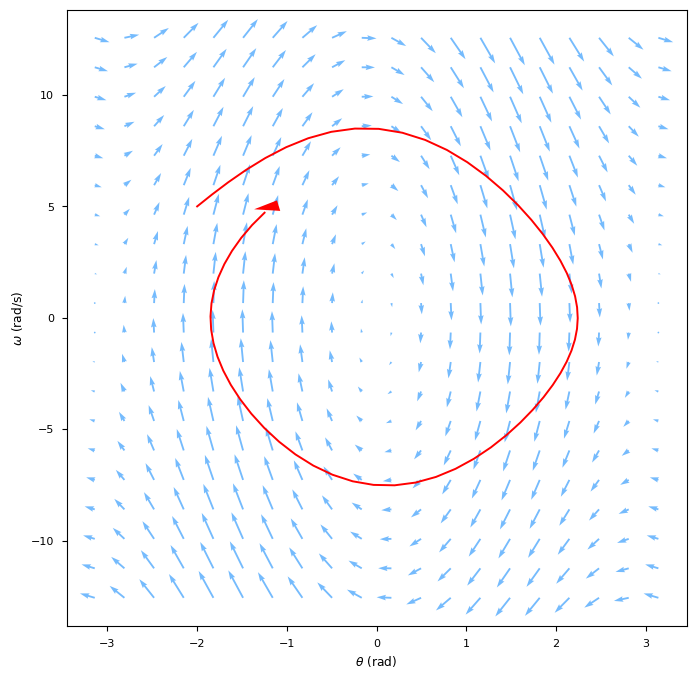

In [64]:
plt.figure(figsize=(8, 8))
plt.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
plt.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'r-')
plt.arrow(xt_rk4[0, -1, 0], xt_rk4[0, -1, 1],
          xt_rk4[0, -1, 0] - xt_rk4[0, -2, 0],
          xt_rk4[0, -1, 1] - xt_rk4[0, -2, 1],
          shape='full', lw=0, length_includes_head=True,
          head_width=0.3, color="red")
plt.xlabel(r"$\theta$ (rad)")
plt.ylabel(r"$\omega$ (rad/s)")
plt.show()

# Learn Flow Field

In [411]:
def create_new_model(initializer=None, layers=None, activation='tanh'):
    if layers is None:
        layers = [10,]
    dense_layers = [tf.keras.layers.Dense(l, activation=activation, dtype=tf.float64,
                                          kernel_initializer=initializer) for l in layers]
    dense_layers += [tf.keras.layers.Dense(2, dtype=tf.float64, kernel_initializer=initializer),]
    return tf.keras.Sequential(dense_layers)

## Terminal Loss Only

In [108]:
learning_ode_model = create_new_model()
learning_ode_func = lambda t, x: learning_ode_model(x)
learning_solver = tfd.de.OdeintSolver(learning_ode_func, method='dopri5',
                                      options=dict(rtol=1e-6, atol=1e-9),
                                      adjoint_options=dict(rtol=1e-3, atol=1e-6))

In [109]:
# touch once
learning_ode_model(x_0).shape

TensorShape([1, 2])

0: [1.26601645]
1: [0.99186726]
2: [0.8020956]
3: [0.58878991]
4: [0.35341261]
5: [0.17457498]
6: [0.0989047]
7: [0.2000789]
8: [0.30107606]
9: [0.34346334]
10: [0.33673127]
11: [0.29725388]
12: [0.24200328]
13: [0.18324799]
14: [0.11509969]
15: [0.02838627]
16: [0.12385898]
17: [0.18964246]
18: [0.20111015]
19: [0.17764923]


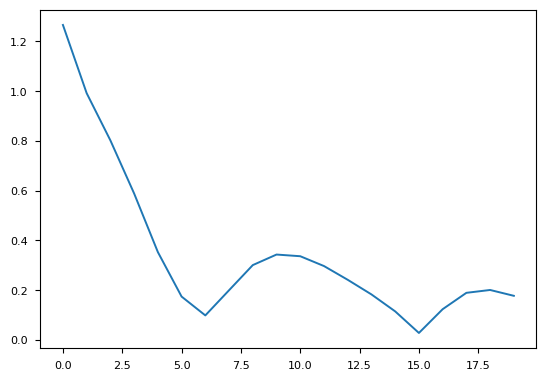

In [ ]:
#optimizer = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
losses = []
for epoch in range(20):
    with tf.GradientTape() as tape:
        xt_hat, *_ = learning_solver.odeint_adjoint(x_0, tfd_time_range)
        err = tf.linalg.norm(xt_hat[..., -1, :] - xt_rk4[..., -1, :], axis=-1)
    grads = tape.gradient(err, learning_ode_model.trainable_variables)
    optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
    losses.append(err)
    print(f"{epoch}: {err}")
plt.plot(losses)

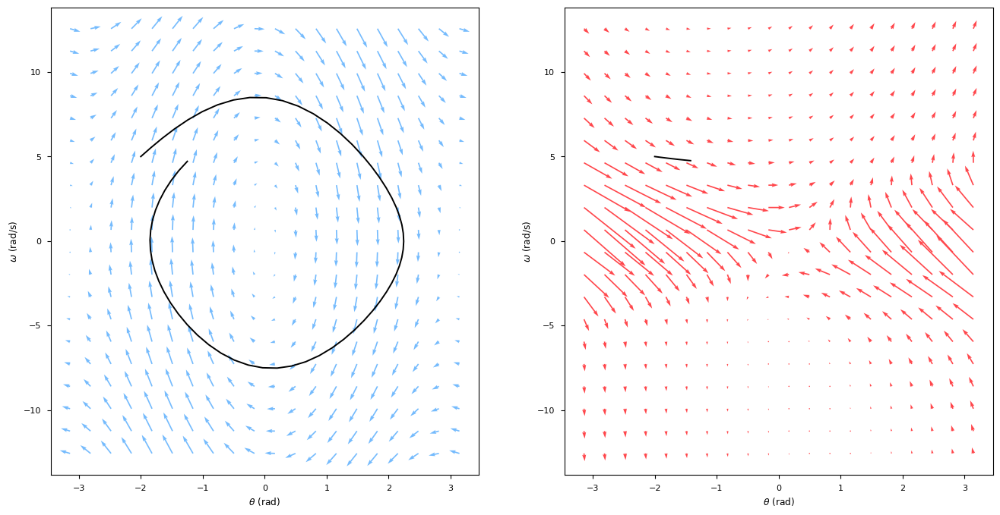

In [111]:
pred_dx_dt = learning_ode_model(coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-')
pred_ax.quiver(coords[:, 0], coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-')
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
plt.show()

## Learning Full Trajectory

In [151]:
learning_ode_model = create_new_model()
learning_ode_func = lambda t, x: learning_ode_model(x)
learning_solver = tfd.de.OdeintSolver(learning_ode_func, method='dopri5',
                                      options=dict(rtol=1e-6, atol=1e-9),
                                      adjoint_options=dict(rtol=1e-3, atol=1e-6))

In [152]:
# touch once
learning_ode_model(x_0).shape

TensorShape([1, 2])

0: 6.693728200370549
1: 6.561852621419457
2: 6.427354000942752
3: 6.287735477901881
4: 6.147677019681715
5: 6.031274007116627
6: 5.982738329107513
7: 5.971735230313621
8: 5.982042402878237
9: 6.0055459183591156
10: 6.03830578387627
11: 6.078266581166047
12: 6.123610682215327
13: 6.16646771080314
14: 6.190490573513813
15: 6.199043485828247
16: 6.194792722544734
17: 6.180183472854981
18: 6.157722667984408
19: 6.130404939195072


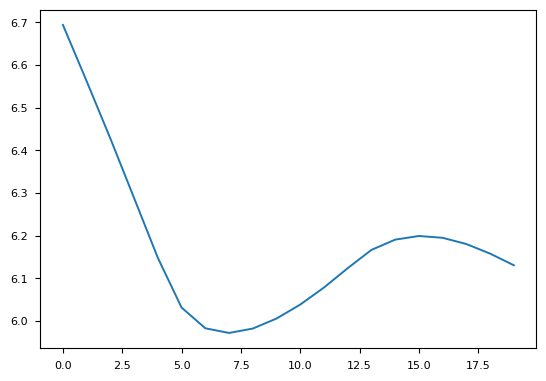

In [ ]:
#optimizer = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
losses = []
for epoch in range(20):
    with tf.GradientTape() as tape:
        xt_hat, *_ = learning_solver.odeint_adjoint(x_0, tfd_time_range)
        err = tf.reduce_mean(tf.linalg.norm(xt_hat - xt_rk4, axis=-1))
    grads = tape.gradient(err, learning_ode_model.trainable_variables)
    optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
    losses.append(err)
    print(f"{epoch}: {err}")
plt.plot(losses)

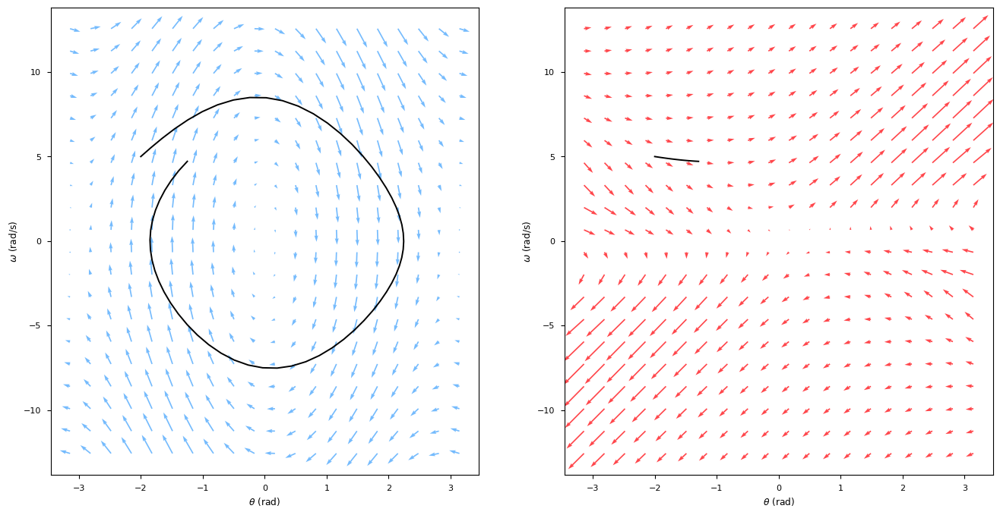

In [154]:
pred_dx_dt = learning_ode_model(coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-')
pred_ax.quiver(coords[:, 0], coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-')
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
plt.show()

## Learning Batched Knot Points

In [136]:
learning_ode_model = create_new_model()
learning_ode_func = lambda t, x: learning_ode_model(x)
learning_solver = tfd.de.OdeintSolver(learning_ode_func, method='dopri5',
                                      options=dict(rtol=1e-6, atol=1e-9),
                                      adjoint_options=dict(rtol=1e-3, atol=1e-6))

In [137]:
# touch once
learning_ode_model(x_0).shape

TensorShape([1, 2])

In [138]:
batch_x = tf.stack([xt_rk4[0, :-1, :], xt_rk4[0, 1:, :]], axis=1)
batch_x.shape

TensorShape([64, 2, 2])

In [139]:
tfd_time_range.shape

TensorShape([1, 65])

In [140]:
batch_time = tfd_time_range[:, :2]
batch_time

<tf.Tensor: shape=(1, 2), dtype=float64, numpy=array([[0.     , 0.03125]])>

0: 0.5133473215918981
1: 0.4818744453698276
2: 0.44589043061138345
3: 0.41304670862722354
4: 0.37909840053802113
5: 0.3452199400898514
6: 0.31543534246996474
7: 0.28648179532297935
8: 0.2580333436864664
9: 0.2270544095321197
10: 0.19574895337430215
11: 0.16712244795913125
12: 0.14413589684475603
13: 0.125800822706909
14: 0.11010684061572099
15: 0.09628335246638012
16: 0.08473995684620284
17: 0.077038139405242
18: 0.07150156300558724
19: 0.06713283946564355


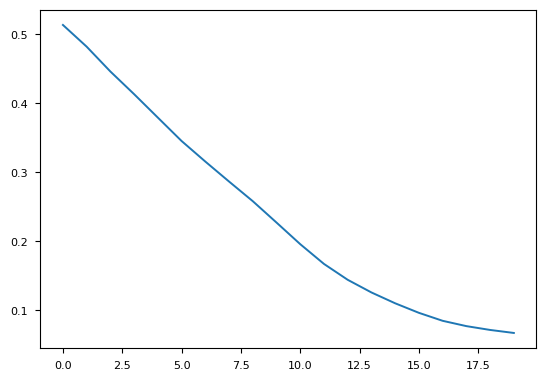

In [ ]:
#optimizer = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-1)
losses = []
for epoch in range(20):
    with tf.GradientTape() as tape:
        xt_hat, *_ = learning_solver.odeint_adjoint(batch_x[..., 0, :], batch_time)
        err = tf.reduce_mean(tf.linalg.norm(xt_hat[..., -1, :] - batch_x[..., -1, :], axis=-1))
    grads = tape.gradient(err, learning_ode_model.trainable_variables)
    optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
    losses.append(err)
    print(f"{epoch}: {err}")
plt.plot(losses)

In [142]:
xt_hat, *_ = learning_solver.odeint_adjoint(x_0, tfd_time_range)

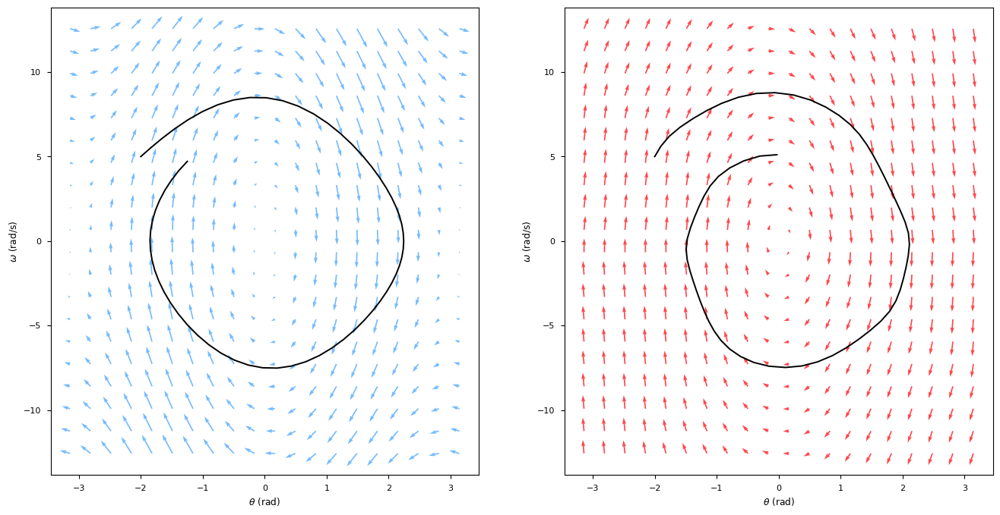

In [143]:
pred_dx_dt = learning_ode_model(coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-')
pred_ax.quiver(coords[:, 0], coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-')
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
plt.show()

## Batched Points then Trajectory Smoothing

In [177]:
learning_ode_model = create_new_model()
learning_ode_func = lambda t, x: learning_ode_model(x)
learning_solver = tfd.de.OdeintSolver(learning_ode_func, method='dopri5',
                                      options=dict(rtol=1e-3, atol=1e-3),
                                      adjoint_options=dict(rtol=1e-3, atol=1e-3))

In [178]:
# touch once
learning_ode_model(x_0).shape

TensorShape([1, 2])

0: 0.5477735315163503
1: 0.4818439382064552
2: 0.44442514715825854
3: 0.38144997557876775
4: 0.3211630692494415
5: 0.26166019158809883
6: 0.18725057222531358
7: 0.13057432025652496
8: 0.12860750857033038
9: 0.11836691382396455
10: 0.1346095951488972
11: 0.13606581883614682
12: 0.11849464670214271
13: 0.10142512806355963
14: 0.08856000919818027
15: 0.08418613214533682
16: 0.08475771215092481
17: 0.07760487682521047
18: 0.06800997907028743
19: 0.06670565072922247


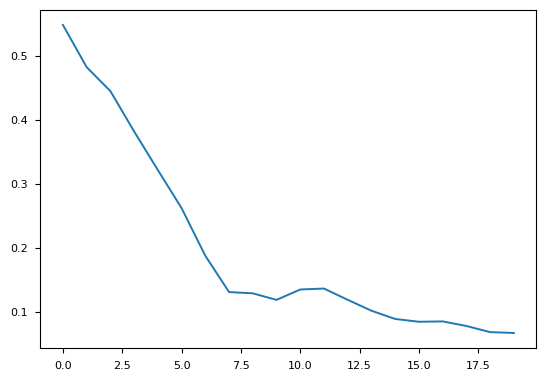

In [ ]:
#optimizer = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
optimizer = tf.keras.optimizers.Adam(learning_rate=5e-1)
losses = []
for epoch in range(20):
    with tf.GradientTape() as tape:
        xt_hat, *_ = learning_solver.odeint_adjoint(batch_x[..., 0, :], batch_time)
        err = tf.reduce_mean(tf.linalg.norm(xt_hat[..., -1, :] - batch_x[..., -1, :], axis=-1))
    grads = tape.gradient(err, learning_ode_model.trainable_variables)
    optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
    losses.append(err)
    print(f"{epoch}: {err}")
plt.plot(losses)

In [180]:
xt_hat, *_ = learning_solver.odeint_adjoint(x_0, tfd_time_range)

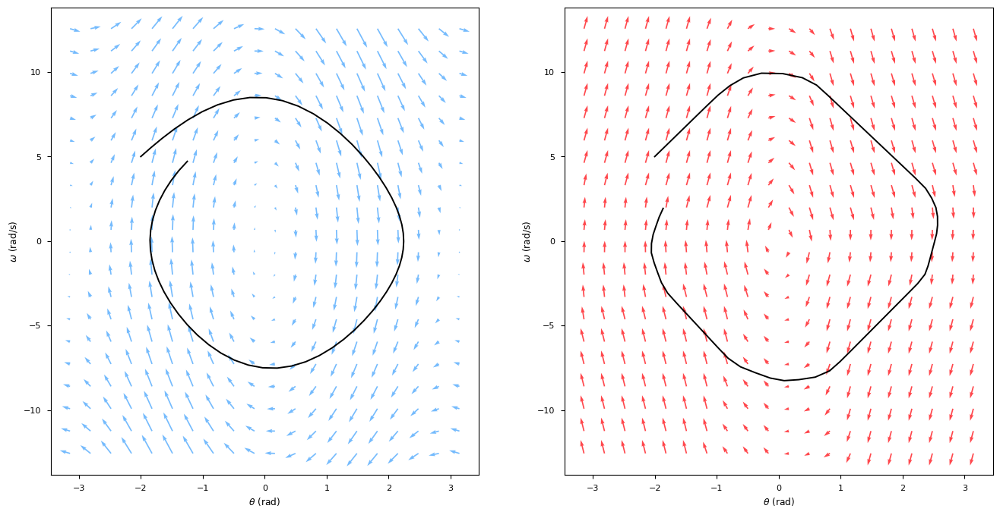

In [181]:
pred_dx_dt = learning_ode_model(coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-')
pred_ax.quiver(coords[:, 0], coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-')
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
plt.show()

0: 1.7004291452577736
1: 1.154096479112105
2: 0.6858639087935195
ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.ops.tensor_array_ops.TensorArray'>):
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
  File "c:\users\joewo\workspaces\tensorflow_dynamics\tensorflow_dynamics\de\solvers.py", line 52, in <genexpr>
    ys = tuple(ys_n.write(0, y_0n) for ys_n, y_0n in zip(ys, y_0))  File "C:\Users\joewo\python_envs\tfd\lib\site-packages\tensorflow\python\util\tf_should_use.py", line 243, in wrapped
    return _add_should_use_warning(fn(*args, **kwargs),
ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.ops.tensor_array_ops.TensorArray'>):
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
  File "c:\users\joewo\workspaces\tensorflow_dynamics\tensorflow_dynamics\de\solvers.py", line 52, in <gene

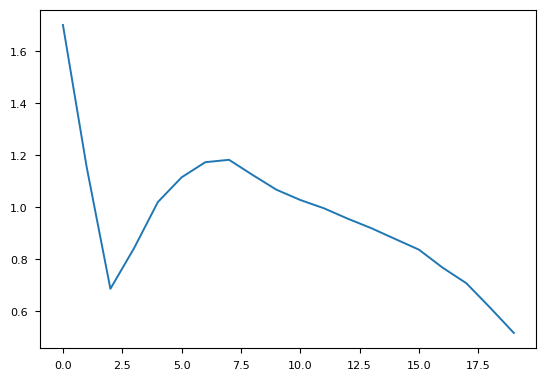

In [ ]:
#optimizer = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
losses = []
for epoch in range(20):
    with tf.GradientTape() as tape:
        xt_hat, *_ = learning_solver.odeint_adjoint(x_0, tfd_time_range)
        err = tf.reduce_mean(tf.linalg.norm(xt_hat - xt_rk4, axis=-1))
    grads = tape.gradient(err, learning_ode_model.trainable_variables)
    optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
    losses.append(err)
    print(f"{epoch}: {err}")
plt.plot(losses)

In [184]:
xt_hat, *_ = learning_solver.odeint_adjoint(x_0, tfd_time_range)

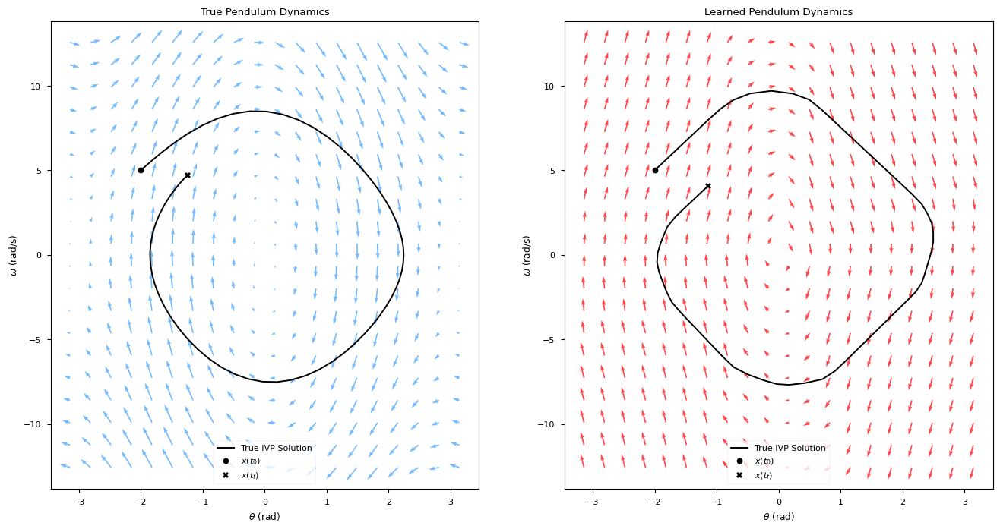

In [191]:
pred_dx_dt = learning_ode_model(coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-', label="True IVP Solution")
true_ax.plot(xt_rk4[0, 0, 0], xt_rk4[0, 0, 1], 'ko', label="$x(t_0)$")
true_ax.plot(xt_rk4[0, -1, 0], xt_rk4[0, -1, 1], 'kX', label="$x(t_f)$")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.set_title("True Pendulum Dynamics")
true_ax.legend()
pred_ax.quiver(coords[:, 0], coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-', label="True IVP Solution")
pred_ax.plot(xt_hat[0, 0, 0], xt_hat[0, 0, 1], 'ko', label="$x(t_0)$")
pred_ax.plot(xt_hat[0, -1, 0], xt_hat[0, -1, 1], 'kX', label="$x(t_f)$")
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
pred_ax.set_title("Learned Pendulum Dynamics")
pred_ax.legend()
plt.show()

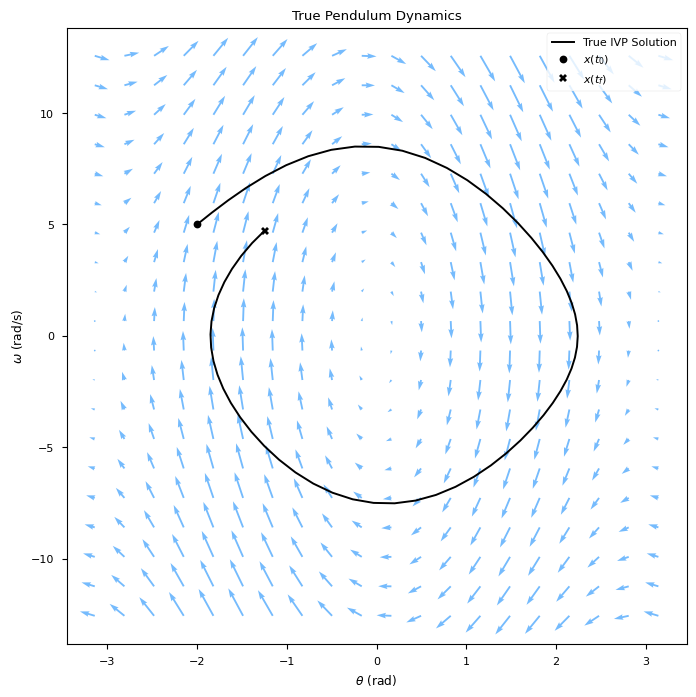

In [195]:
pred_dx_dt = learning_ode_model(coords)
fig, true_ax = plt.subplots(1, 1, figsize=(8, 8))
true_ax.quiver(coords[:, 0], coords[:, 1], dx_dt[:, 0], dx_dt[:, 1], color="xkcd:sky blue")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-', label="True IVP Solution")
true_ax.plot(xt_rk4[0, 0, 0], xt_rk4[0, 0, 1], 'ko', label="$x(t_0)$")
true_ax.plot(xt_rk4[0, -1, 0], xt_rk4[0, -1, 1], 'kX', label="$x(t_f)$")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.set_title("True Pendulum Dynamics")
true_ax.legend()
plt.show()

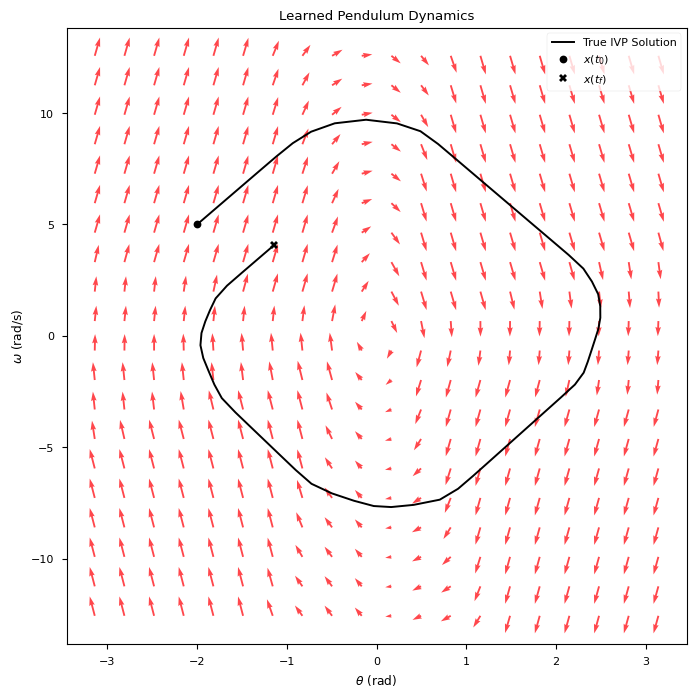

In [196]:
pred_dx_dt = learning_ode_model(coords)
fig, pred_ax = plt.subplots(1, 1, figsize=(8, 8))
pred_ax.quiver(coords[:, 0], coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-', label="True IVP Solution")
pred_ax.plot(xt_hat[0, 0, 0], xt_hat[0, 0, 1], 'ko', label="$x(t_0)$")
pred_ax.plot(xt_hat[0, -1, 0], xt_hat[0, -1, 1], 'kX', label="$x(t_f)$")
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
pred_ax.set_title("Learned Pendulum Dynamics")
pred_ax.legend()
plt.show()

In [197]:
theta = np.linspace(-4*np.pi, 4*np.pi, 20)
omega = np.linspace(-16*np.pi, 16*np.pi, 20)
X, Y = np.meshgrid(theta, omega)
big_coords = tf.concat([tf.stack([[X[x, y], Y[x, y]] for y in range(20)], axis=0) for x in range(20)], axis=0)
coords = tf.cast(big_coords, tf.float64)
big_coords.shape

TensorShape([400, 2])

In [198]:
big_dx_dt = ode_model(None, big_coords)
big_dx_dt.shape

TensorShape([400, 2])

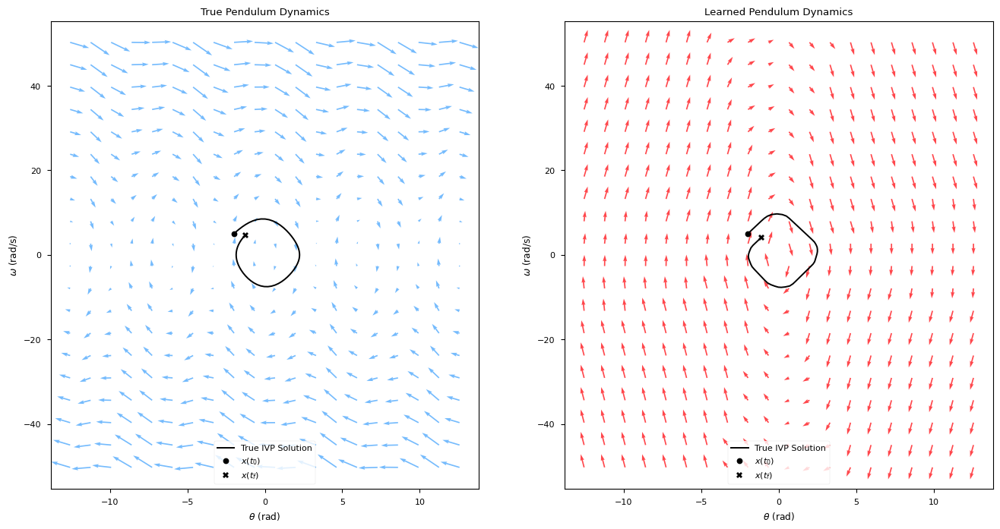

In [199]:
pred_dx_dt = learning_ode_model(big_coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(big_coords[:, 0], big_coords[:, 1], big_dx_dt[:, 0], big_dx_dt[:, 1], color="xkcd:sky blue")
true_ax.plot(xt_rk4[0, :, 0], xt_rk4[0, :, 1], 'k-', label="True IVP Solution")
true_ax.plot(xt_rk4[0, 0, 0], xt_rk4[0, 0, 1], 'ko', label="$x(t_0)$")
true_ax.plot(xt_rk4[0, -1, 0], xt_rk4[0, -1, 1], 'kX', label="$x(t_f)$")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.set_title("True Pendulum Dynamics")
true_ax.legend()
pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-', label="True IVP Solution")
pred_ax.plot(xt_hat[0, 0, 0], xt_hat[0, 0, 1], 'ko', label="$x(t_0)$")
pred_ax.plot(xt_hat[0, -1, 0], xt_hat[0, -1, 1], 'kX', label="$x(t_f)$")
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
pred_ax.set_title("Learned Pendulum Dynamics")
pred_ax.legend()
plt.show()

In [200]:
theta = np.linspace(-16*np.pi, 16*np.pi, 20)
omega = np.linspace(-16*4*np.pi, 16*4*np.pi, 20)
X, Y = np.meshgrid(theta, omega)
big_coords = tf.concat([tf.stack([[X[x, y], Y[x, y]] for y in range(20)], axis=0) for x in range(20)], axis=0)
coords = tf.cast(big_coords, tf.float64)
big_coords.shape

TensorShape([400, 2])

In [201]:
big_dx_dt = ode_model(None, big_coords)
big_dx_dt.shape

TensorShape([400, 2])

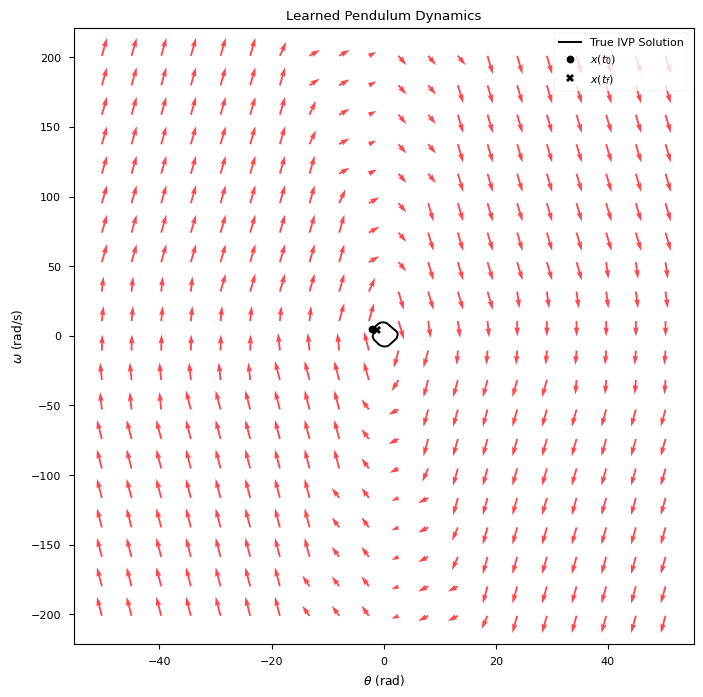

In [202]:
pred_dx_dt = learning_ode_model(big_coords)
fig, pred_ax = plt.subplots(1, 1, figsize=(8, 8))
pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.plot(xt_hat[0, :, 0], xt_hat[0, :, 1], 'k-', label="True IVP Solution")
pred_ax.plot(xt_hat[0, 0, 0], xt_hat[0, 0, 1], 'ko', label="$x(t_0)$")
pred_ax.plot(xt_hat[0, -1, 0], xt_hat[0, -1, 1], 'kX', label="$x(t_f)$")
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
pred_ax.set_title("Learned Pendulum Dynamics")
pred_ax.legend()
plt.show()

# Training on a Large Set

In [329]:
batch_x_0 = tf.random.uniform([1000, 2], [-20, -20], [20, 20], dtype=tf.float64)
batch_x_0.shape

TensorShape([1000, 2])

In [331]:
p2 = tf.tile(tf.constant([9.81, 0.01, 0.4, 0.5, 0.03], dtype=tf.float64)[None, :], (1000, 1))
p2.shape

TensorShape([1000, 5])

In [332]:
ode_model_2 = lambda t, x: system(x, None, p2, t)

In [333]:
batch_x, tt_rk4 = tfd.de.odeint(ode_model_2, batch_x_0, tfd_time_range, method='dopri5', rtol=1e-3, atol=1e-3)
batch_x.shape

TensorShape([1000, 65, 2])

In [334]:
magnitude_theta = tf.reduce_max(tf.abs(batch_x[..., 0]))
magnitude_omega = tf.reduce_max(tf.abs(batch_x[..., 1]))
theta = np.linspace(-magnitude_theta, magnitude_theta, 20)
omega = np.linspace(-magnitude_omega, magnitude_omega, 20)
X, Y = np.meshgrid(theta, omega)
big_coords = tf.concat([tf.stack([[X[x, y], Y[x, y]] for y in range(20)], axis=0) for x in range(20)], axis=0)
big_coords = tf.cast(big_coords, tf.float64)
big_coords.shape

TensorShape([400, 2])

In [357]:
big_dx_dt = ode_model(None, big_coords)
big_dx_dt.shape

TensorShape([400, 2])

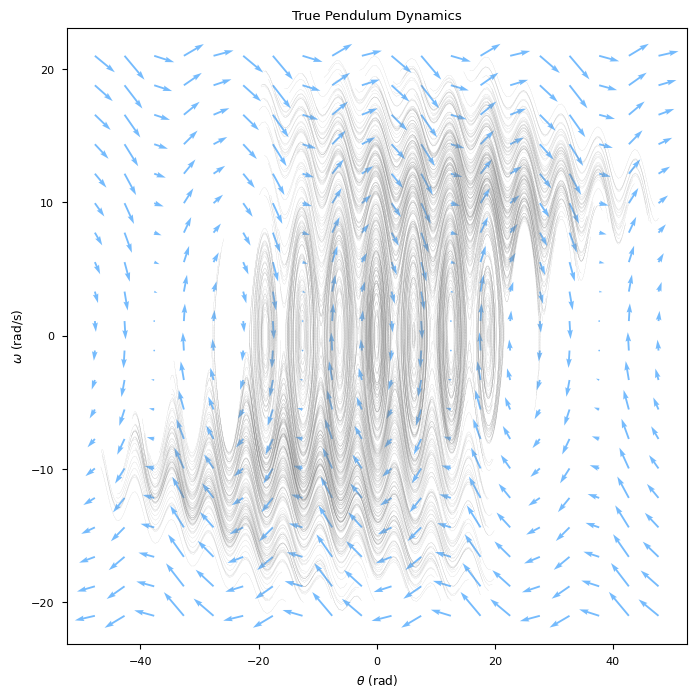

In [358]:
fig, true_ax = plt.subplots(1, 1, figsize=(8, 8))
true_ax.quiver(big_coords[:, 0], big_coords[:, 1], big_dx_dt[:, 0], big_dx_dt[:, 1], color="xkcd:sky blue")
for traj in batch_x:
    true_ax.plot(traj[:, 0], traj[:, 1], '--', color="gray", linewidth="0.1")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.set_title("True Pendulum Dynamics")
plt.show()

In [359]:
batch_x_truncated = tf.reshape(tf.stack([batch_x[:, :-1, :], batch_x[:, 1:, :]], axis=-2), [64000, 2, 2])
batch_x_truncated.shape

TensorShape([64000, 2, 2])

In [360]:
batch_time = tfd_time_range[:, :2]
batch_time

<tf.Tensor: shape=(1, 2), dtype=float64, numpy=array([[0.     , 0.03125]])>

In [387]:
#learning_ode_model = create_new_model(tf.keras.initializers.Zeros())
#learning_ode_model = create_new_model(tf.keras.initializers.Constant(1e-4))
learning_ode_model = create_new_model(None, [256, 256])
learning_ode_func = lambda t, x: learning_ode_model(x)
learning_solver = tfd.de.OdeintSolver(learning_ode_func, method='dopri5',
                                      options=dict(rtol=1e-2, atol=1e-2),
                                      adjoint_options=dict(rtol=1e-2, atol=1e-2))

In [388]:
# touch once
print(learning_ode_model(batch_x_0).shape)
learning_ode_model.trainable_variables

(1000, 2)


[<tf.Variable 'dense_88/kernel:0' shape=(2, 256) dtype=float64, numpy=
 array([[-0.05684214,  0.12902746, -0.02798756,  0.11814207, -0.13643093,
         -0.04100131, -0.05931467,  0.13416886,  0.0255524 , -0.12516353,
         -0.07339182, -0.11714661,  0.01278949, -0.0698105 , -0.10381615,
          0.12146108, -0.08100081, -0.03162901, -0.09013022, -0.06710036,
         -0.07822924,  0.09371018, -0.09966677,  0.11982638,  0.05834489,
          0.09131656,  0.05473346, -0.0983577 ,  0.03144961,  0.12679404,
         -0.06986121, -0.06035627, -0.0734763 ,  0.08099587, -0.12696605,
          0.01756621,  0.14588339, -0.10869111, -0.11042441, -0.0091776 ,
          0.1495219 , -0.00206017, -0.14688981,  0.11990049, -0.12213293,
          0.04310932,  0.08380494,  0.14758228,  0.11441376,  0.0932085 ,
         -0.05975887,  0.12238976,  0.11488533, -0.11709851,  0.01577699,
          0.10878037,  0.11285567, -0.13394277,  0.05156349,  0.12146026,
          0.15175317,  0.03175612,  0.079

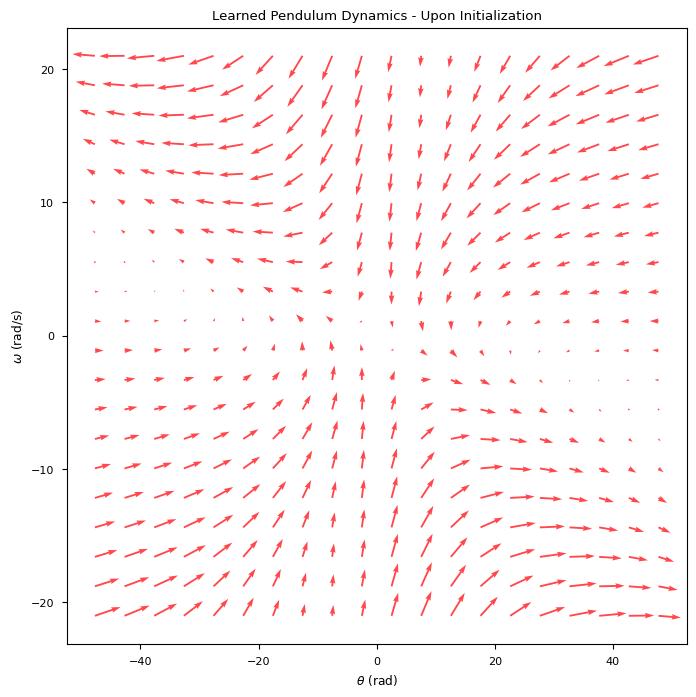

In [389]:
pred_dx_dt = learning_ode_model(big_coords)
fig, pred_ax = plt.subplots(1, 1, figsize=(8, 8))
pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
pred_ax.set_title("Learned Pendulum Dynamics - Upon Initialization")
plt.show()

0: 15.712121864801254


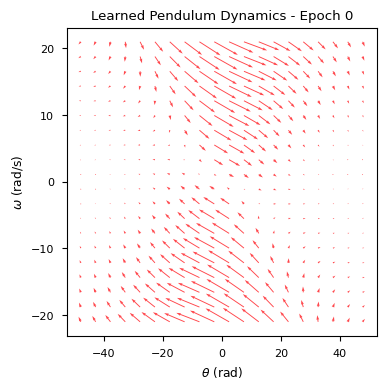

1: 13.408811454378274


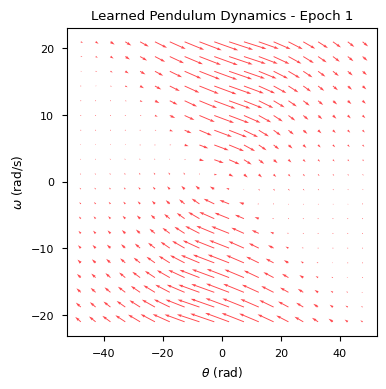

2: 11.47502995607746


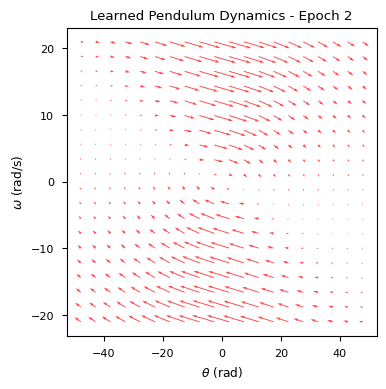

3: 9.834258632363612


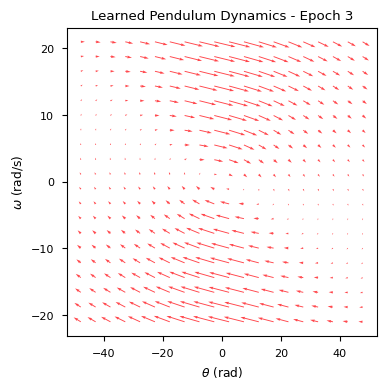

4: 8.468000132425122


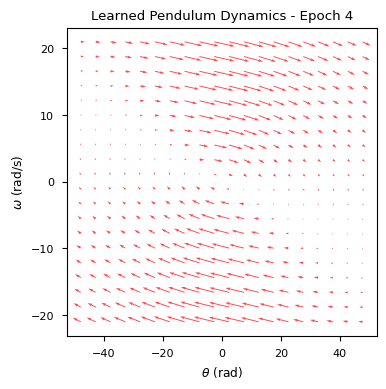

5: 7.386780970213116


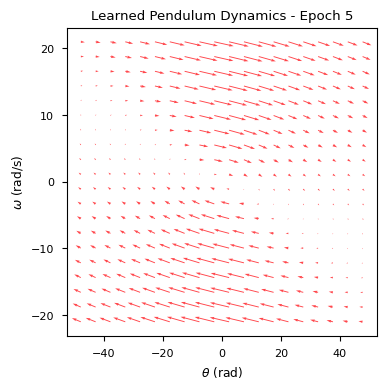

6: 6.599585211383904


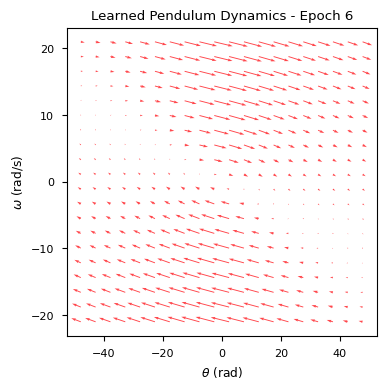

7: 6.078838728779929


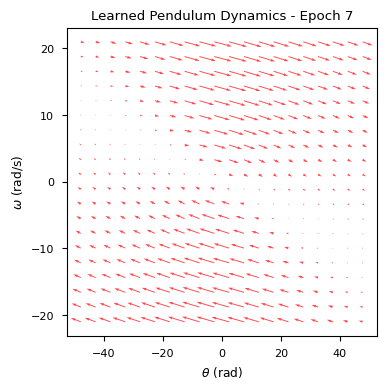

8: 5.780502960949023


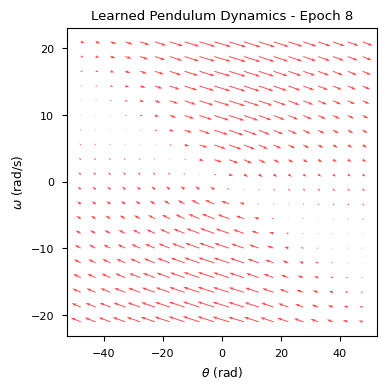

9: 5.627587197324113


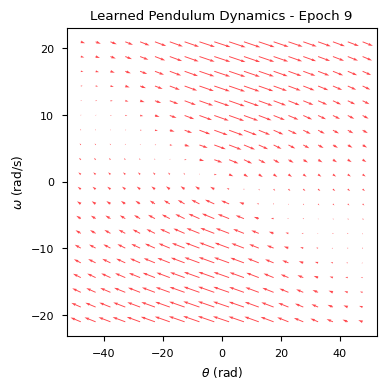

10: 5.5640717989313435


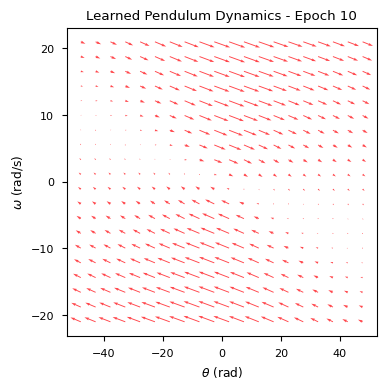

11: 5.5006227833571435


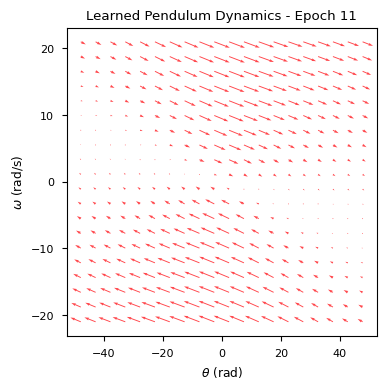

12: 5.405508028303658


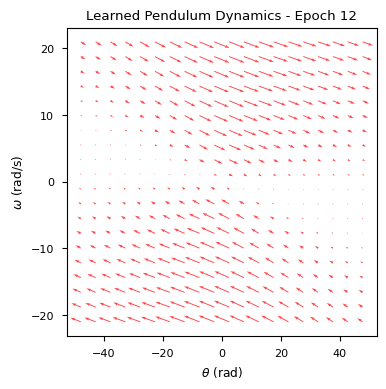

13: 5.293893342708814


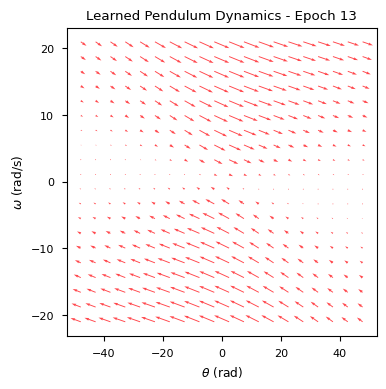

14: 5.1892445781997


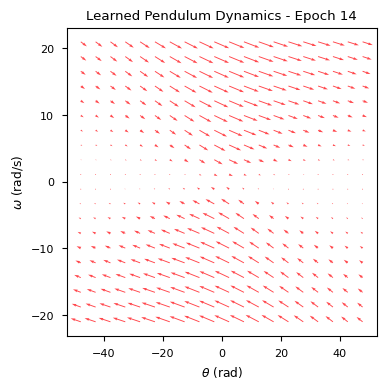

15: 5.107529435499725


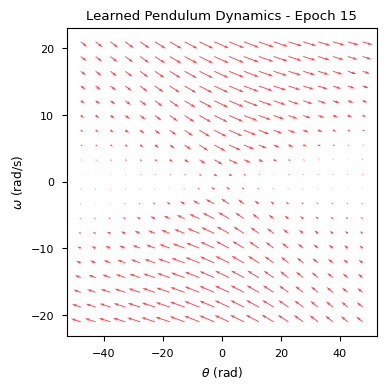

16: 5.049422247483722


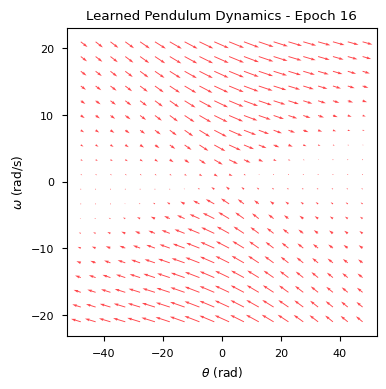

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.ops.tensor_array_ops.TensorArray'>):
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
  File "c:\users\joewo\workspaces\tensorflow_dynamics\tensorflow_dynamics\de\solvers.py", line 52, in <genexpr>
    ys = tuple(ys_n.write(0, y_0n) for ys_n, y_0n in zip(ys, y_0))  File "C:\Users\joewo\python_envs\tfd\lib\site-packages\tensorflow\python\util\tf_should_use.py", line 243, in wrapped
    return _add_should_use_warning(fn(*args, **kwargs),
ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.ops.tensor_array_ops.TensorArray'>):
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
  File "c:\users\joewo\workspaces\tensorflow_dynamics\tensorflow_dynamics\de\solvers.py", line 52, in <genexpr>
    ys = tuple(ys_n.write(0, y_0n) for ys_n, y_0n in zip(ys,

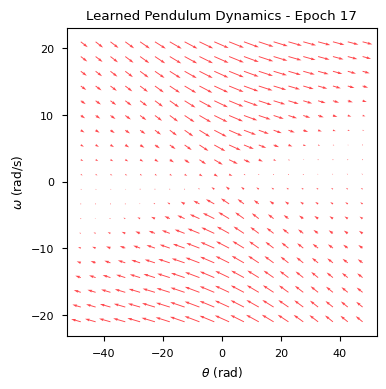

18: 4.970342237603555


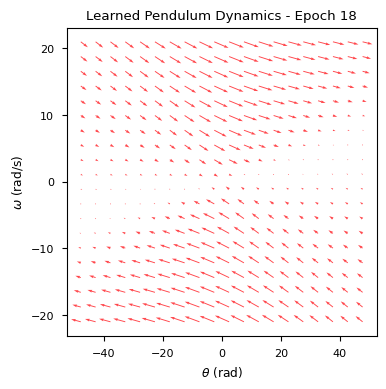

19: 4.932879750382631


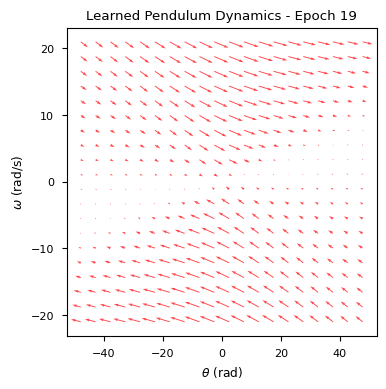

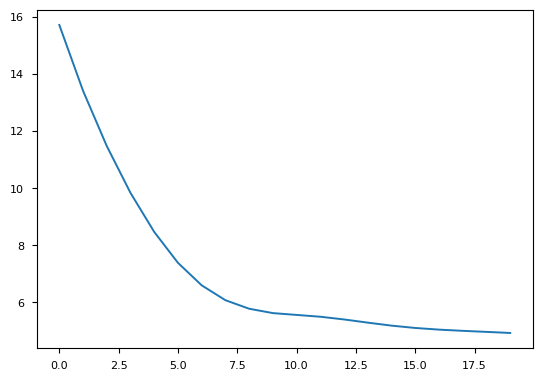

In [ ]:
#optimizer = tf.keras.optimizers.RMSprop(learning_rate=1e-3)
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-3)
losses = []

for epoch in range(20):
    with tf.GradientTape() as tape:
        xt_hat, *_ = learning_solver.odeint_adjoint(batch_x[..., 0, :], tfd_time_range)
        err = tf.reduce_mean(tf.linalg.norm(xt_hat[..., -1, :] - batch_x[..., -1, :], axis=-1))
    grads = tape.gradient(err, learning_ode_model.trainable_variables)
    optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
    losses.append(err)
    print(f"{epoch}: {err}")
                  
    pred_dx_dt = learning_ode_model(big_coords)
    fig, pred_ax = plt.subplots(1, 1, figsize=(4, 4))
    pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
    pred_ax.set_xlabel(r"$\theta$ (rad)")
    pred_ax.set_ylabel(r"$\omega$ (rad/s)")
    pred_ax.set_title(f"Learned Pendulum Dynamics - Epoch {epoch}")
    plt.show()
plt.plot(losses)

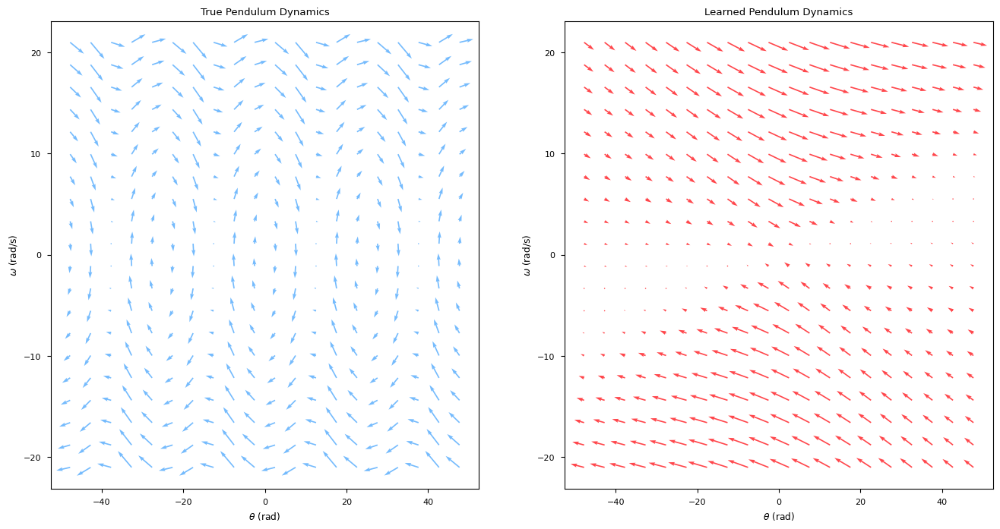

In [392]:
pred_dx_dt = learning_ode_model(big_coords)
fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
true_ax.quiver(big_coords[:, 0], big_coords[:, 1], big_dx_dt[:, 0], big_dx_dt[:, 1], color="xkcd:sky blue")
true_ax.set_xlabel(r"$\theta$ (rad)")
true_ax.set_ylabel(r"$\omega$ (rad/s)")
true_ax.set_title("True Pendulum Dynamics")
pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
pred_ax.set_xlabel(r"$\theta$ (rad)")
pred_ax.set_ylabel(r"$\omega$ (rad/s)")
pred_ax.set_title("Learned Pendulum Dynamics")
plt.show()

# Learn dx/dt Directly From Truth

In [ ]:
def run_dx_dt_experiment(traj_count=1000, batch_size=1000, epochs=20,
                   lr=1e-3, activation='tanh', initializer=None, layers=None,
                   solver="dopri5", solver_args=None):
    if solver_args is None:
        solver_args = dict(rtol=1e-3, atol=1e-3)
    # generate the training data with a true dynamics simulation
    batch_x_0 = tf.random.uniform([traj_count, 2], [-20, -20], [20, 20], dtype=tf.float64)
    p = tf.tile(tf.constant([9.81, 0.01, 0.4, 0.5, 0.03], dtype=tf.float64)[None, :], (traj_count, 1))
    ode_model = lambda t, x: system(x, None, p, t)
    batch_x, tt_rk4 = tfd.de.odeint(ode_model, batch_x_0, tfd_time_range, method=solver, **solver_args)
    
    # generate flow field coordinates
    magnitude_theta = tf.reduce_max(tf.abs(batch_x[..., 0]))
    magnitude_omega = tf.reduce_max(tf.abs(batch_x[..., 1]))
    theta = np.linspace(-magnitude_theta, magnitude_theta, 20)
    omega = np.linspace(-magnitude_omega, magnitude_omega, 20)
    X, Y = np.meshgrid(theta, omega)
    big_coords = tf.concat([tf.stack([[X[x, y], Y[x, y]] for y in range(20)], axis=0) for x in range(20)], axis=0)
    big_coords = tf.cast(big_coords, tf.float64)
    
    # sample true dynamics flow field
    p_2 = tf.tile(tf.constant([9.81, 0.01, 0.4, 0.5, 0.03], dtype=tf.float64)[None, :], (big_coords.shape[0], 1))
    ode_model_2 = lambda t, x: system(x, None, p_2, t)
    big_dx_dt = ode_model_2(None, big_coords)  # [400, 2]
    
    # build tensorflow training set and model
    dataset = tf.data.Dataset.from_tensor_slices((big_coords, big_dx_dt))
    dataset = dataset.shuffle(400, reshuffle_each_iteration=True)
    dataset = dataset.batch(batch_size)
    learning_ode_model = create_new_model(initializer, layers, activation)
    
    # touch once to initialize
    pred_dx_dt = learning_ode_model(big_coords)
    
    # plot the starting flow field
    fig, pred_ax = plt.subplots(1, 1, figsize=(8, 8))
    pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
    pred_ax.set_xlabel(r"$\theta$ (rad)")
    pred_ax.set_ylabel(r"$\omega$ (rad/s)")
    pred_ax.set_title("Learned Pendulum Dynamics - Upon Initialization")
    plt.show()
    
    # train this bad boy
    optimizer = tf.keras.optimizers.Adam(learning_rate=lr)
    losses = []
    for epoch in range(epochs):
        epoch_avg_loss = []
        for (x, y) in dataset:
            with tf.GradientTape() as tape:
                y_hat = learning_ode_model(x)
                err = tf.reduce_mean(tf.linalg.norm(y - y_hat, axis=-1))
            grads = tape.gradient(err, learning_ode_model.trainable_variables)
            optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
            losses.append(err)
            epoch_avg_loss.append(err)
        epoch_avg_loss = np.mean(epoch_avg_loss)
        print(f"{epoch}: {epoch_avg_loss}")

        # plot the flow field at the end of the epoch
        pred_dx_dt = learning_ode_model(big_coords)
        fig, pred_ax = plt.subplots(1, 1, figsize=(4, 4))
        pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
        pred_ax.set_xlabel(r"$\theta$ (rad)")
        pred_ax.set_ylabel(r"$\omega$ (rad/s)")
        pred_ax.set_title(f"Learned Pendulum Dynamics - Epoch {epoch}")
        plt.show()
     
    # plot the training curve
    plt.plot(losses)
    plt.title("Losses")
    plt.xlabel("Epochs")
    
    # plot the final flow against the ground truth
    pred_dx_dt = learning_ode_model(big_coords)
    fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
    true_ax.quiver(big_coords[:, 0], big_coords[:, 1], big_dx_dt[:, 0], big_dx_dt[:, 1], color="xkcd:sky blue")
    true_ax.set_xlabel(r"$\theta$ (rad)")
    true_ax.set_ylabel(r"$\omega$ (rad/s)")
    true_ax.set_title("True Pendulum Dynamics")
    pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
    pred_ax.set_xlabel(r"$\theta$ (rad)")
    pred_ax.set_ylabel(r"$\omega$ (rad/s)")
    pred_ax.set_title("Learned Pendulum Dynamics")
    plt.show()
    
    return learning_ode_model

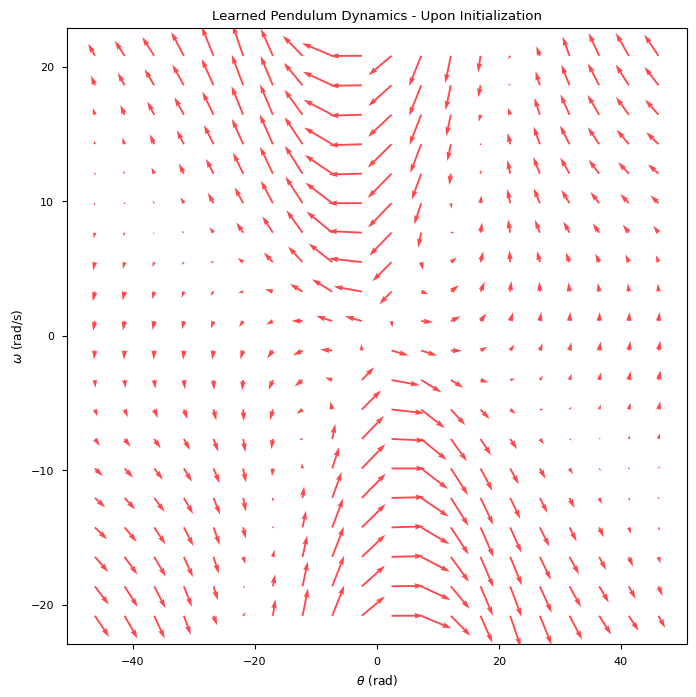

0: 17.571699758934706


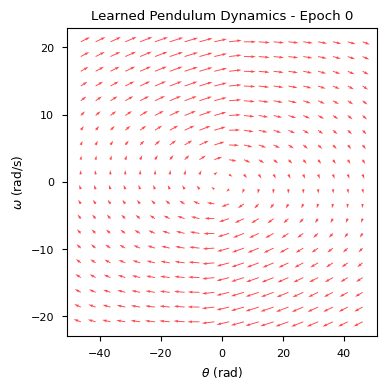

1: 16.369267842105565


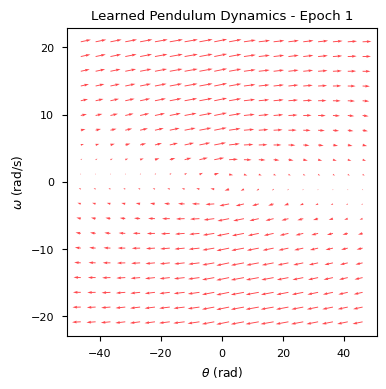

2: 15.733798529953344


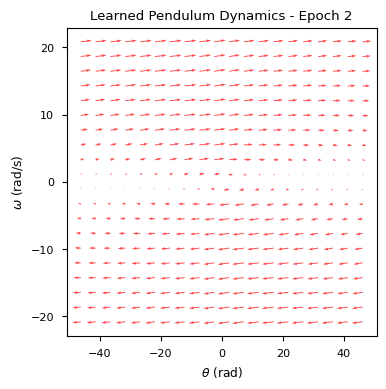

3: 15.3588068187938


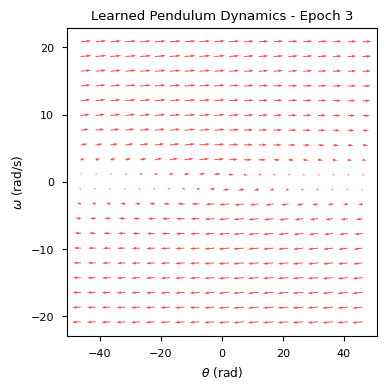

4: 15.146975547629044


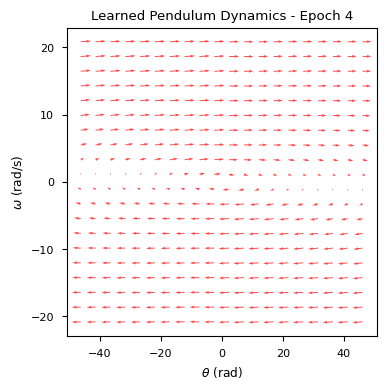

5: 14.99586835775634


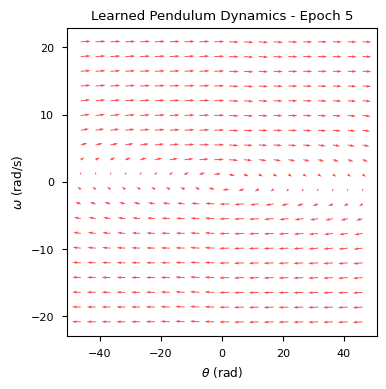

6: 14.881190066813204


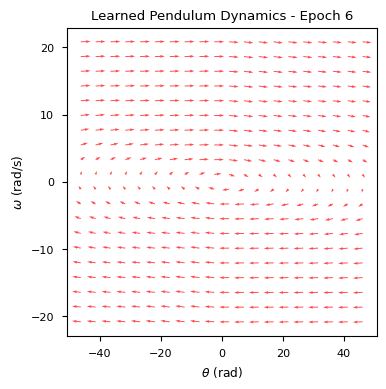

7: 14.760168477096354


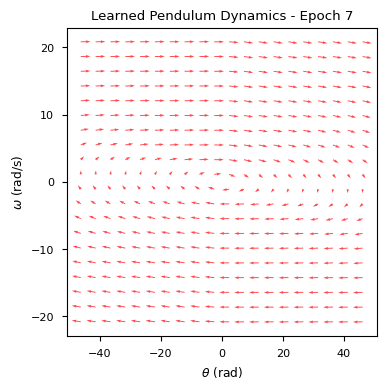

8: 14.67255189470761


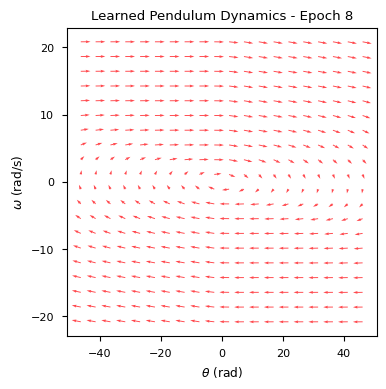

9: 14.602088302729344


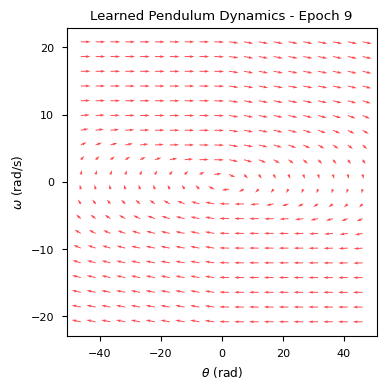

10: 14.539472351275759


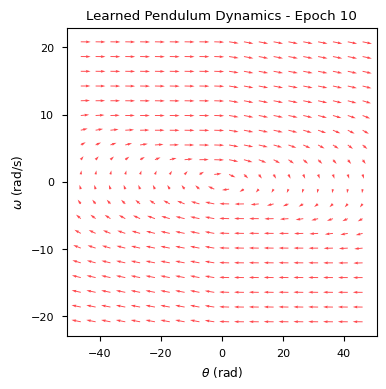

11: 14.490441306930887


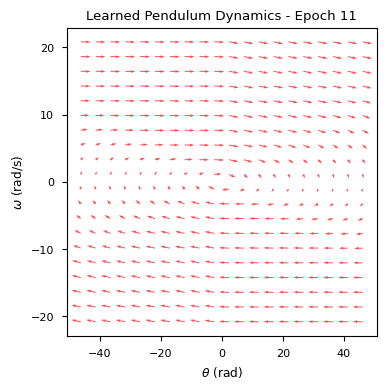

12: 14.429087463449076


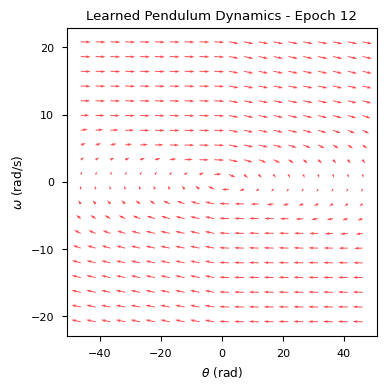

13: 14.374202103132621


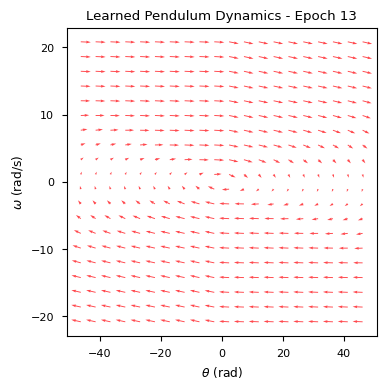

14: 14.321319493635084


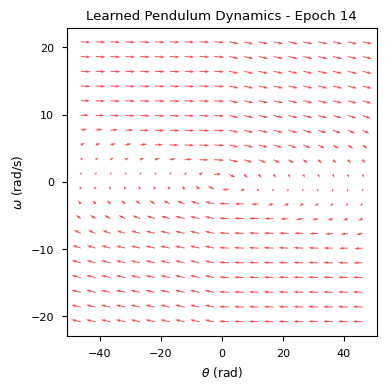

15: 14.27253776749344


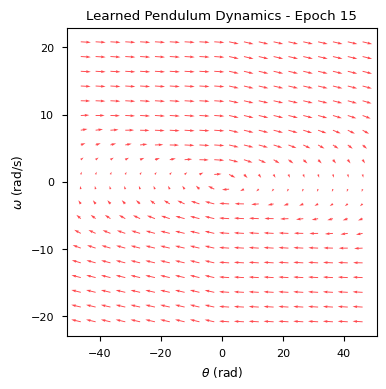

16: 14.223754724321527


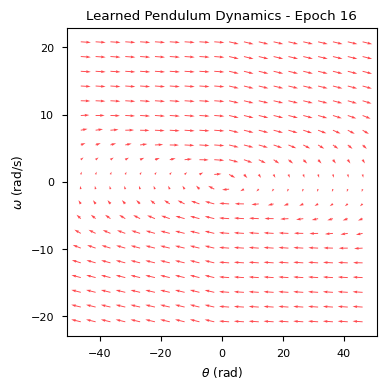

17: 14.179893896886814


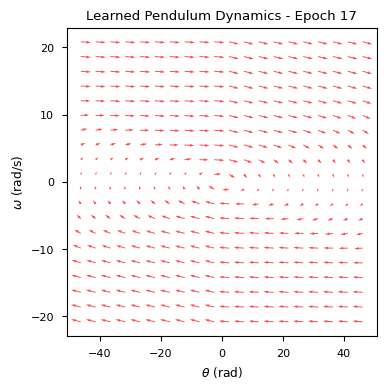

18: 14.13684790239476


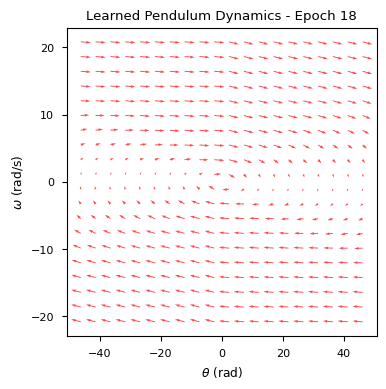

19: 14.088985805629042


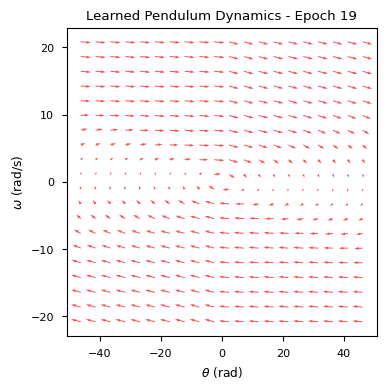

20: 14.046189317744858


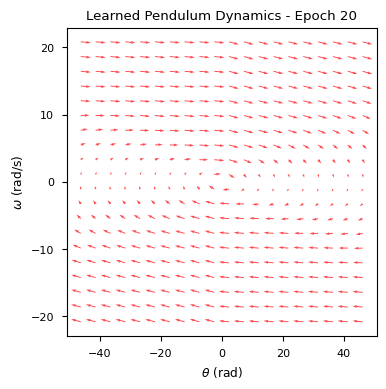

21: 14.004539629186162


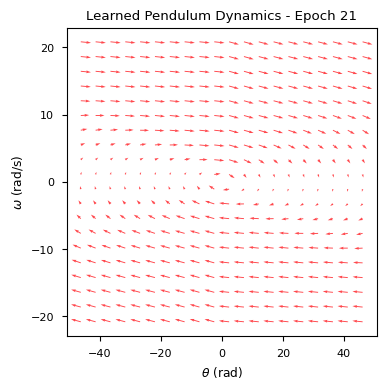

22: 13.960483772960934


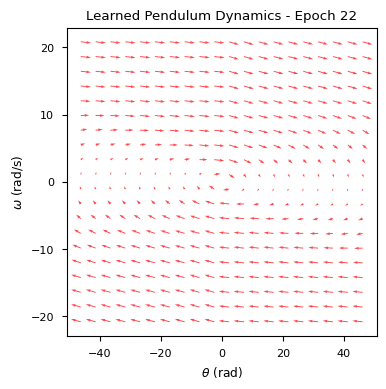

23: 13.921400677938207


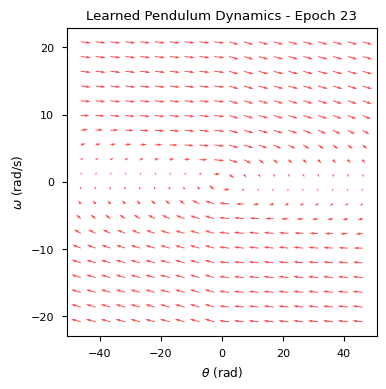

24: 13.884519076662608


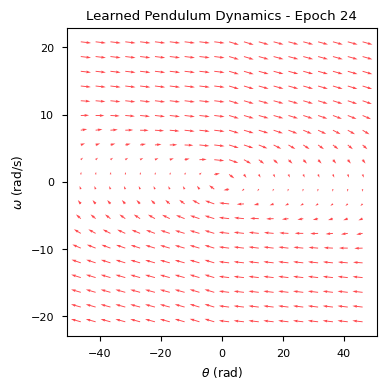

25: 13.842518983115635


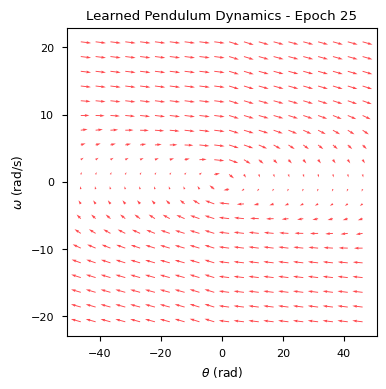

26: 13.805960267184853


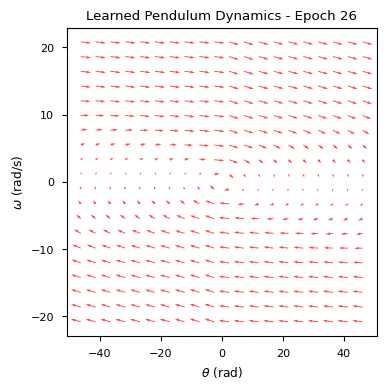

27: 13.763861152104598


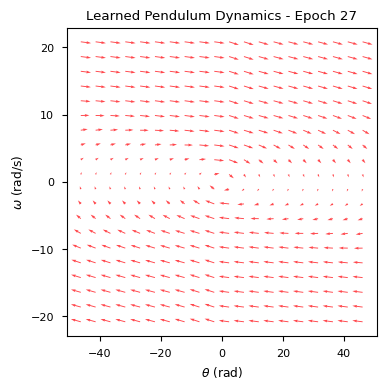

28: 13.725383134801714


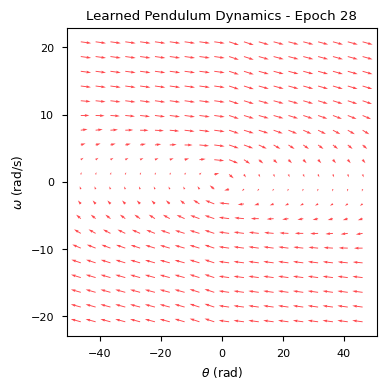

29: 13.687798937776396


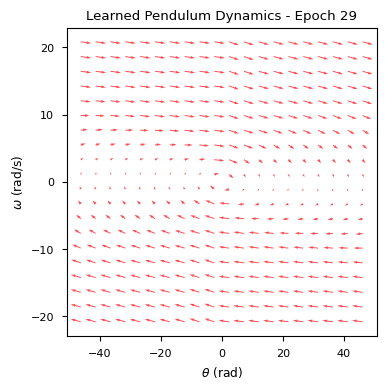

30: 13.65419651151591


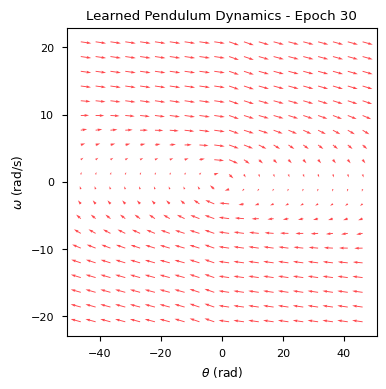

31: 13.613647848591974


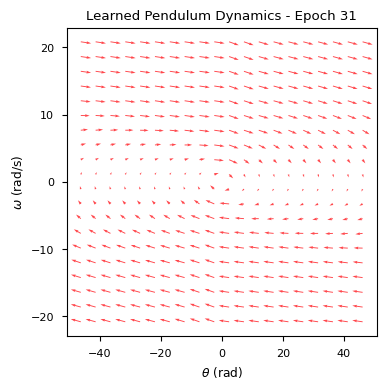

32: 13.58887104957053


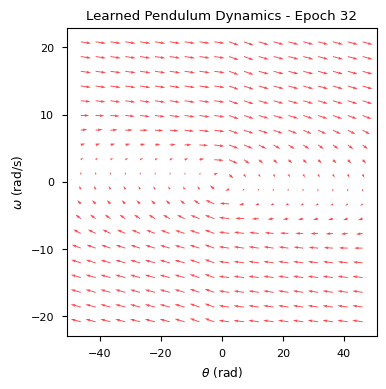

33: 13.551434491956115


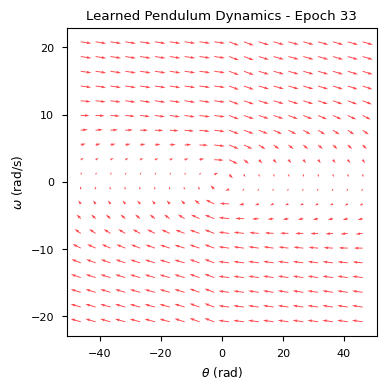

34: 13.504110509000009


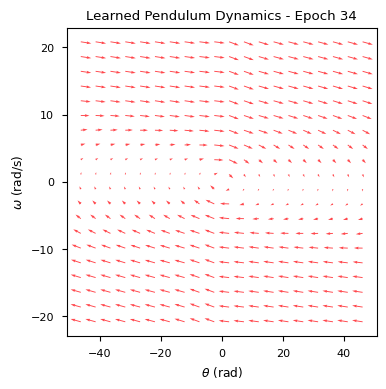

35: 13.474102619473465


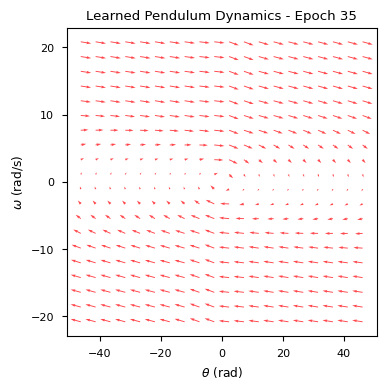

36: 13.432844189116206


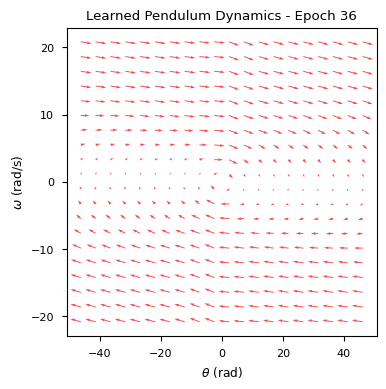

37: 13.390548928617546


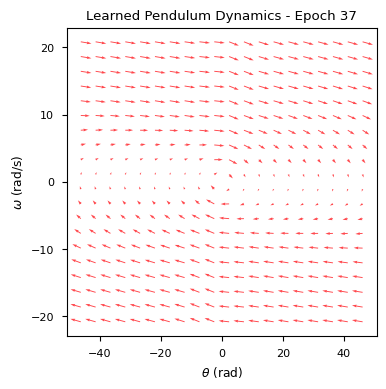

38: 13.347113942112681


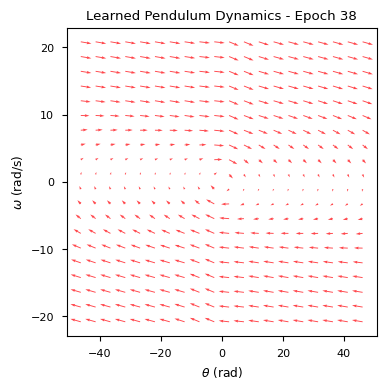

39: 13.307945839165098


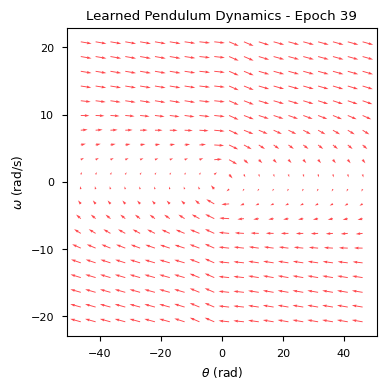

40: 13.274822681494694


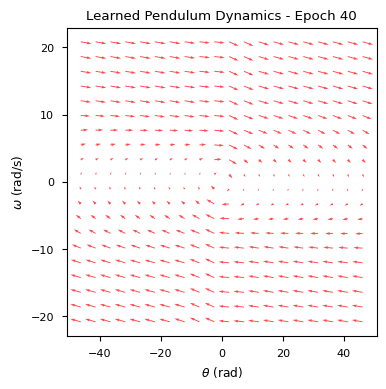

41: 13.24292901002973


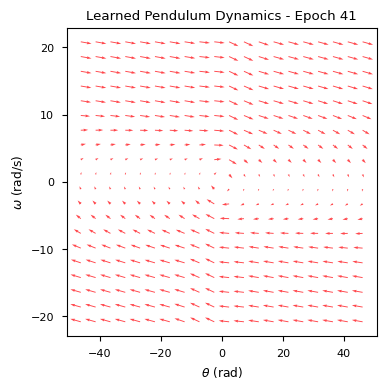

42: 13.194636896130023


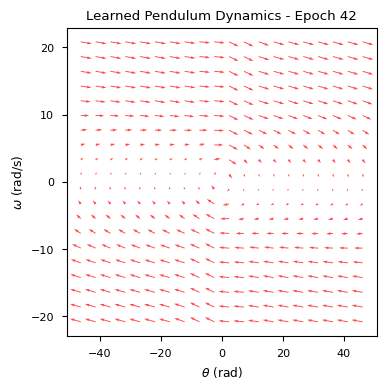

43: 13.144416863882023


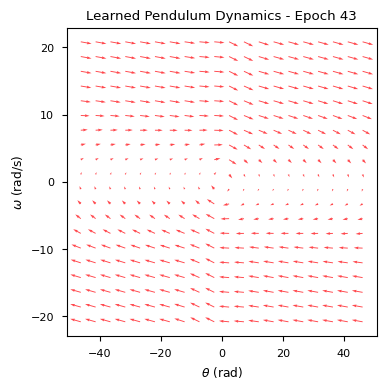

44: 13.111489134855036


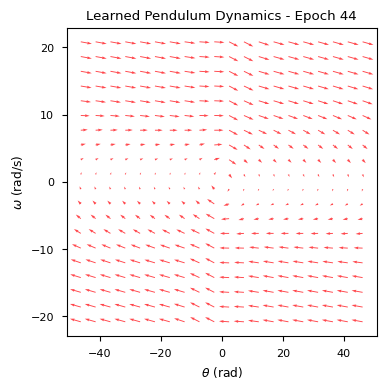

45: 13.061846316148495


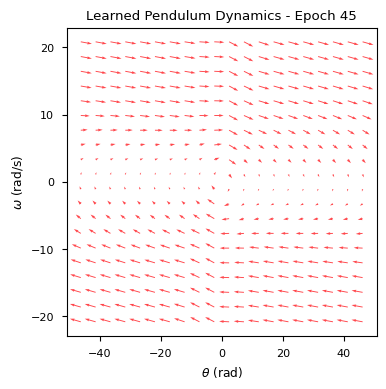

46: 13.018248214695486


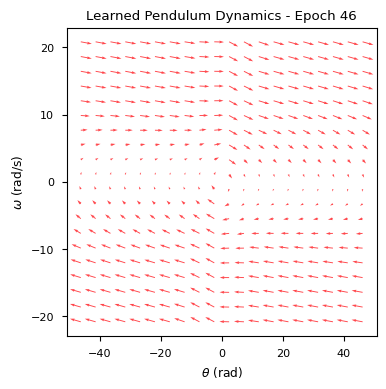

47: 12.974875899508987


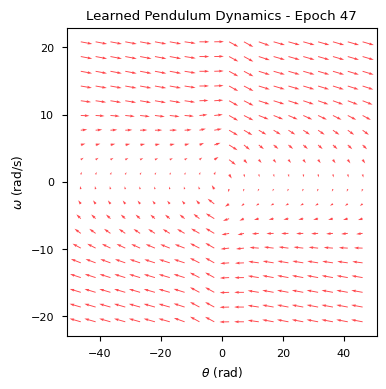

48: 12.94839033999433


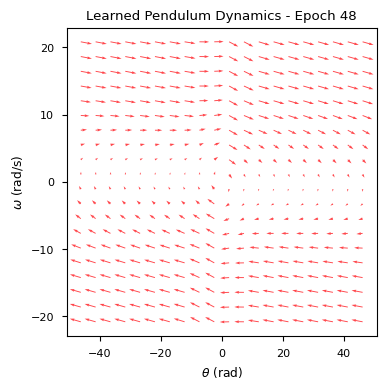

49: 12.896736091812949


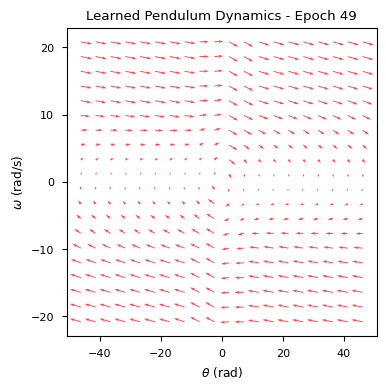

50: 12.86935745836202


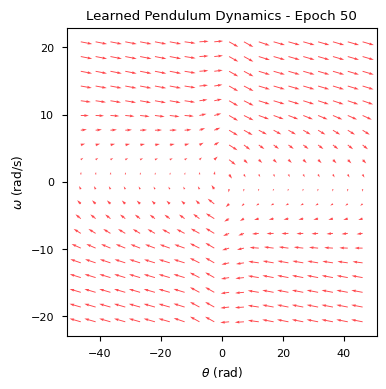

51: 12.829441686160289


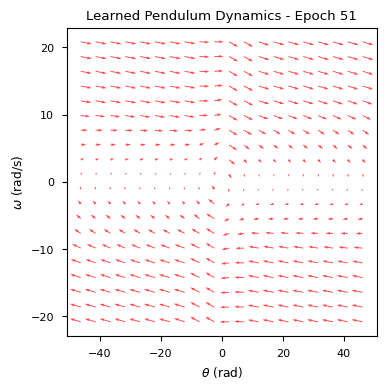

52: 12.782412510483763


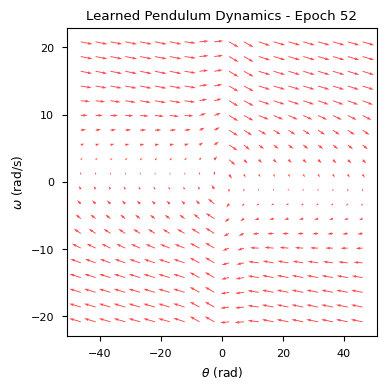

53: 12.787261933477009


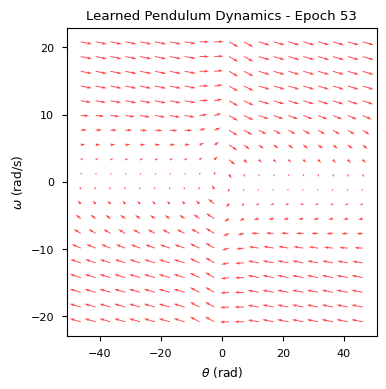

54: 12.714282846692978


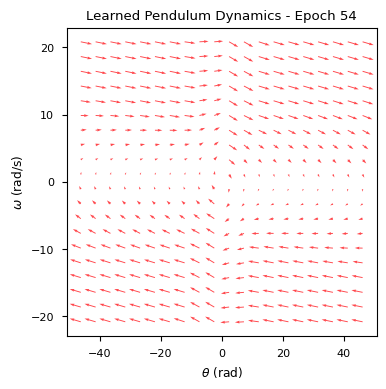

55: 12.671546195609668


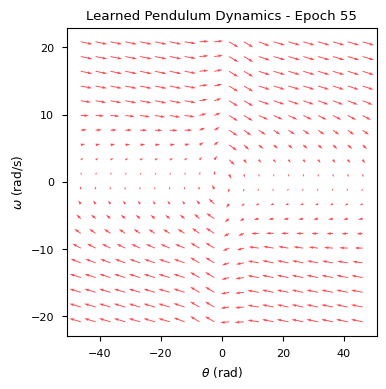

56: 12.645649955143627


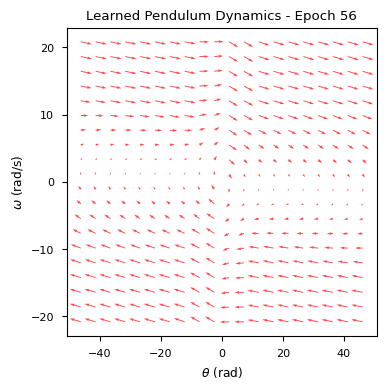

57: 12.629093244212799


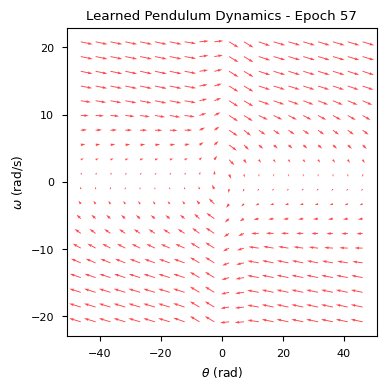

58: 12.596403719072304


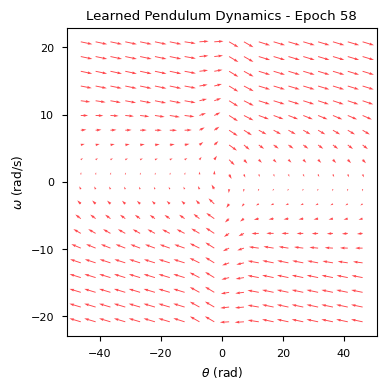

59: 12.546756557854176


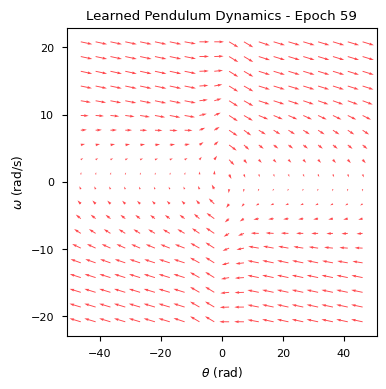

60: 12.495332344671946


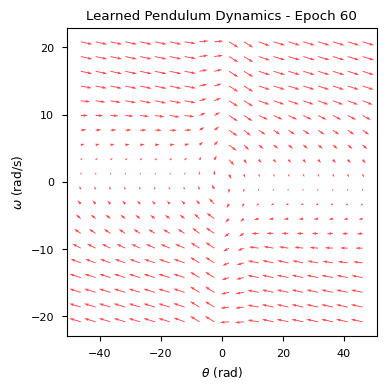

61: 12.467900234549013


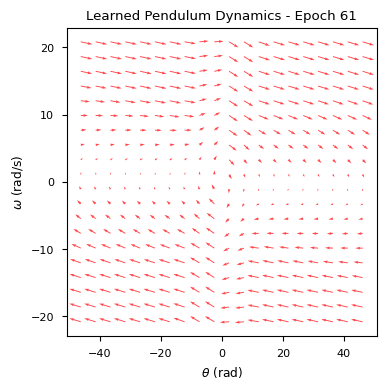

62: 12.446077980139592


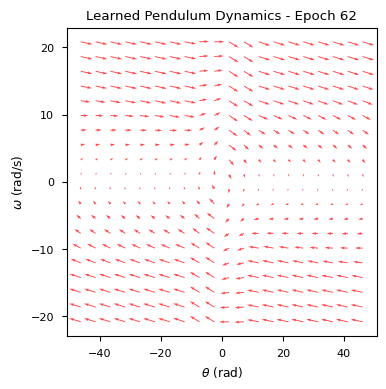

63: 12.419536601974059


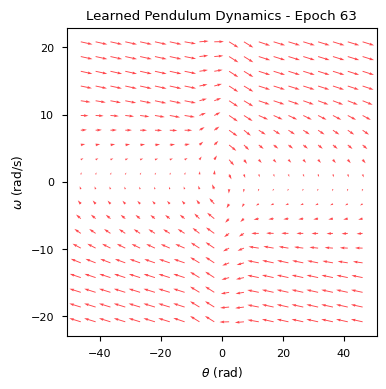

64: 12.380071358734899


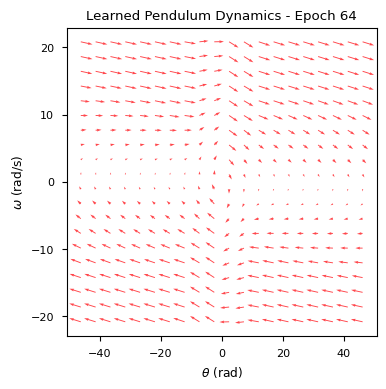

65: 12.350753994621622


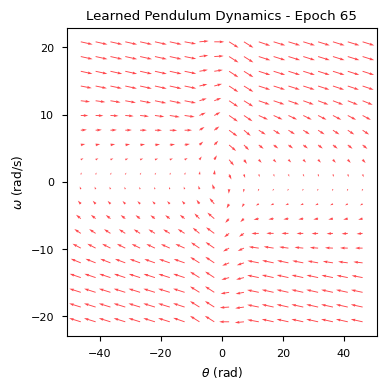

66: 12.336785391447307


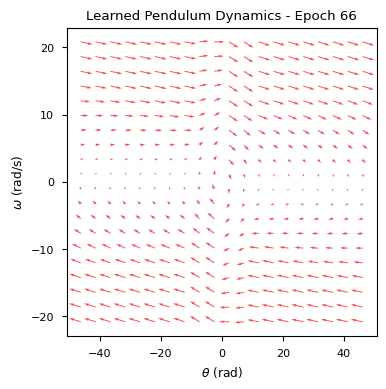

67: 12.29921727673073


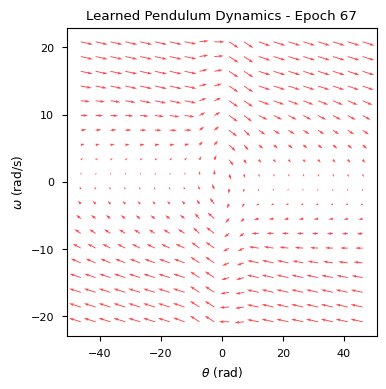

68: 12.257870703533676


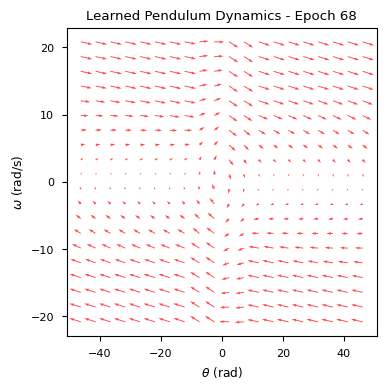

69: 12.254935925367846


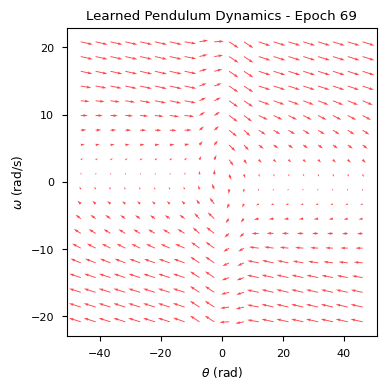

70: 12.221476123058796


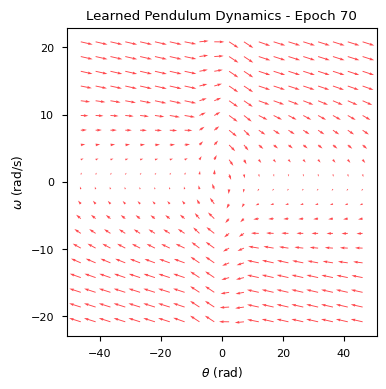

71: 12.193537107316182


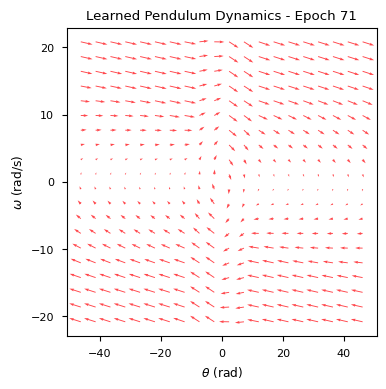

72: 12.149210865474124


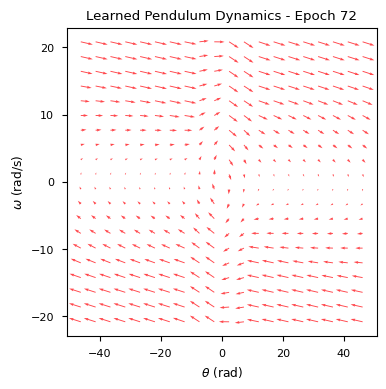

73: 12.133330370539817


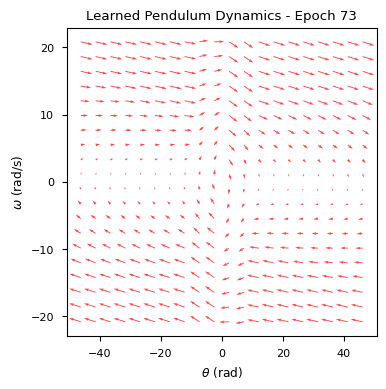

74: 12.111280643568954


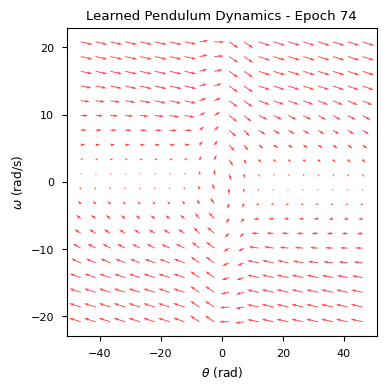

75: 12.073029934316779


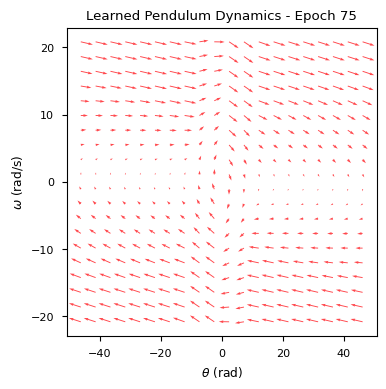

76: 12.046356251542365


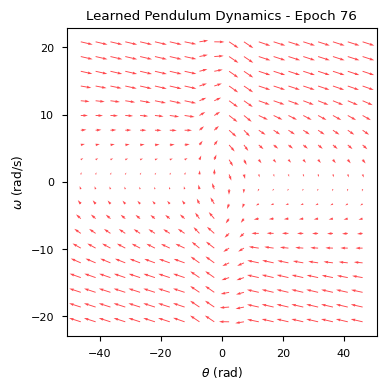

77: 12.01092889372212


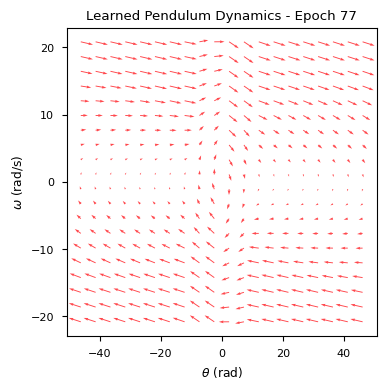

78: 12.003694294563159


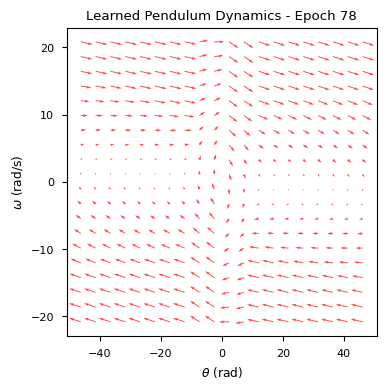

79: 12.010509497375502


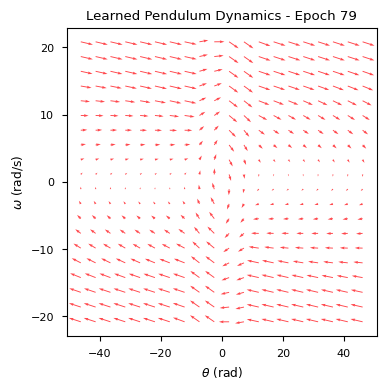

80: 11.968192735776995


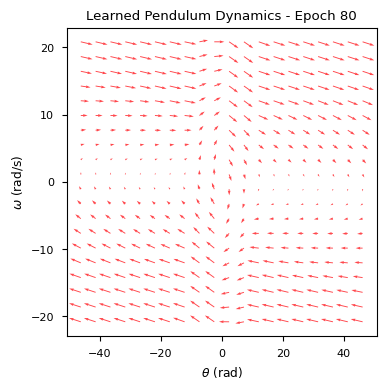

81: 11.947979328517626


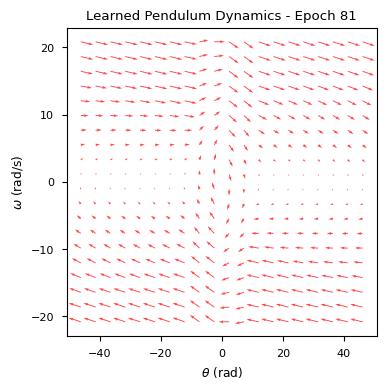

82: 11.901508420148444


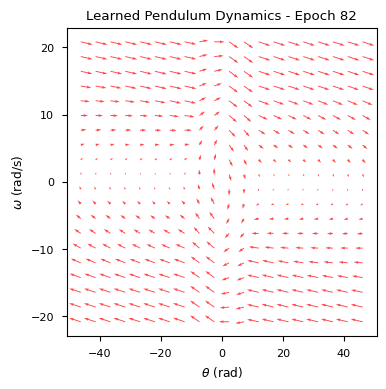

83: 11.841860765131583


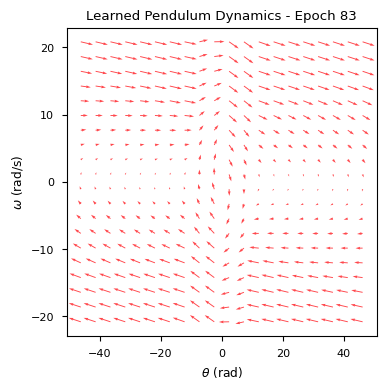

84: 11.821759591547815


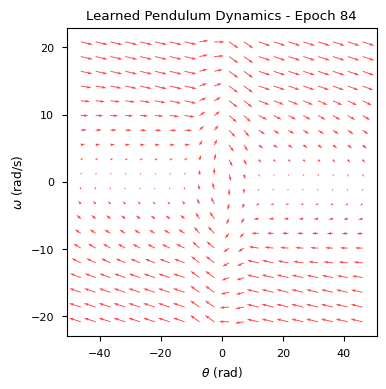

85: 11.798533131282532


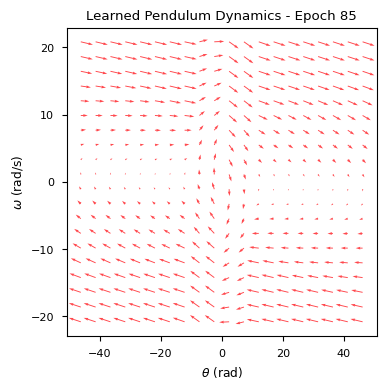

86: 11.786769692653603


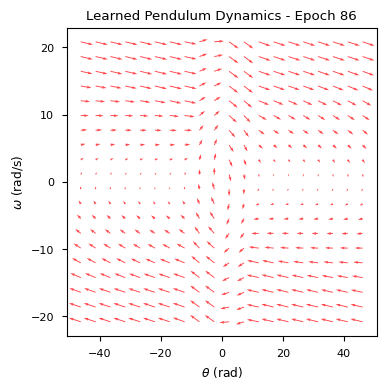

87: 11.765417839503524


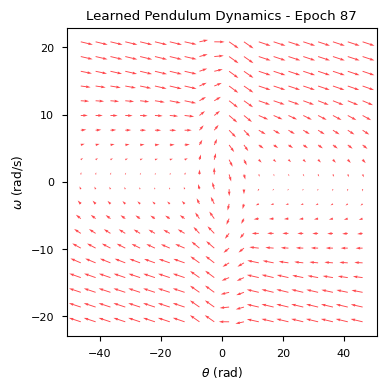

88: 11.721275795146015


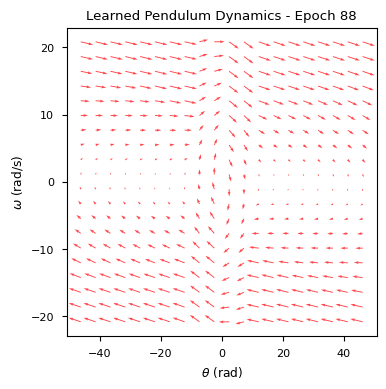

89: 11.681019265439739


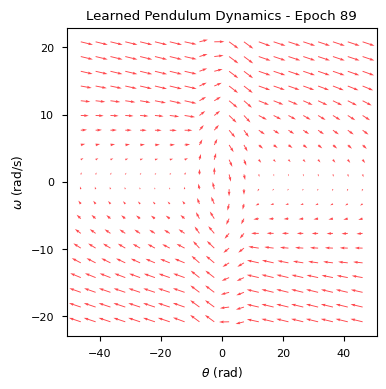

90: 11.669843427395426


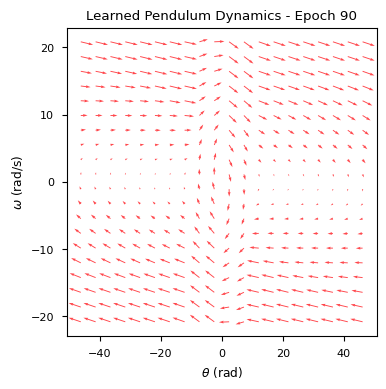

91: 11.643236702776276


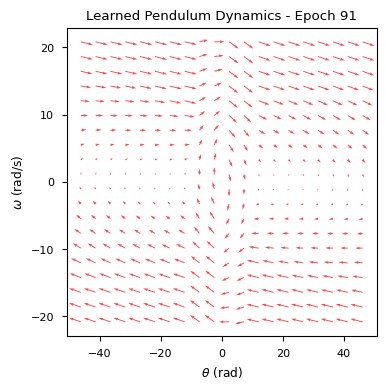

92: 11.618286896975022


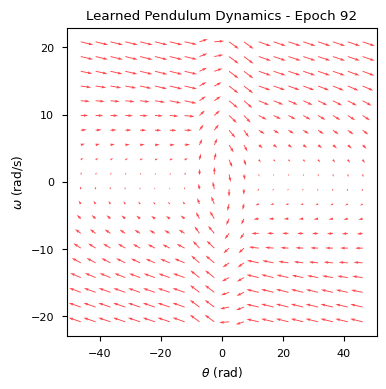

93: 11.586364837389826


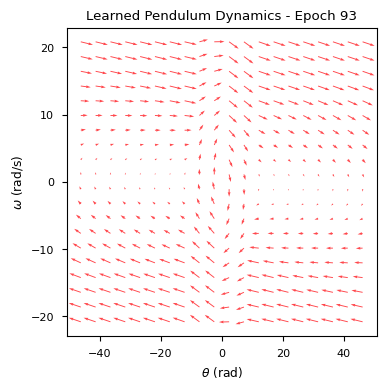

94: 11.56249519789009


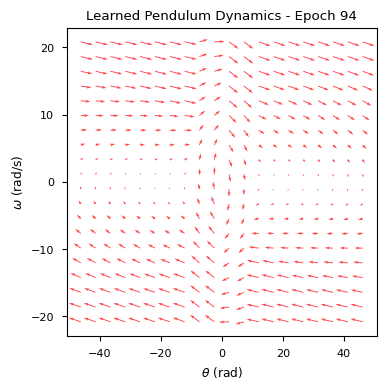

95: 11.529095038777445


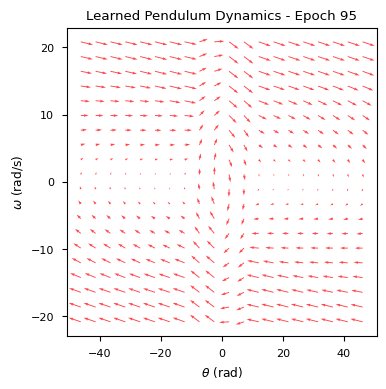

96: 11.52193968821983


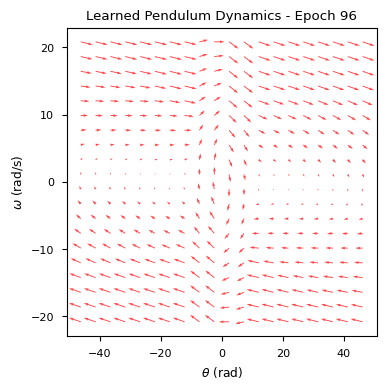

97: 11.48189683638037


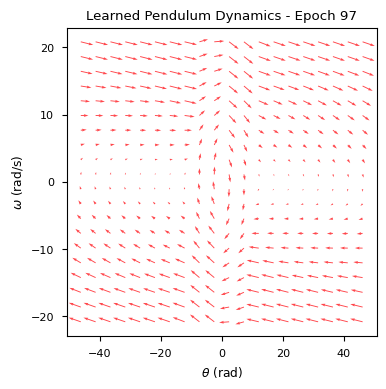

98: 11.483498144507188


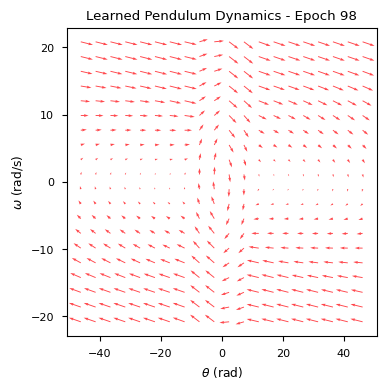

99: 11.411473695131306


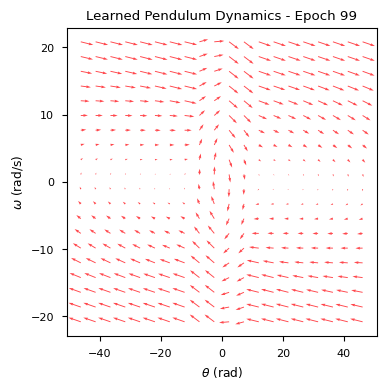

100: 11.408529167677795


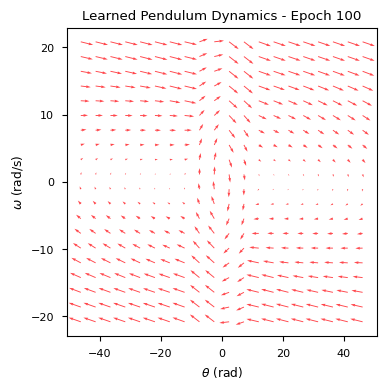

101: 11.365171963523023


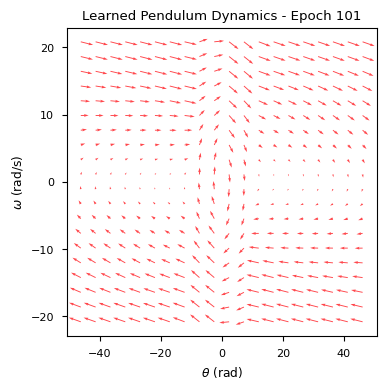

102: 11.361673200269305


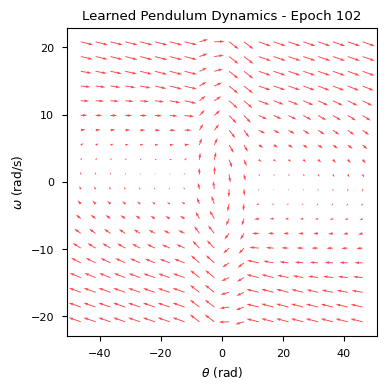

103: 11.331869962317016


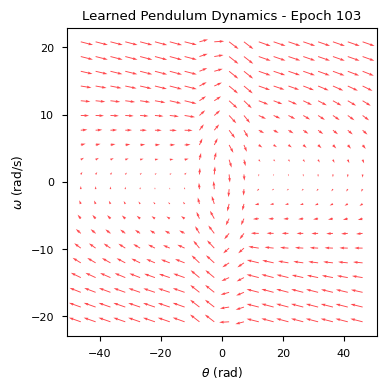

104: 11.34259154746686


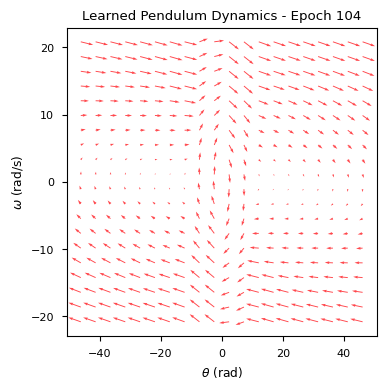

105: 11.249360838600365


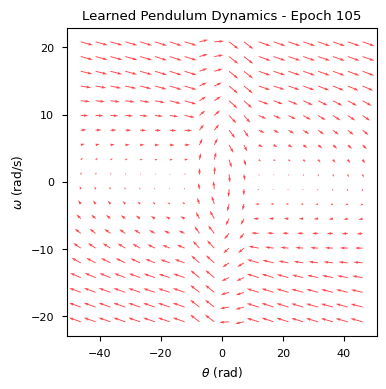

106: 11.220270258287304


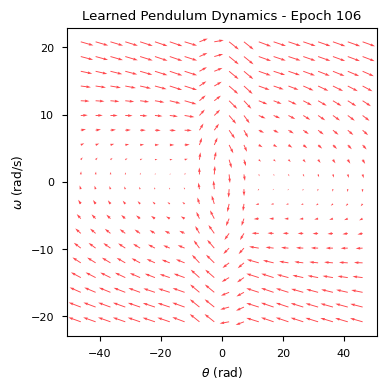

107: 11.170553460454697


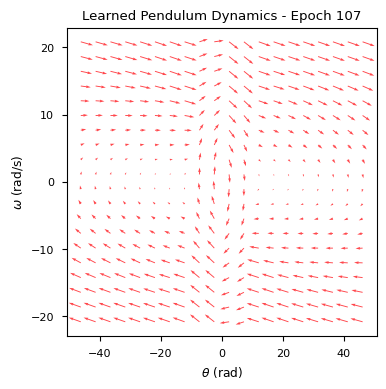

108: 11.149820329011916


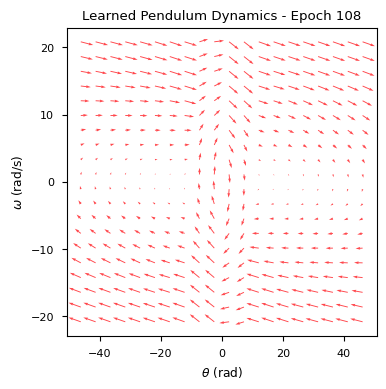

109: 11.097582280197367


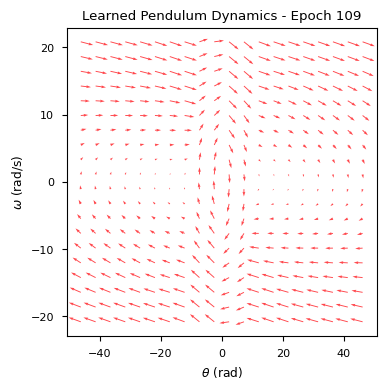

110: 11.065490729402791


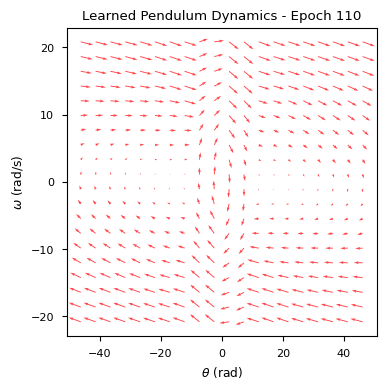

111: 11.035539164044641


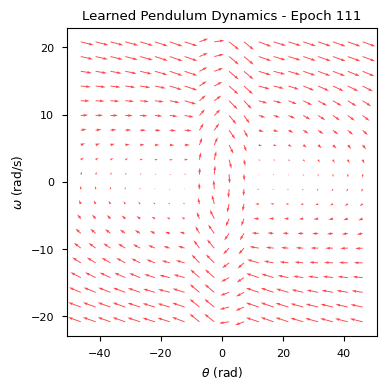

112: 11.042335290037576


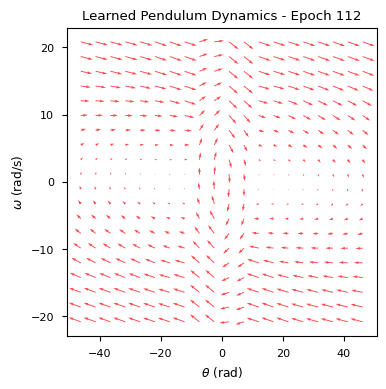

113: 10.970526467999063


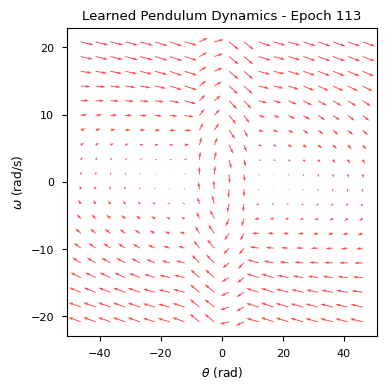

114: 10.907126154699714


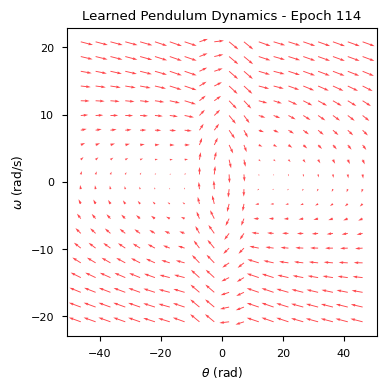

115: 10.910287570293397


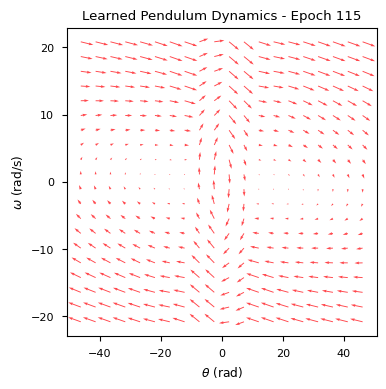

116: 10.855377670493898


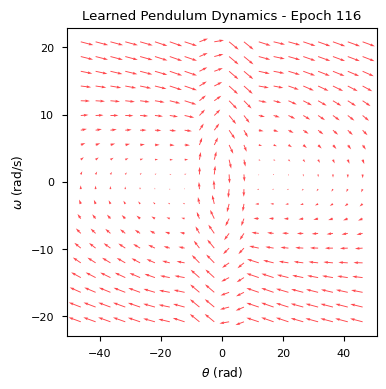

117: 10.853872400001345


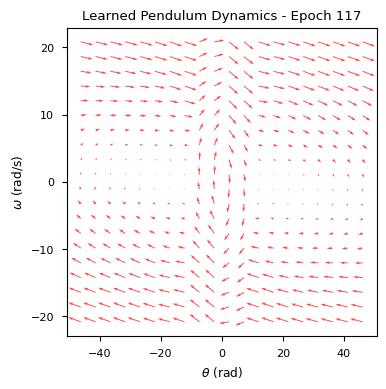

118: 10.87870765419689


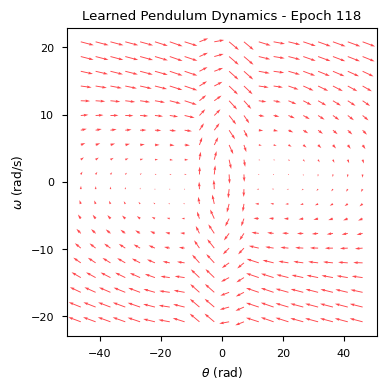

119: 10.776258238055307


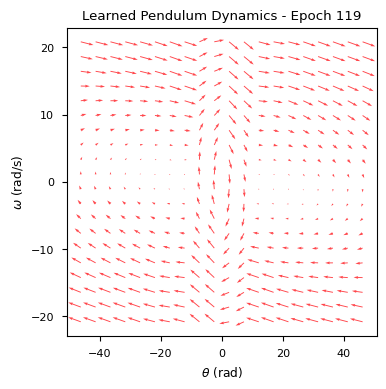

120: 10.700857039549634


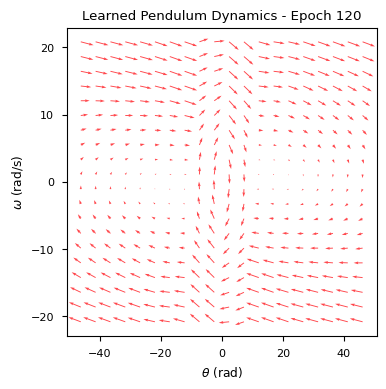

121: 10.698771895293397


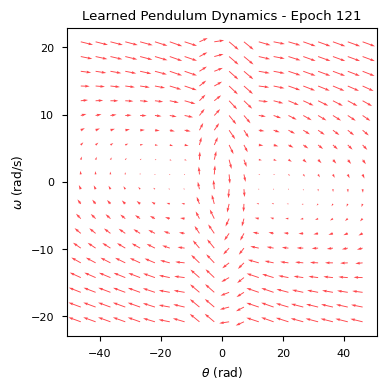

122: 10.67040801696315


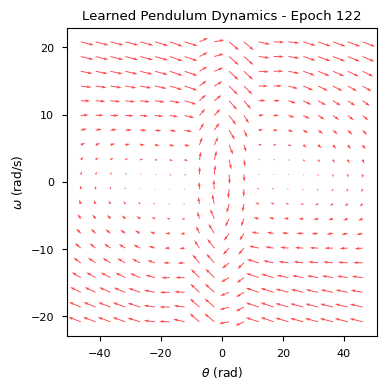

123: 10.577304930194389


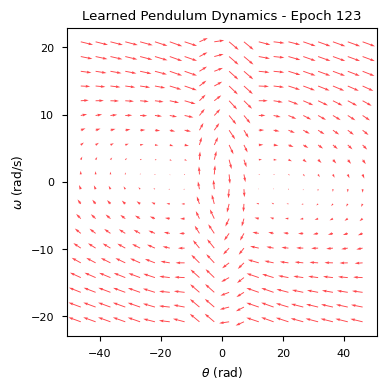

124: 10.494795840361476


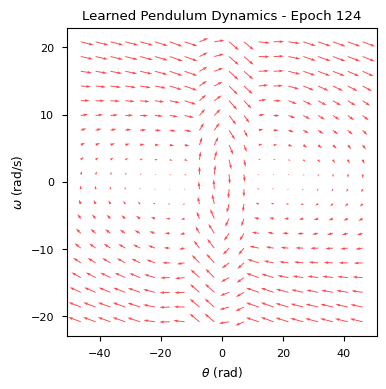

125: 10.467413579975963


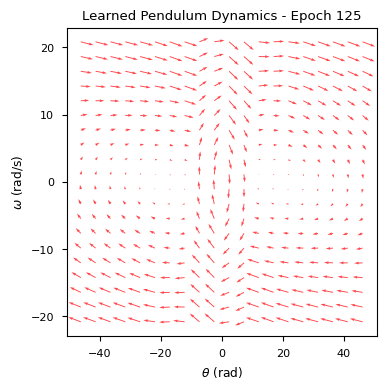

126: 10.412123021739976


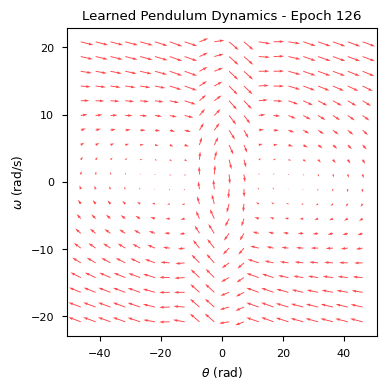

127: 10.3067052151026


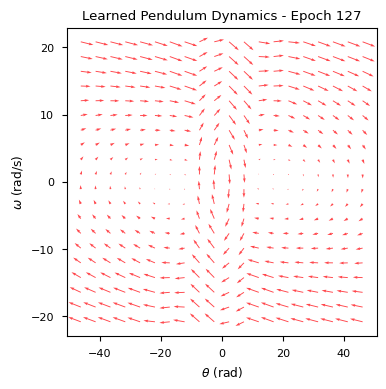

128: 10.21626367857883


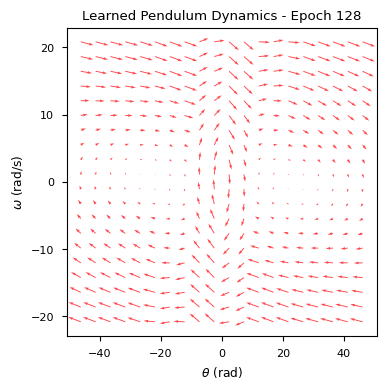

129: 10.2229181269113


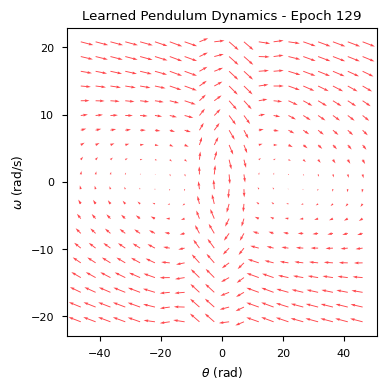

130: 10.10680646369369


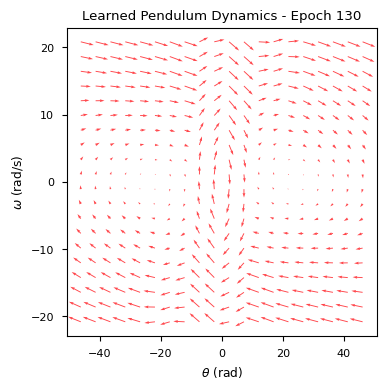

131: 10.101193937291583


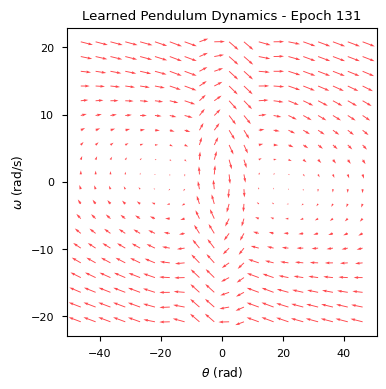

132: 10.185922177909038


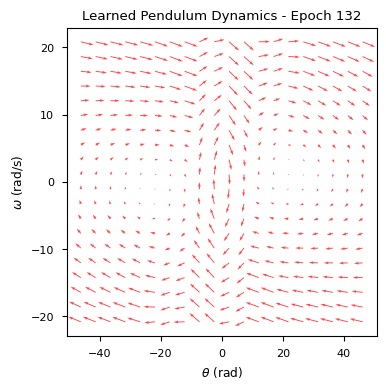

133: 10.133226315273935


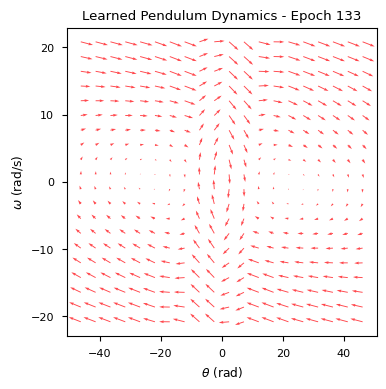

134: 10.102682525676183


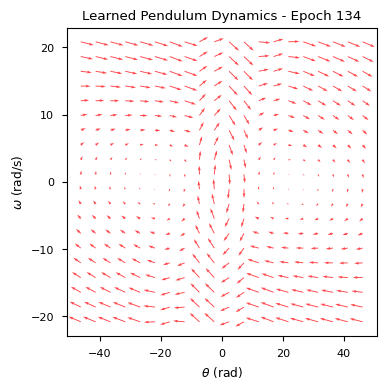

135: 10.068956385320286


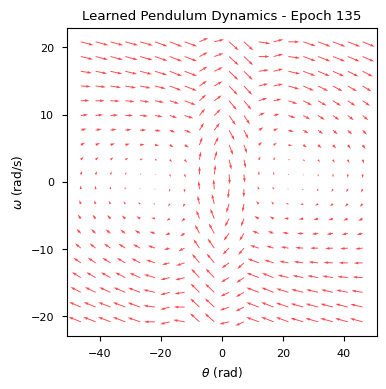

136: 10.006621318380667


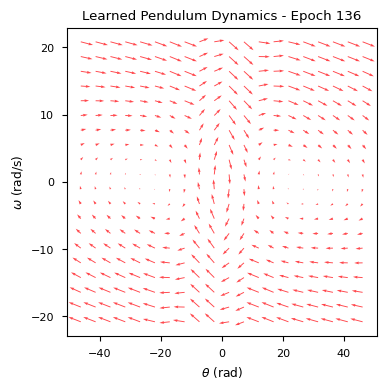

137: 9.910482308397507


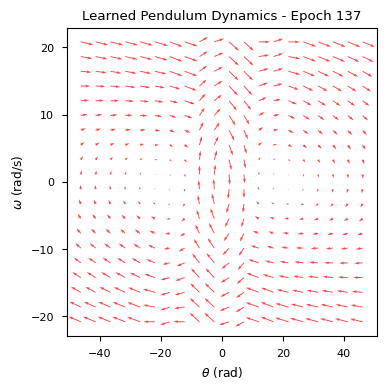

138: 9.823993558684947


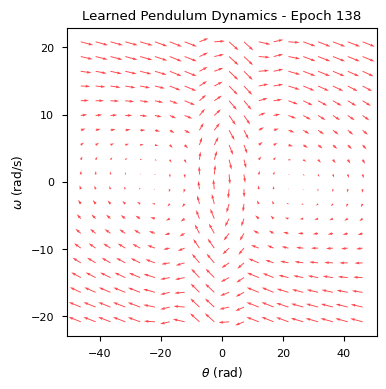

139: 9.882866314259227


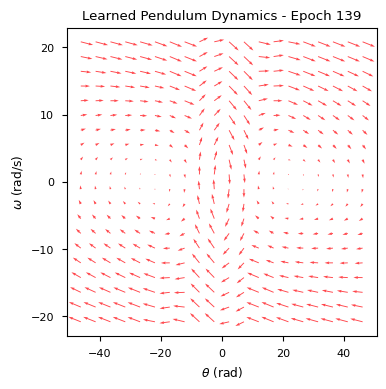

140: 9.847382772310995


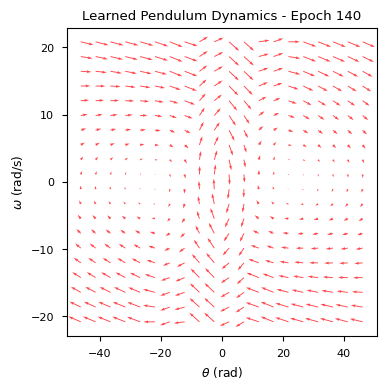

141: 9.770013862540395


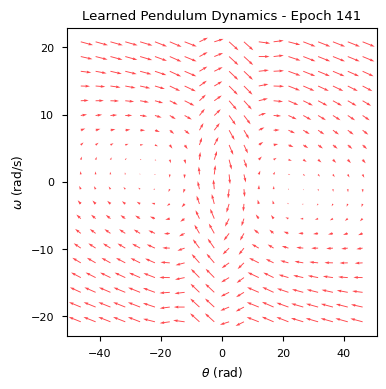

142: 9.737907594366266


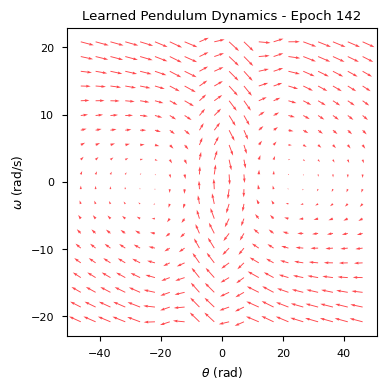

143: 9.676398062347058


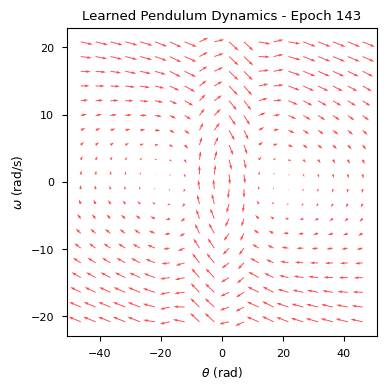

144: 9.609236229744091


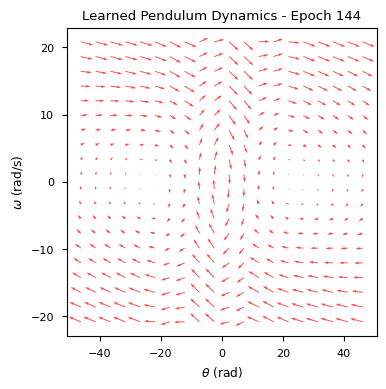

145: 9.520657066503766


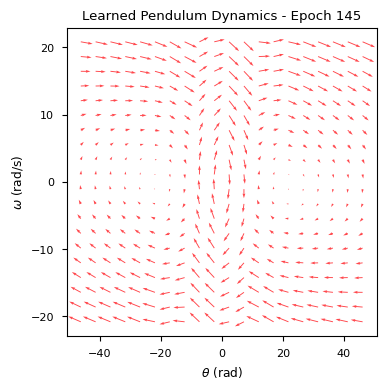

146: 9.44001740006991


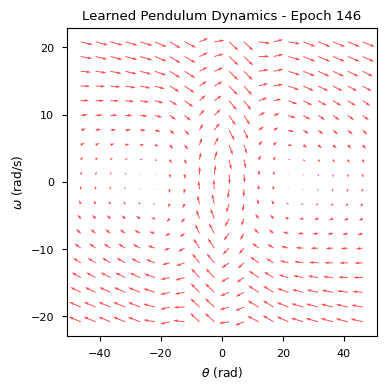

147: 9.39548853771571


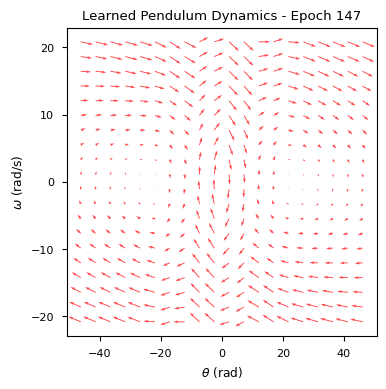

148: 9.450470254122115


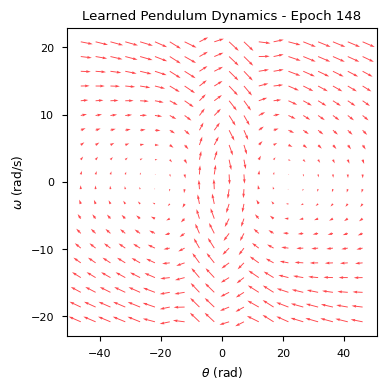

149: 9.295058725164353


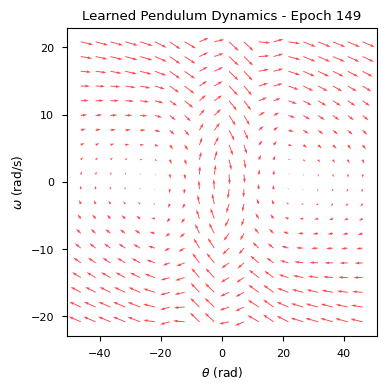

150: 9.276200652960773


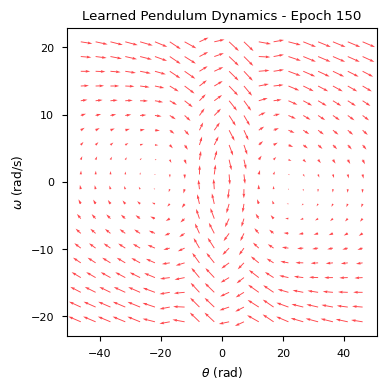

151: 9.376345362287278


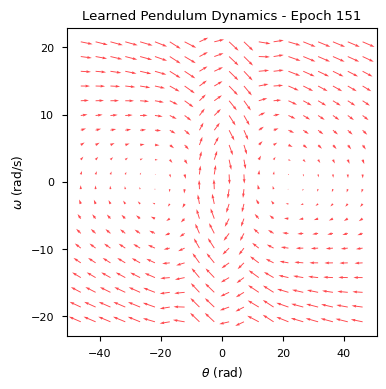

152: 9.319809188042793


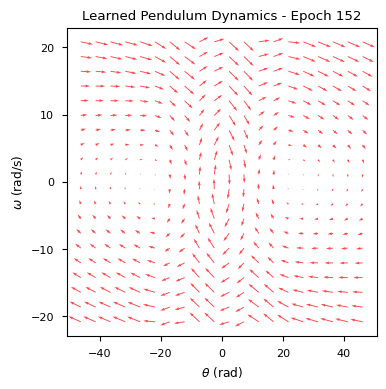

153: 9.319781019648246


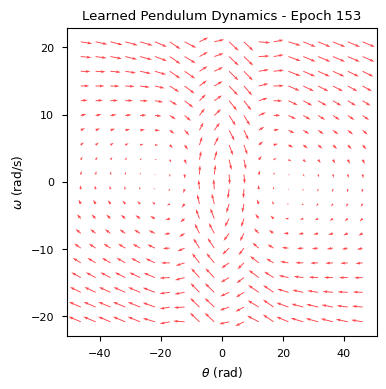

154: 9.23014132305147


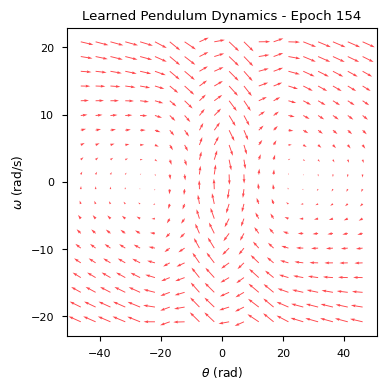

155: 9.22039532685336


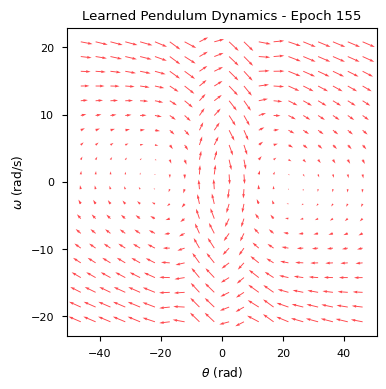

156: 9.10045488311977


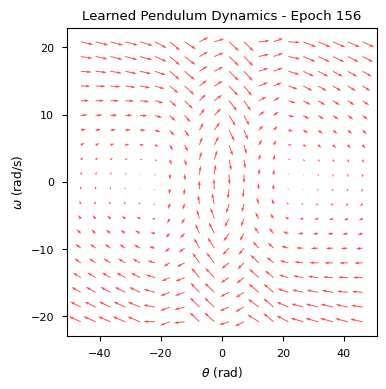

157: 9.140700246236065


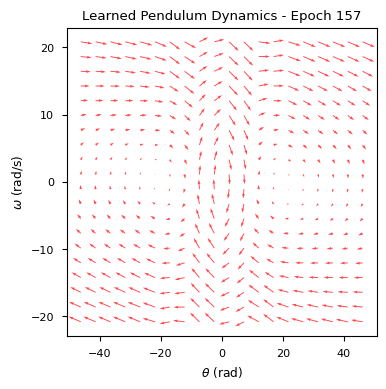

158: 9.023403139013272


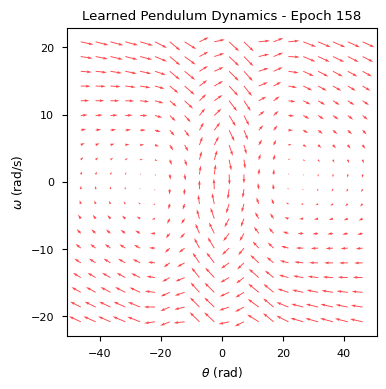

159: 9.134253746567783


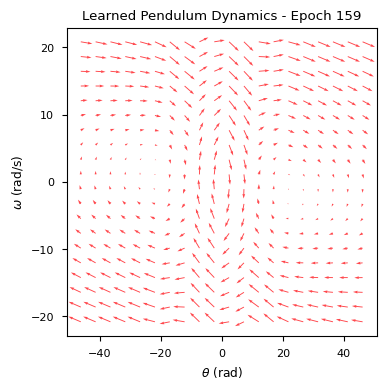

160: 9.034381884153246


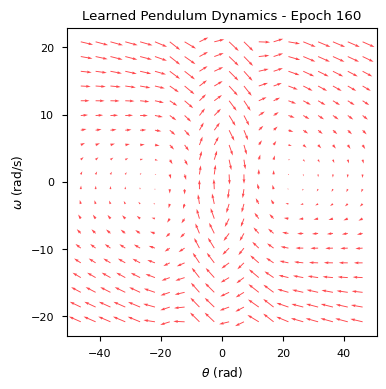

161: 8.969229583366527


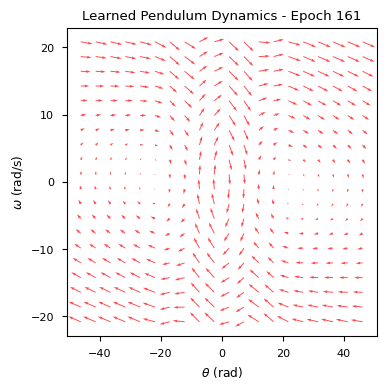

162: 8.928463268015951


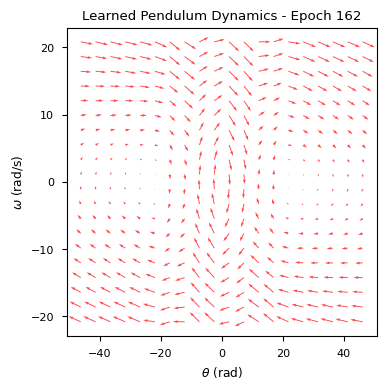

163: 8.914663433178575


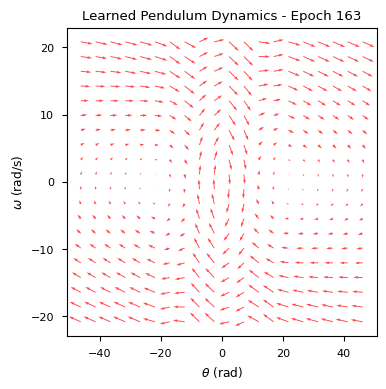

164: 8.925238842805157


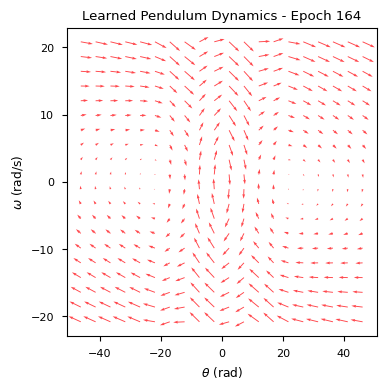

165: 8.859819702281959


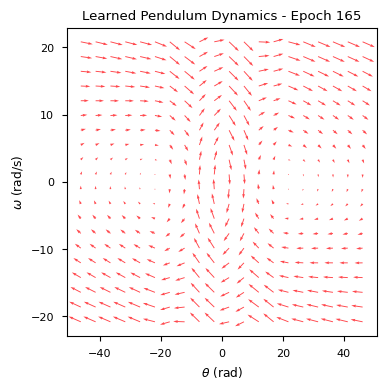

166: 8.781127260398433


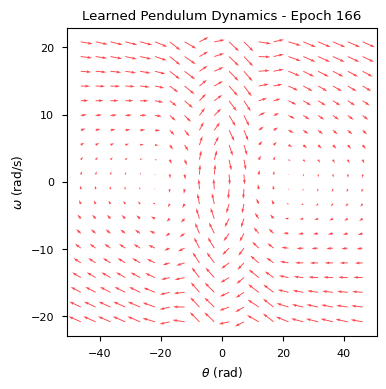

167: 8.81232010965245


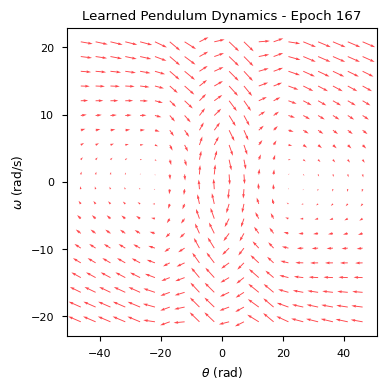

168: 8.777906918366888


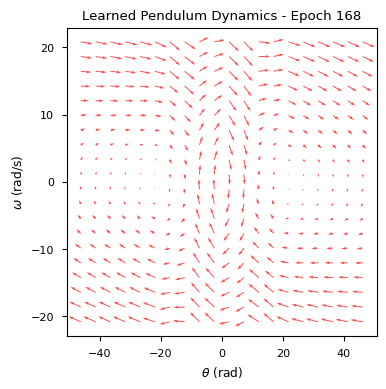

169: 8.740759763824466


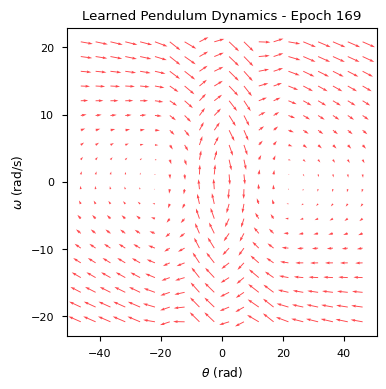

170: 8.722446126696651


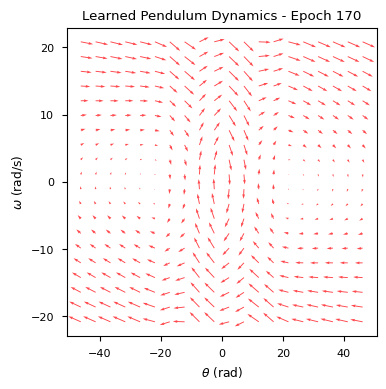

171: 8.674773767504636


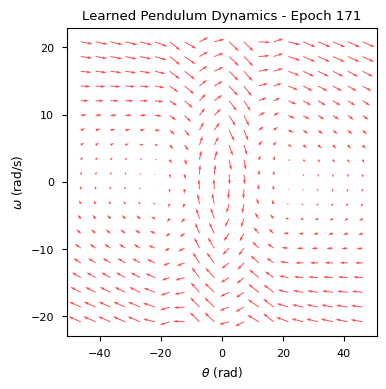

172: 8.636581947500655


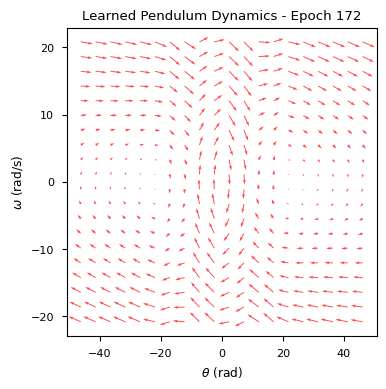

173: 8.609756098339076


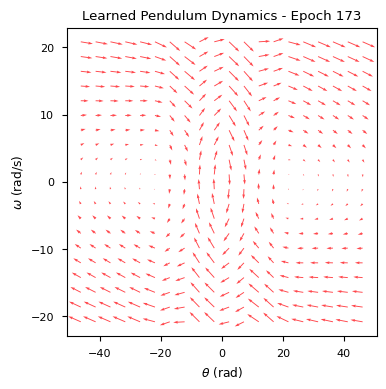

174: 8.656883553969697


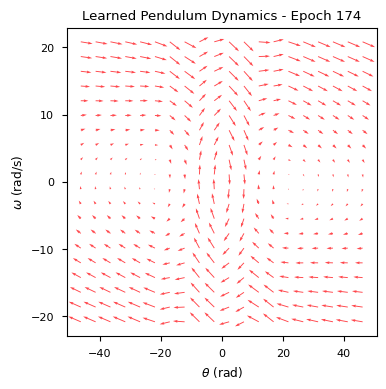

175: 8.623978809119876


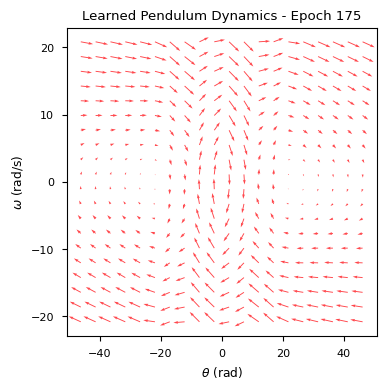

176: 8.643514578519744


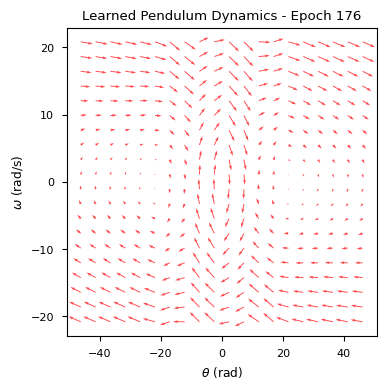

177: 8.543253660300811


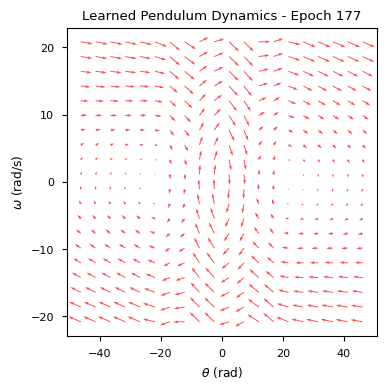

178: 8.532463026924578


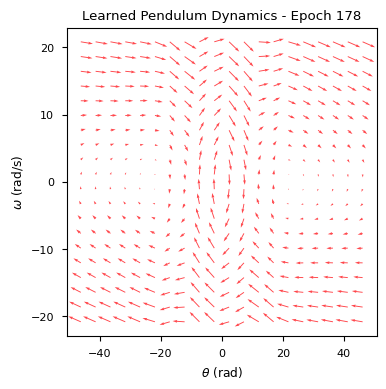

179: 8.483220614912877


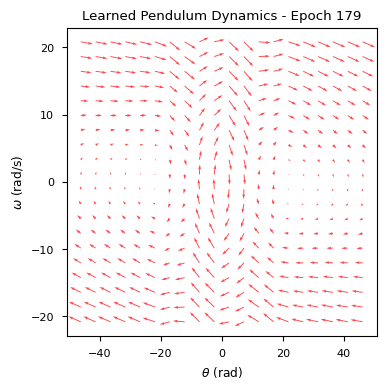

180: 8.483428911268161


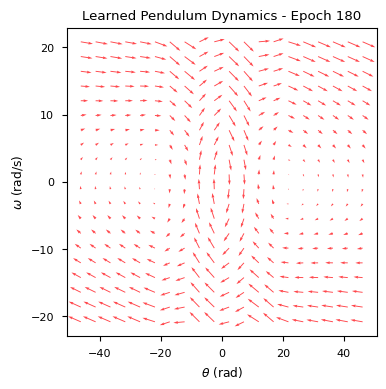

181: 8.540042864554998


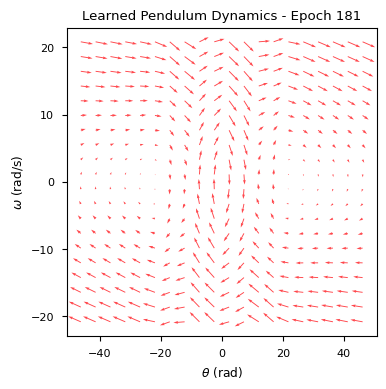

182: 8.420162956628957


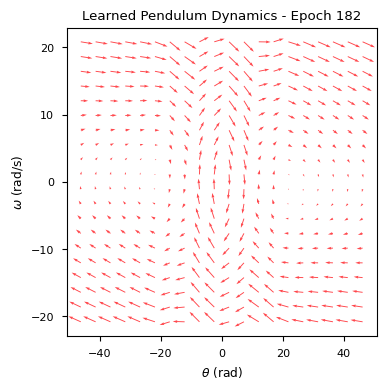

183: 8.42865172778183


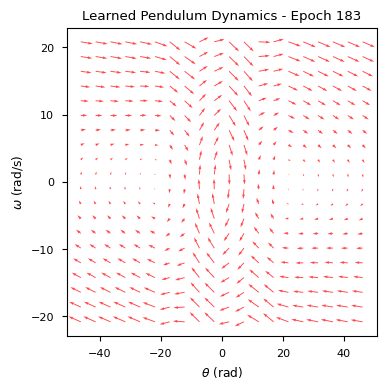

184: 8.42797256863695


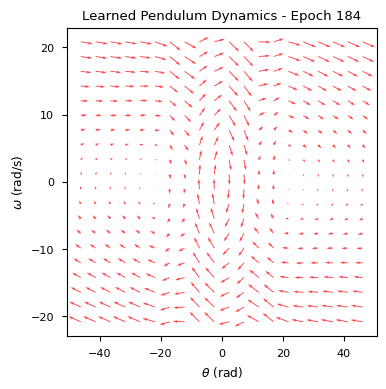

185: 8.342056706533954


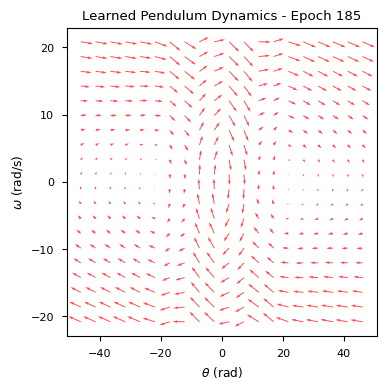

186: 8.3167284138985


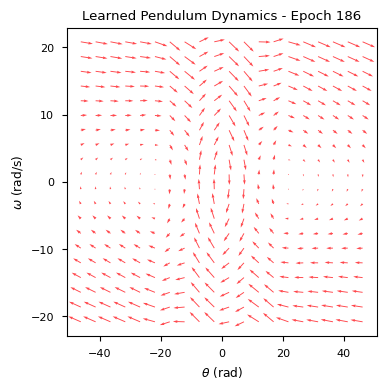

187: 8.363086975708205


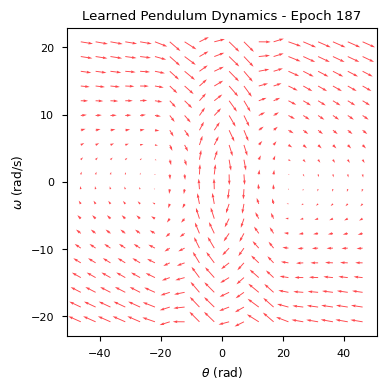

188: 8.399339363667881


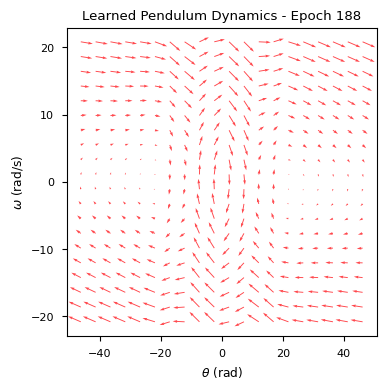

189: 8.363461227649244


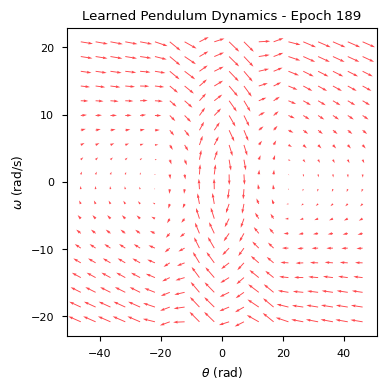

190: 8.339969592879823


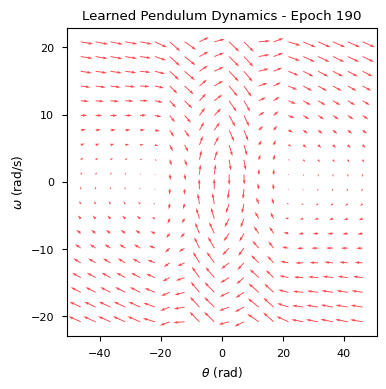

191: 8.327102917847599


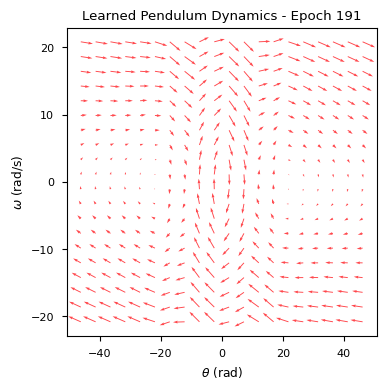

192: 8.247504626507043


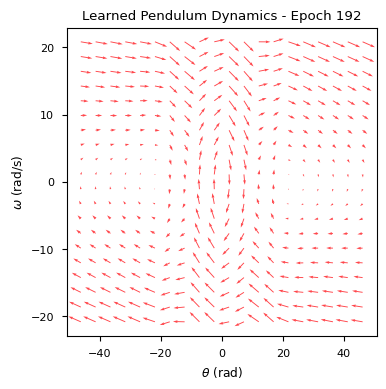

193: 8.274662545925215


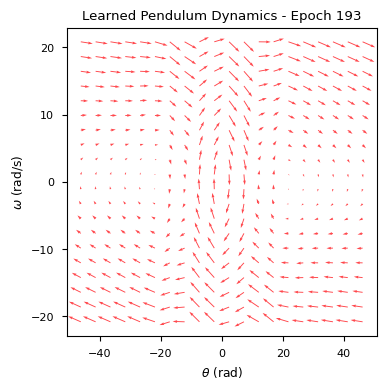

194: 8.290597682600957


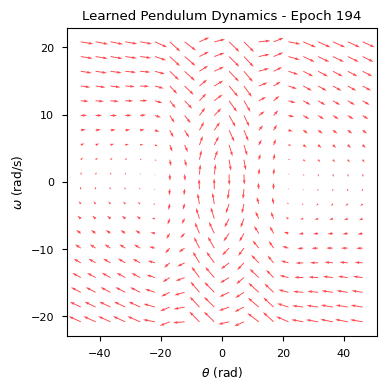

195: 8.455343707162653


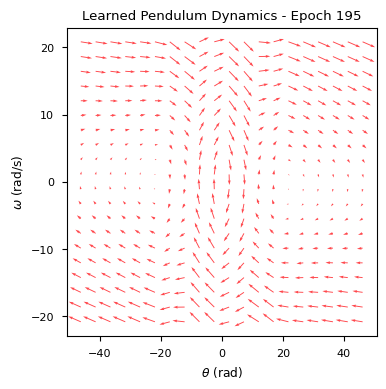

196: 8.309835585944477


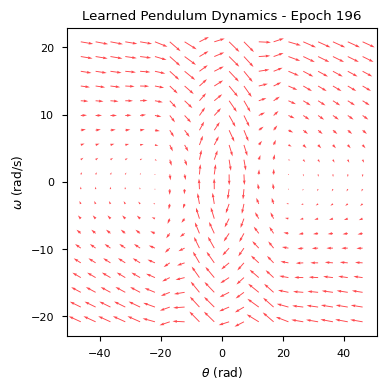

197: 8.280570464010328


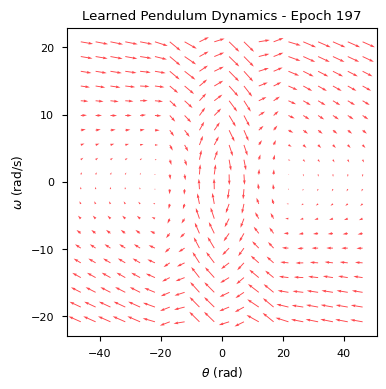

198: 8.29215853183305


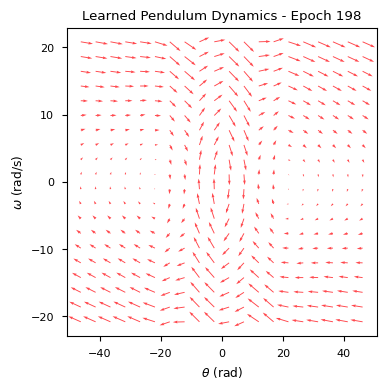

199: 8.27136207785941


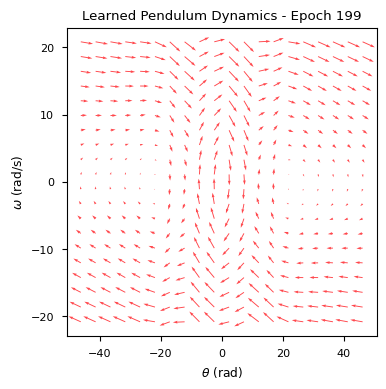

200: 8.243442307353376


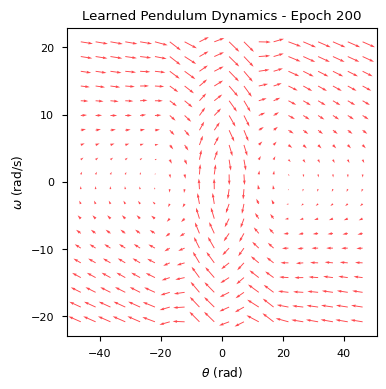

201: 8.262806094387276


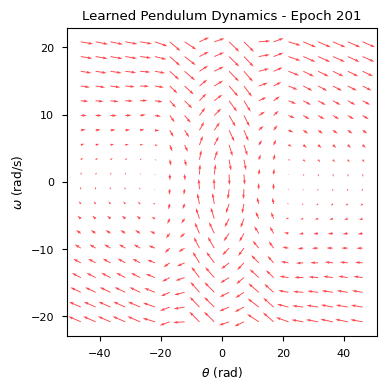

202: 8.226661851383502


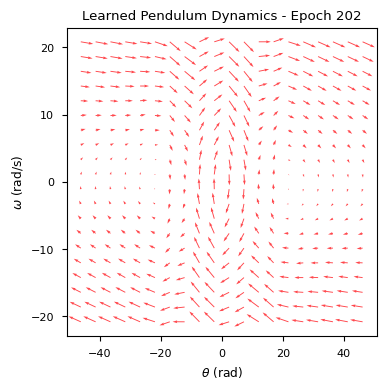

203: 8.156526803934815


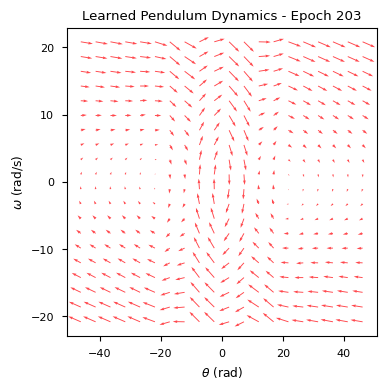

204: 8.167857664634187


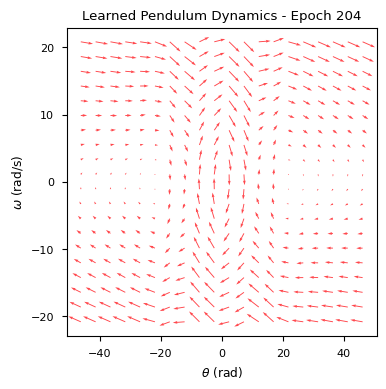

205: 8.145665950686567


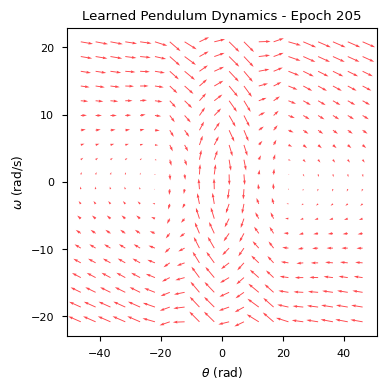

206: 8.120229544036492


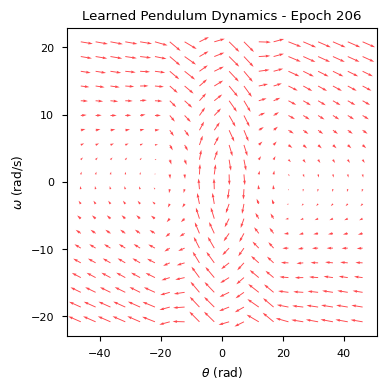

207: 8.164829212937086


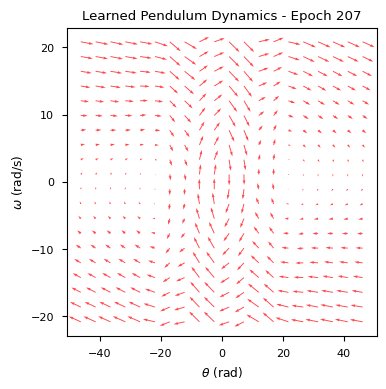

208: 8.215725810450914


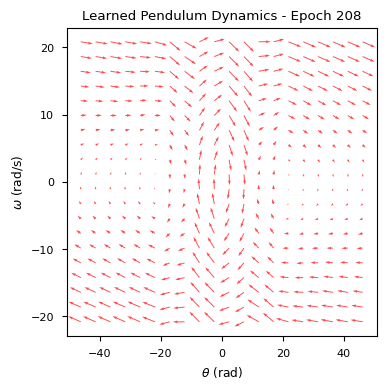

209: 8.17367632584467


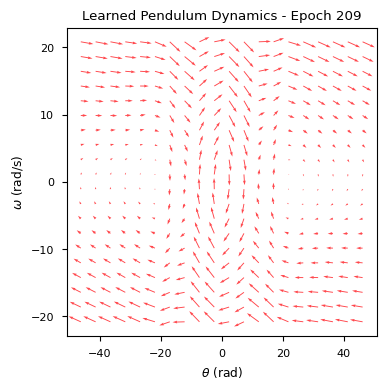

210: 8.161651477567352


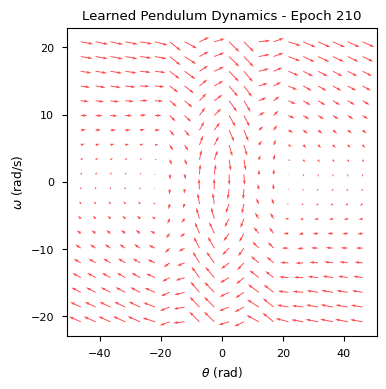

211: 8.074156010639417


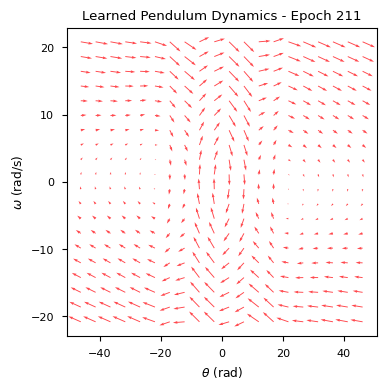

212: 8.068243164483762


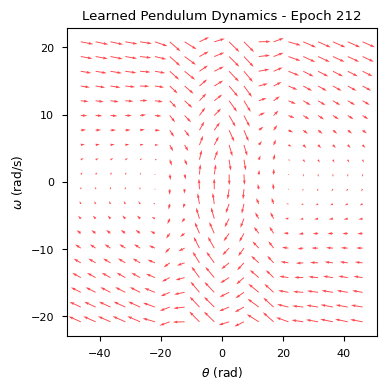

213: 8.062966108312077


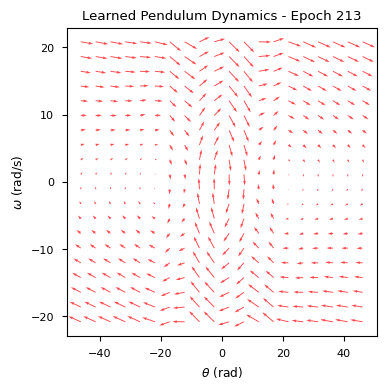

214: 8.085846249271956


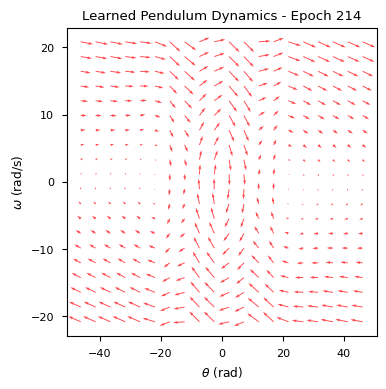

215: 8.086644561510978


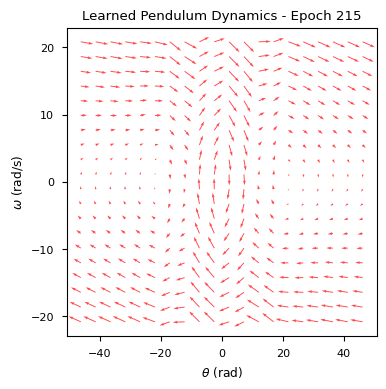

216: 8.108898317499383


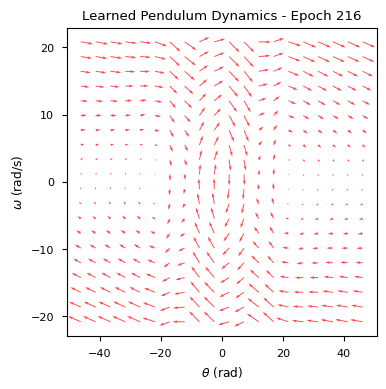

217: 8.044830959640521


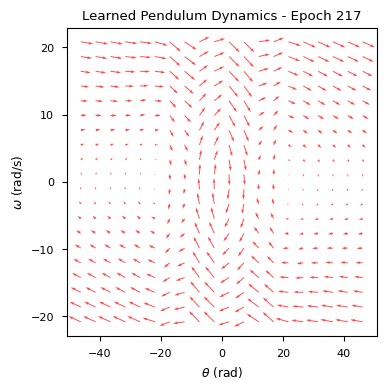

218: 8.073206432729965


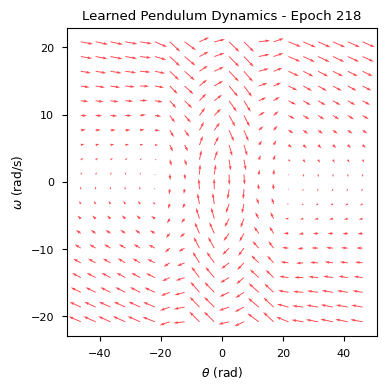

219: 8.086491771808703


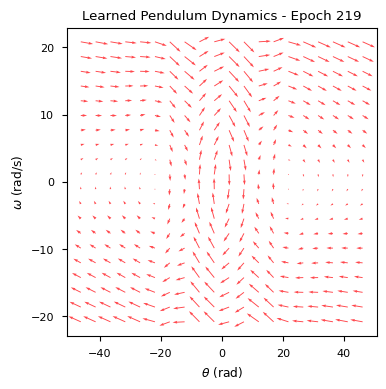

220: 8.048121968573058


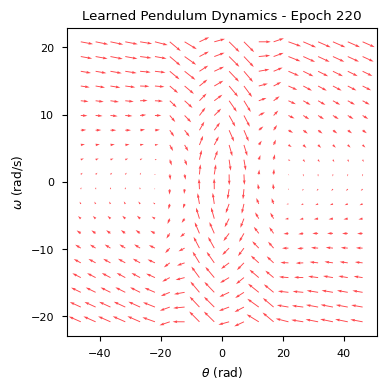

221: 8.029507213037384


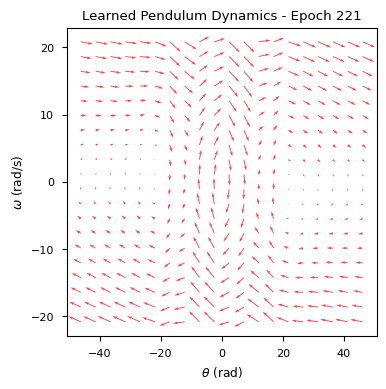

222: 8.021890345197752


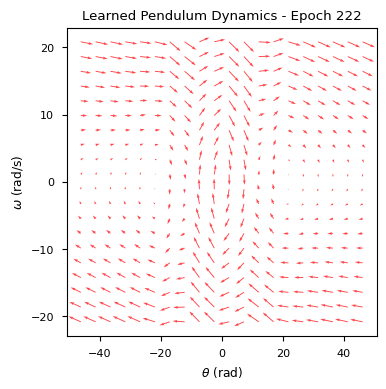

223: 8.022355129377846


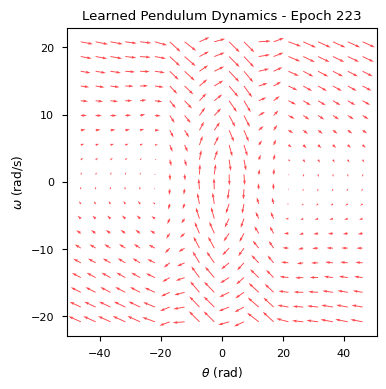

224: 7.985514130718646


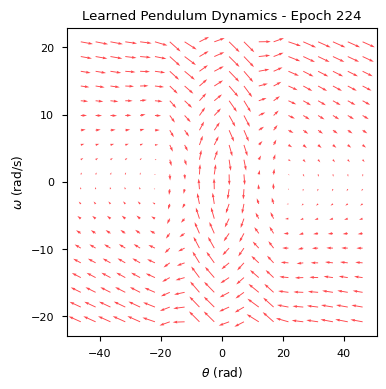

225: 7.888566604148445


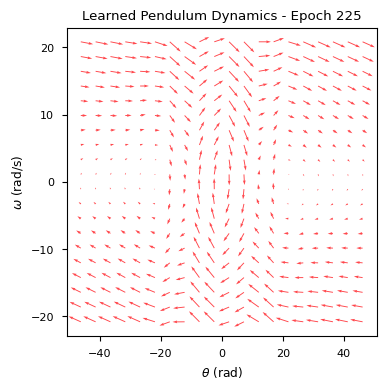

226: 7.8454905896205975


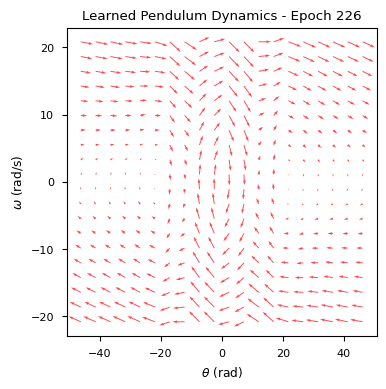

227: 7.873499640094851


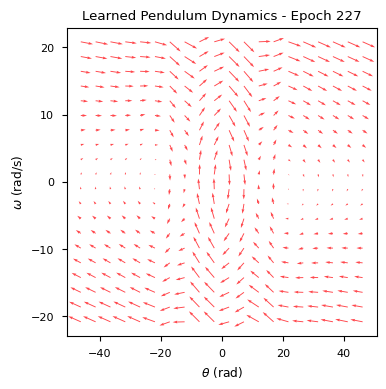

228: 7.8635931660578695


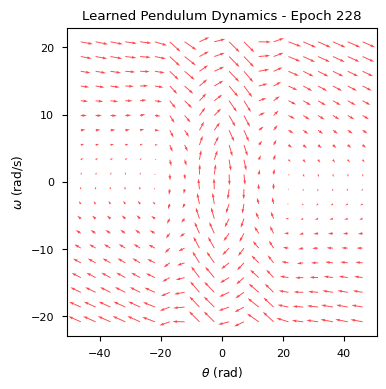

229: 7.815034243930987


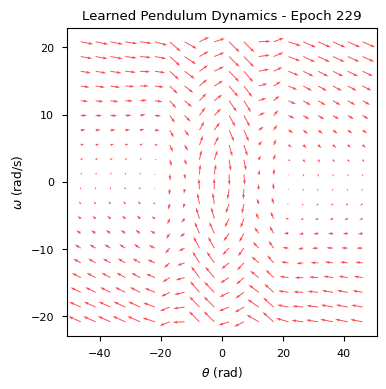

230: 7.793669929990155


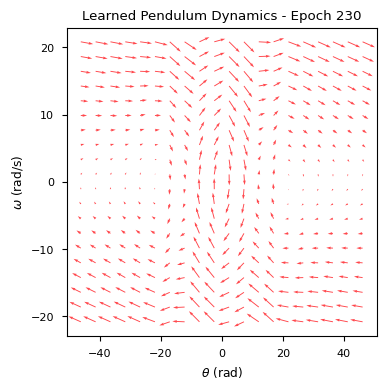

231: 7.815664301166416


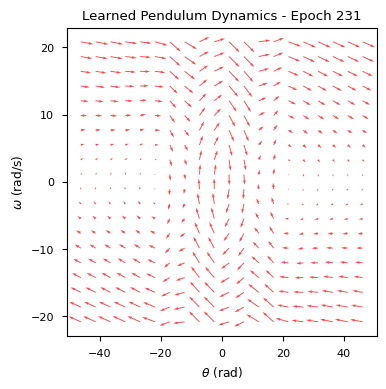

232: 7.791614669932862


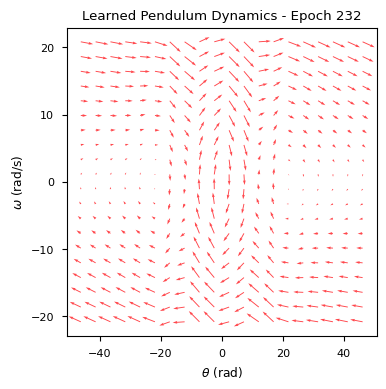

233: 7.792133854809714


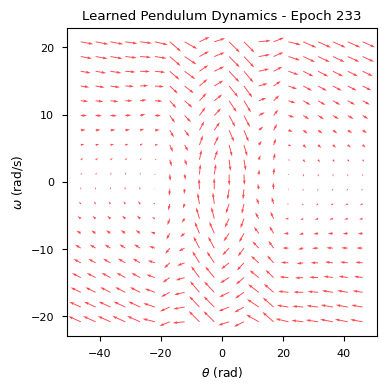

234: 7.790610914310356


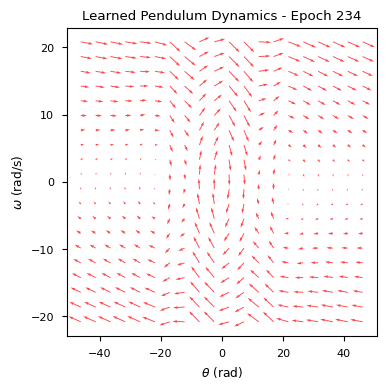

235: 7.773538965586017


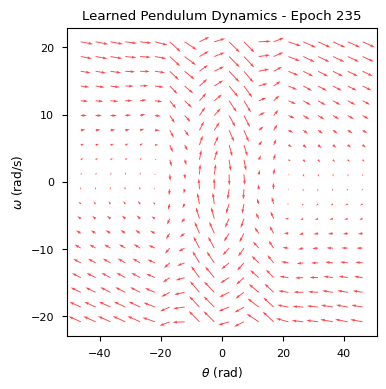

236: 7.722003189527318


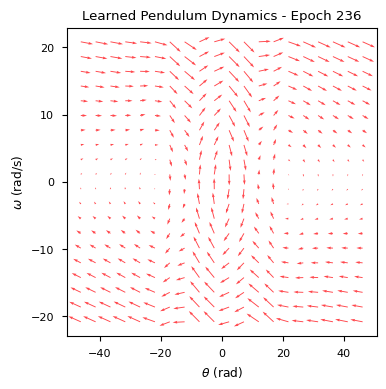

237: 7.750892954859789


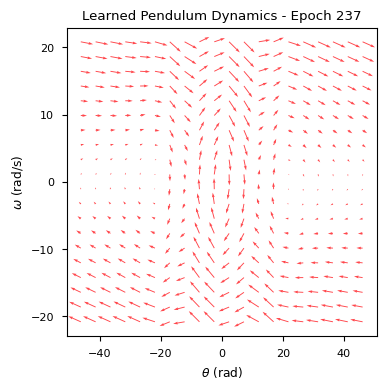

238: 7.7868127561062845


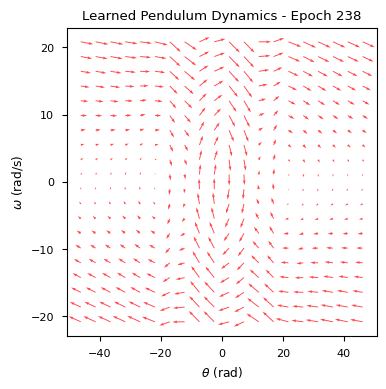

239: 7.800885899728401


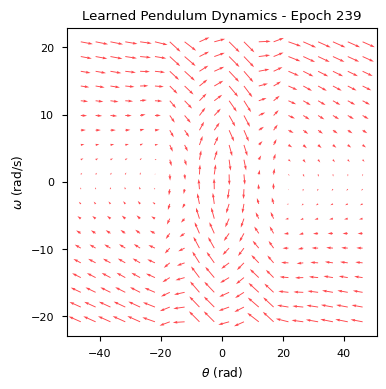

240: 7.767125871575309


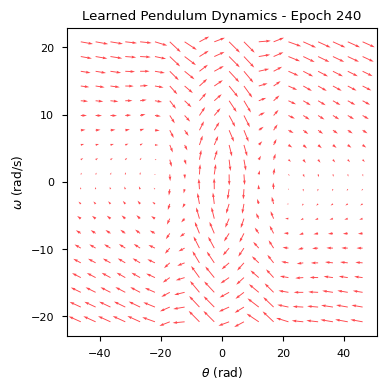

241: 7.748341361183541


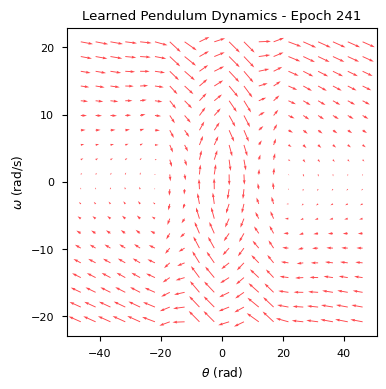

242: 7.671668813688958


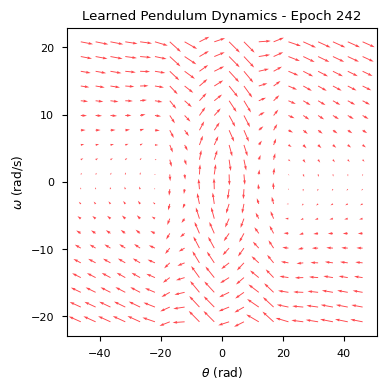

243: 7.6547353779232505


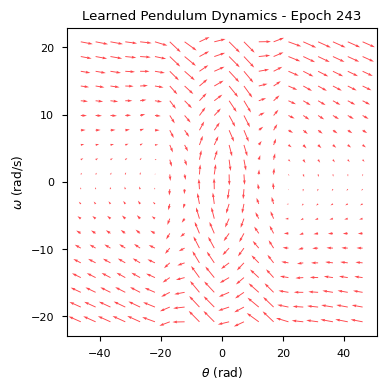

244: 7.64840653206039


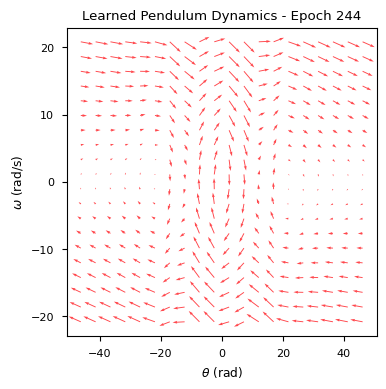

245: 7.628293860978035


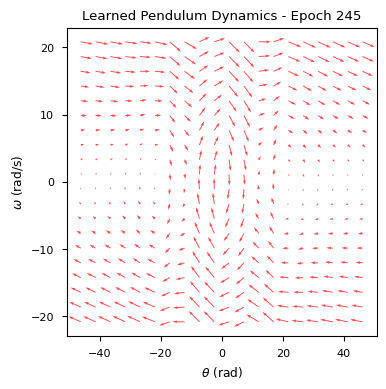

246: 7.707047339962586


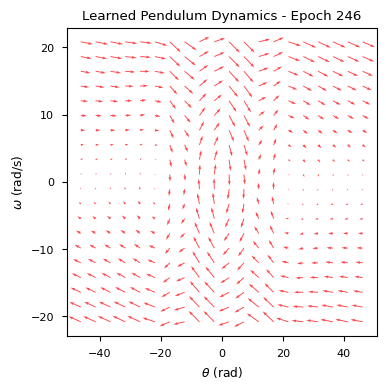

247: 7.7153942843915795


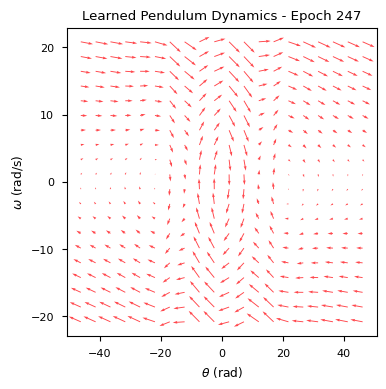

248: 7.668046771667982


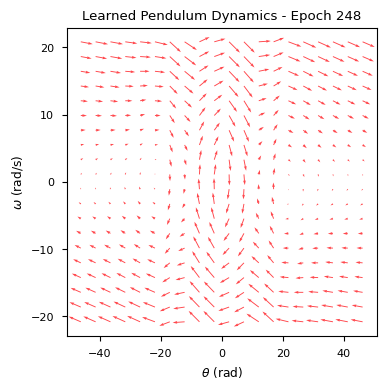

249: 7.617147170181438


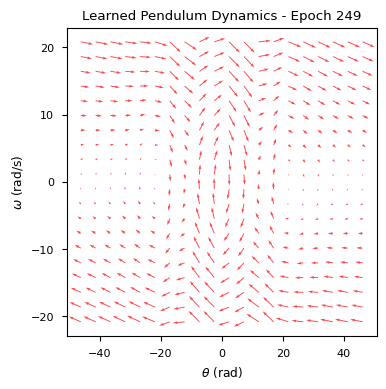

250: 7.595065653767319


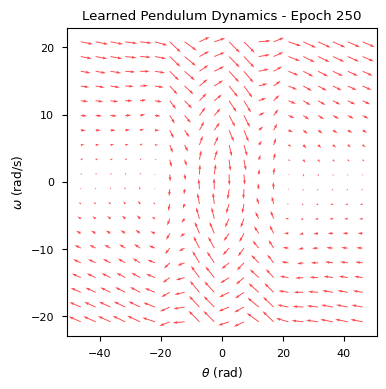

251: 7.612550977545217


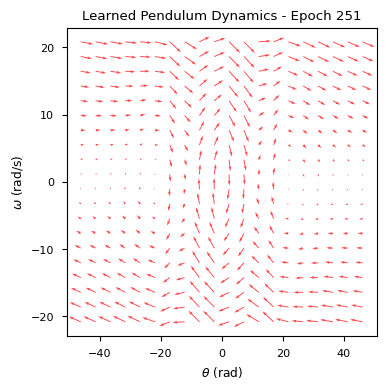

252: 7.575572057824167


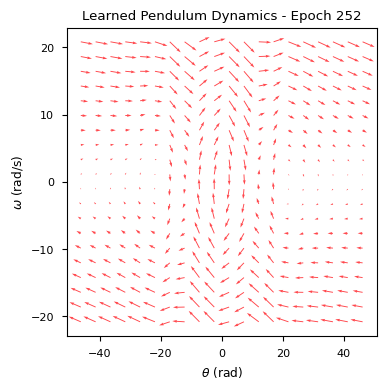

253: 7.5563568833740336


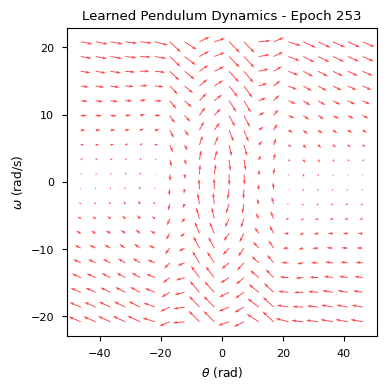

254: 7.580861921894103


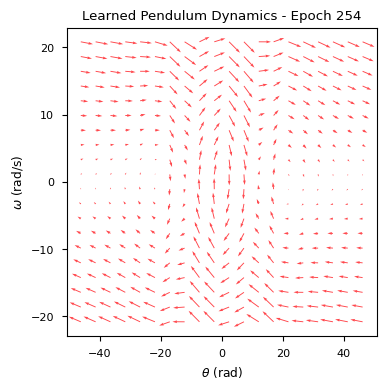

255: 7.620821411876659


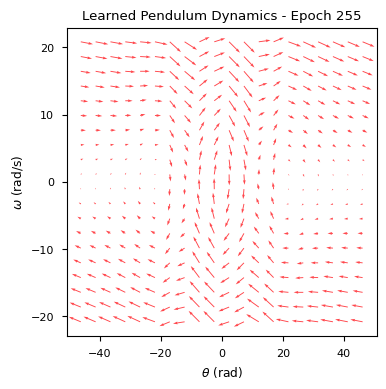

256: 7.57961092054513


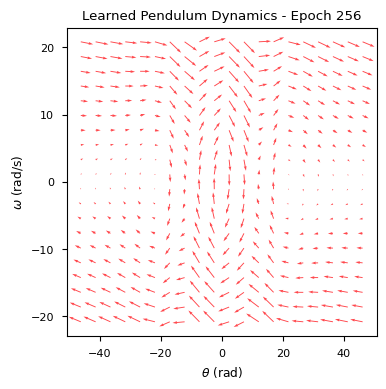

257: 7.613139713441938


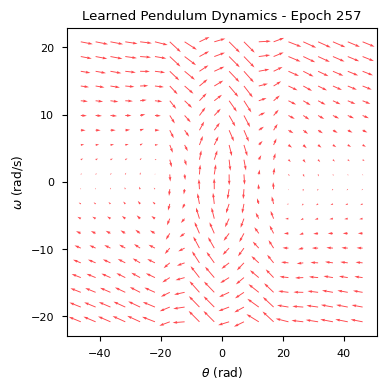

258: 7.537838017894659


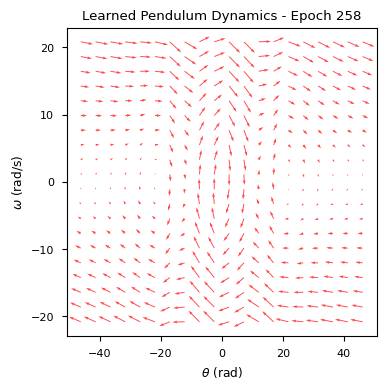

259: 7.5444778582777285


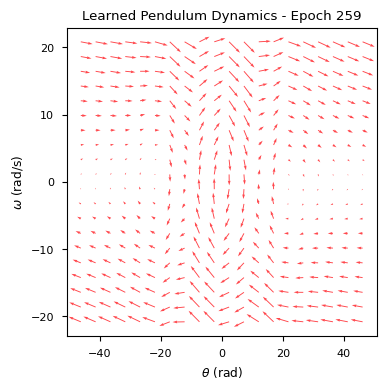

260: 7.502054657574511


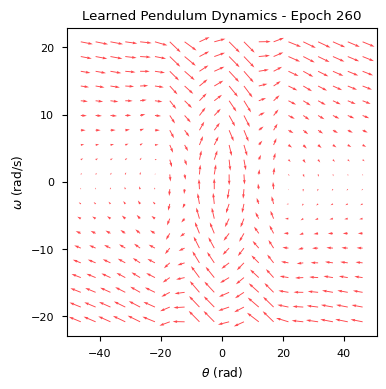

261: 7.477980991473434


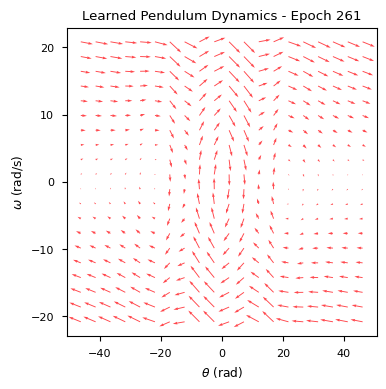

262: 7.547464969224659


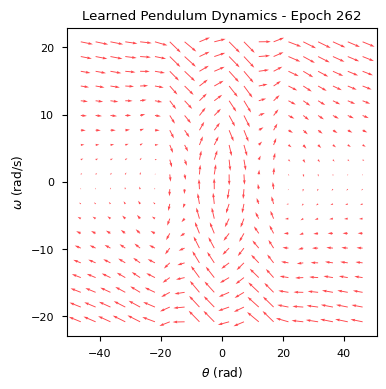

263: 7.621733772071236


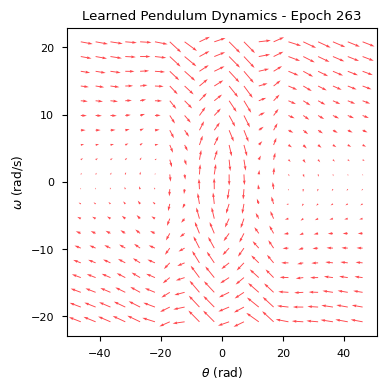

264: 7.5493286133237


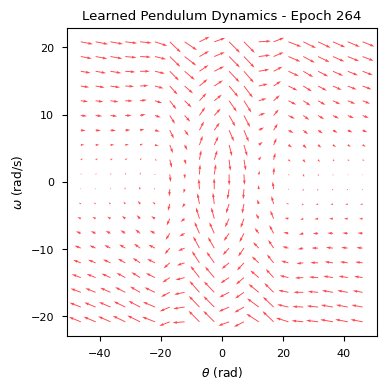

265: 7.544813830677099


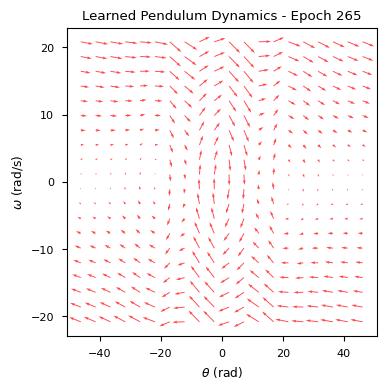

266: 7.546205161799372


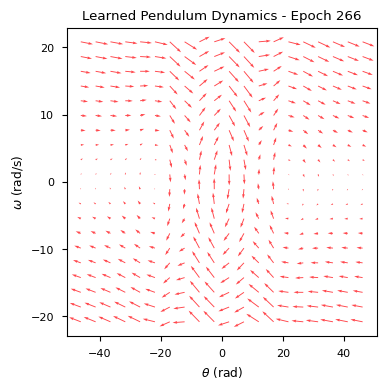

267: 7.473839744810721


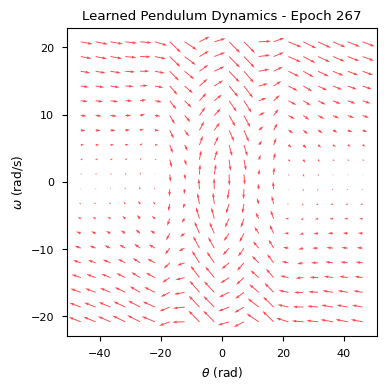

268: 7.437768604000771


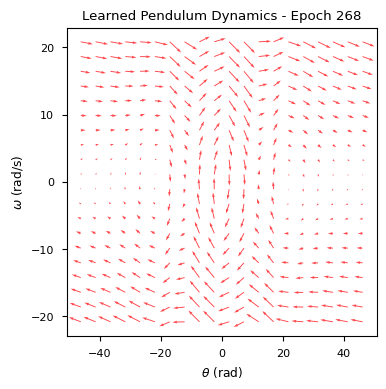

269: 7.42304103671982


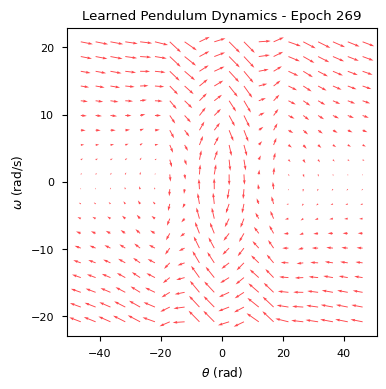

270: 7.36487778246015


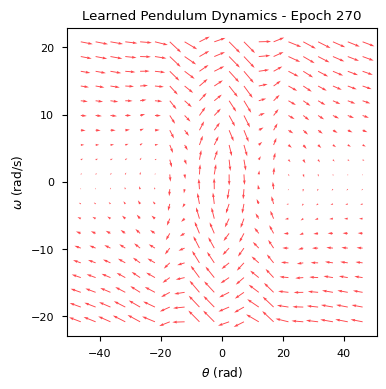

271: 7.349147376141133


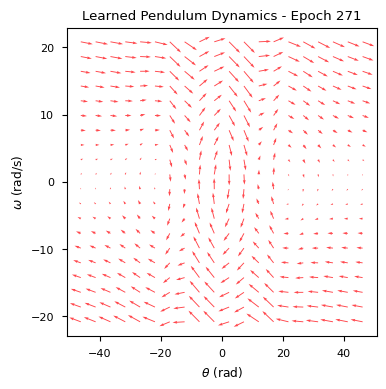

272: 7.338468315149142


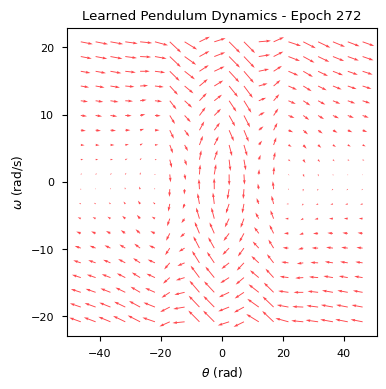

273: 7.327089163299878


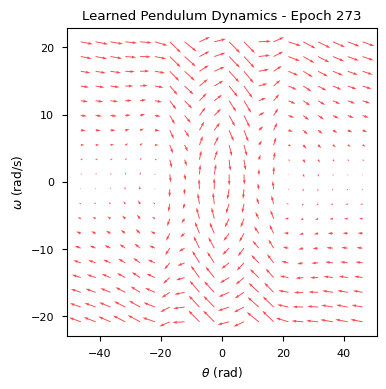

274: 7.451442917011094


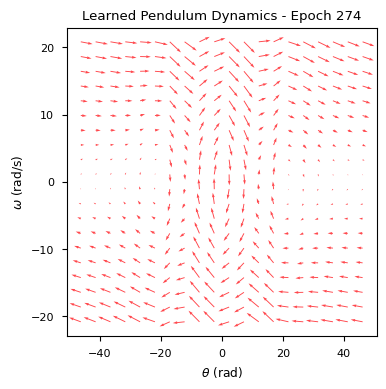

275: 7.395301502075718


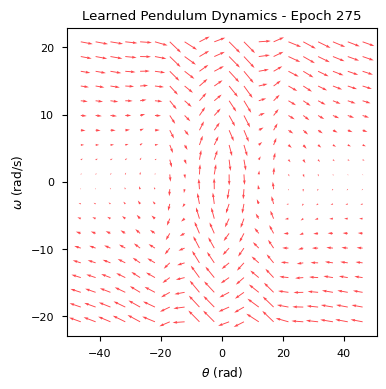

276: 7.428877482781058


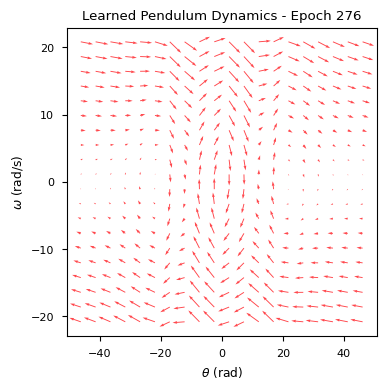

277: 7.350739688234088


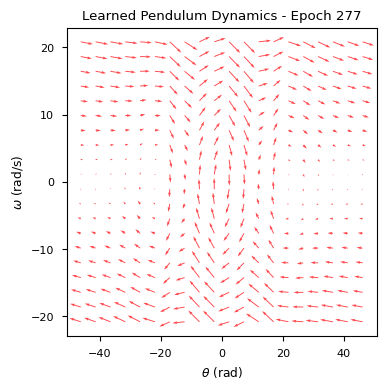

278: 7.319595763441047


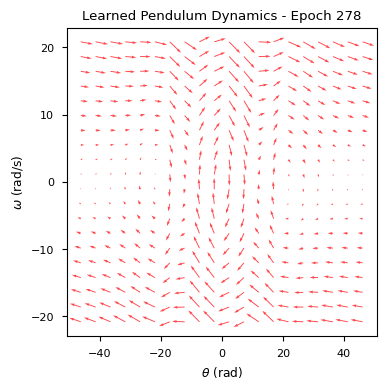

279: 7.323752123731747


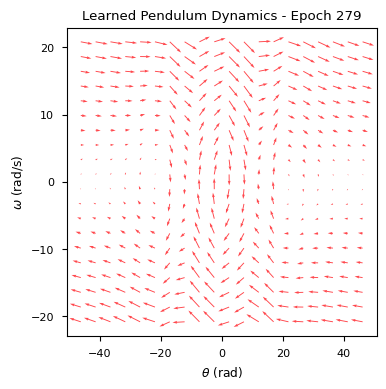

280: 7.260247937793918


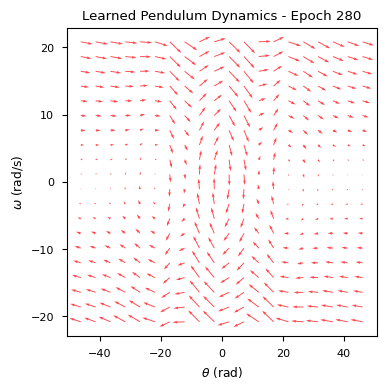

281: 7.22835052767719


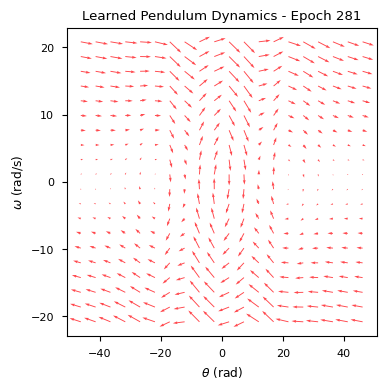

282: 7.183263551345678


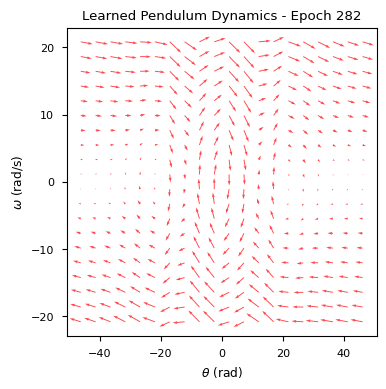

283: 7.151979548843702


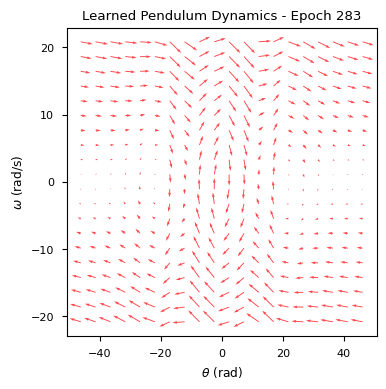

284: 7.1650274453373255


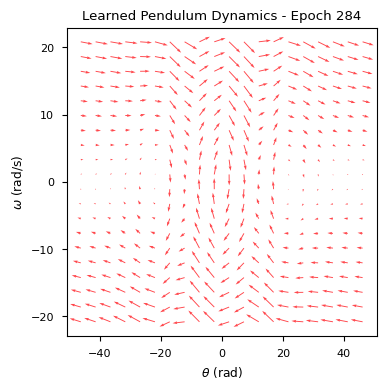

285: 7.2602289070629755


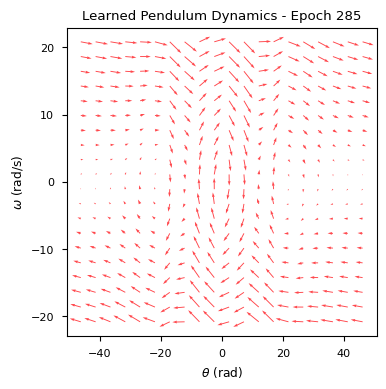

286: 7.214602047908137


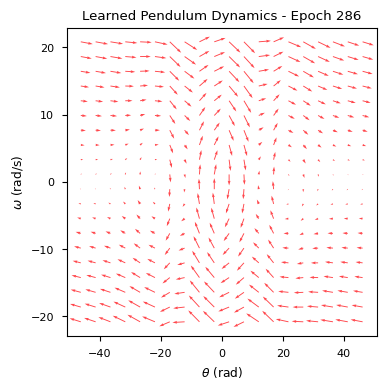

287: 7.218624076227445


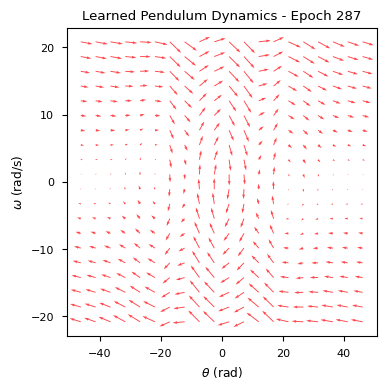

288: 7.182421229308012


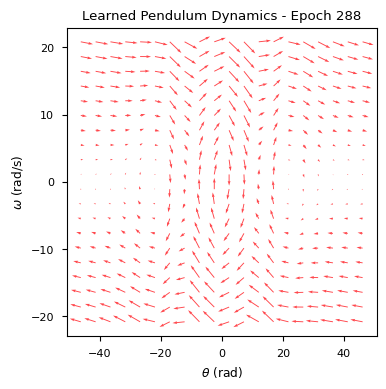

289: 7.183388301737566


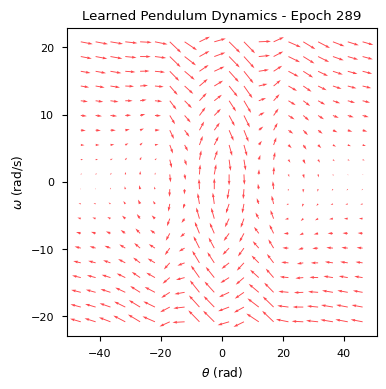

290: 7.170085253662777


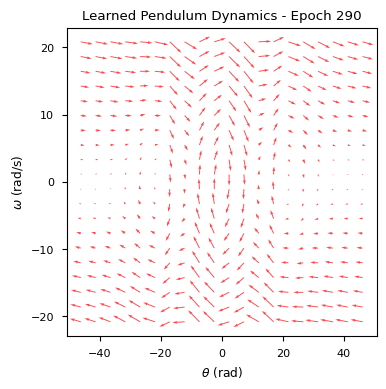

291: 7.161447742192237


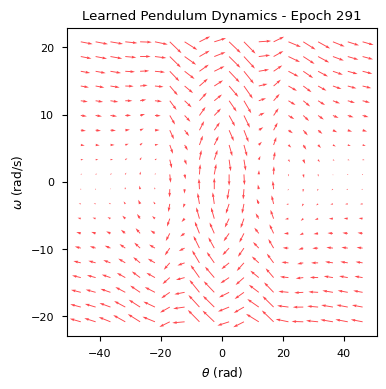

292: 7.146347502794928


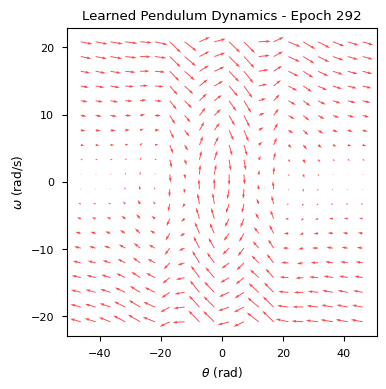

293: 7.149688687747172


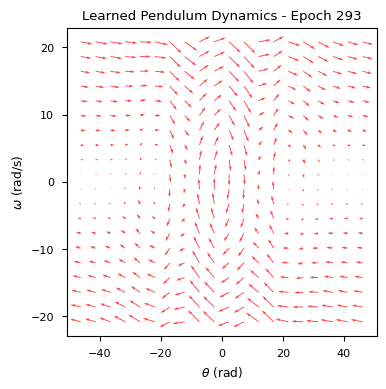

294: 7.114721805333248


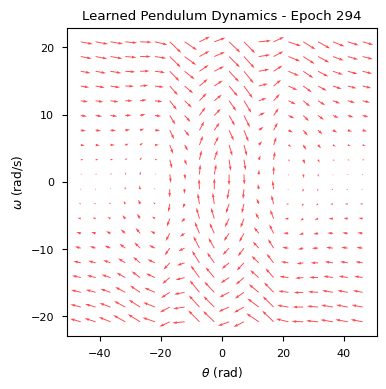

295: 7.044097847394332


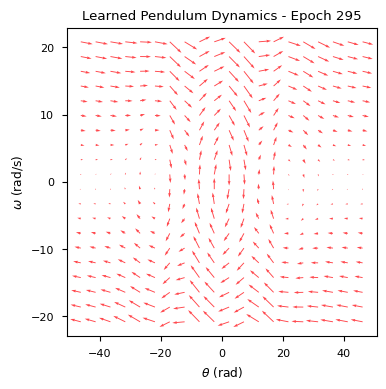

296: 7.045138012301864


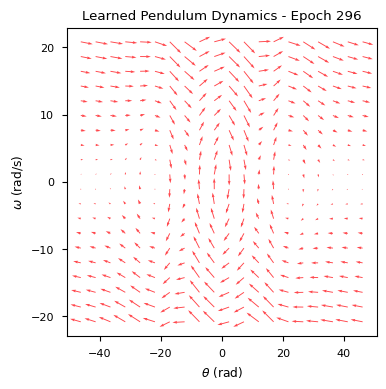

297: 7.182992443152221


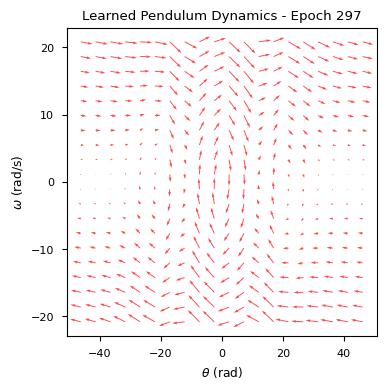

298: 7.1895417195322215


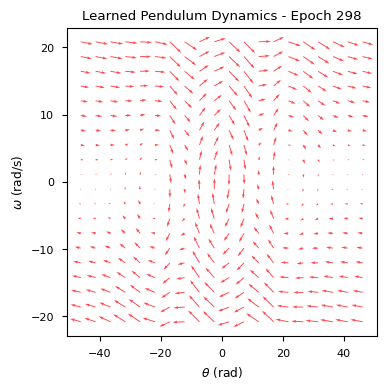

299: 7.170866552965314


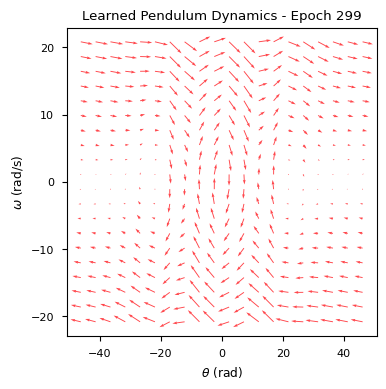

300: 7.158881444632841


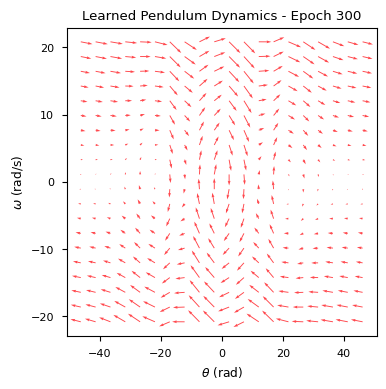

301: 7.101513676007651


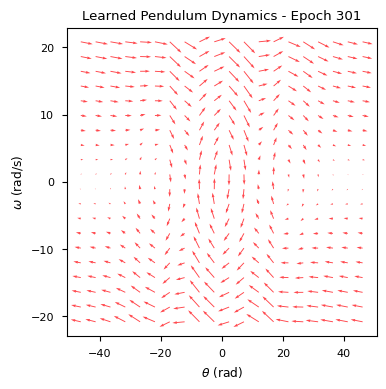

302: 7.135775920339026


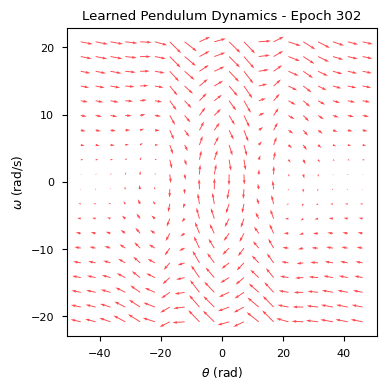

303: 7.041831289712761


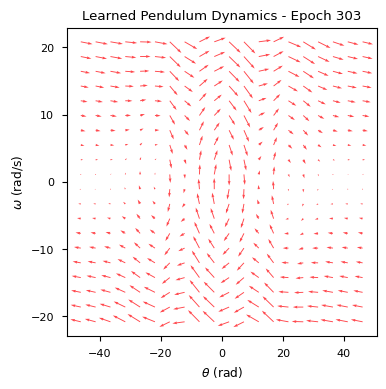

304: 7.085030614599866


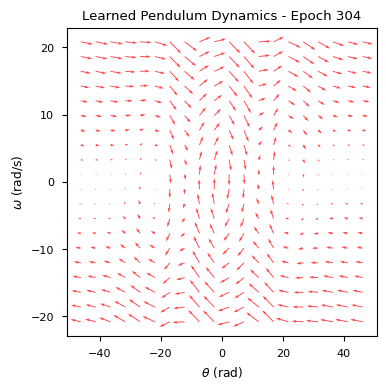

305: 7.046456254092851


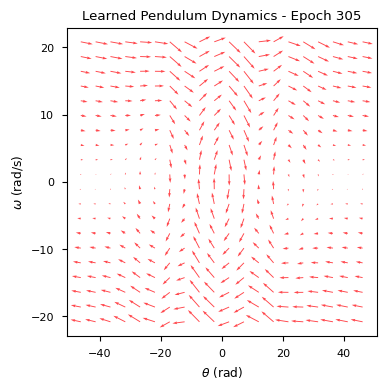

306: 7.078394874485431


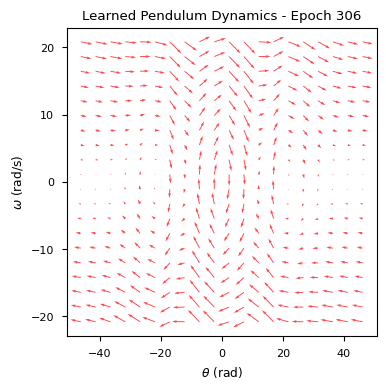

307: 6.910722170400435


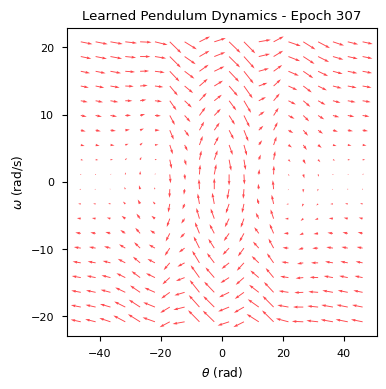

308: 6.850506433181472


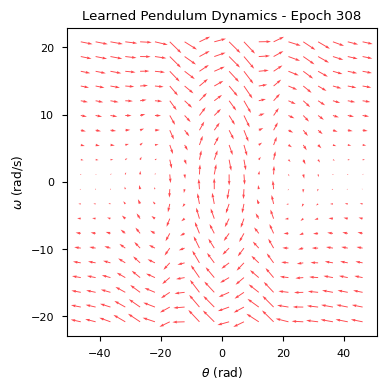

309: 6.856236804873532


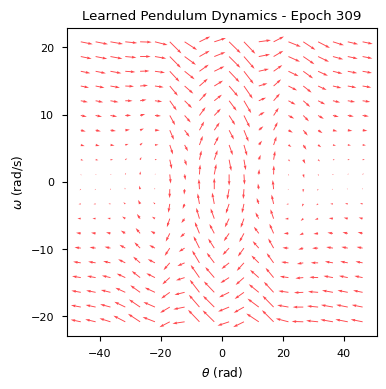

310: 6.831542918155294


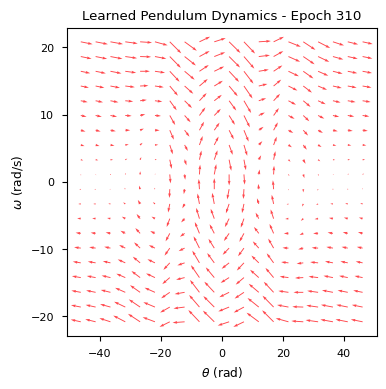

311: 6.821290416519725


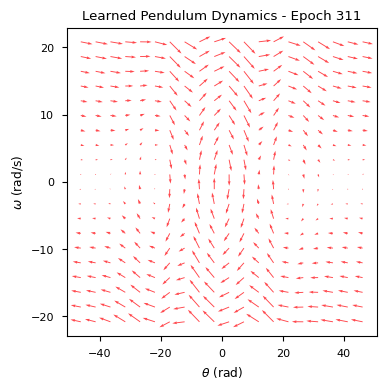

312: 6.863284284424089


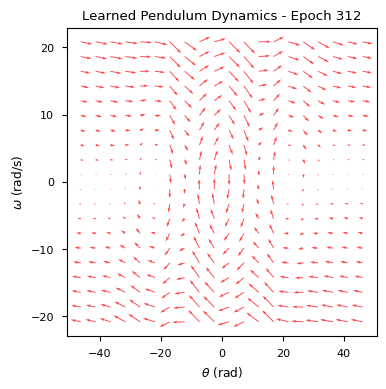

313: 6.84852174144386


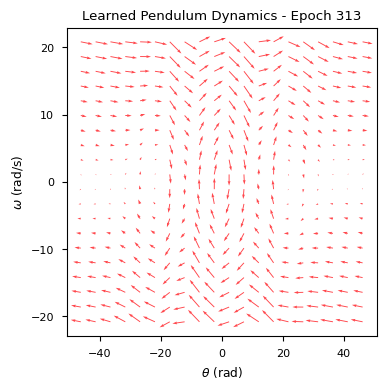

314: 6.854382033881458


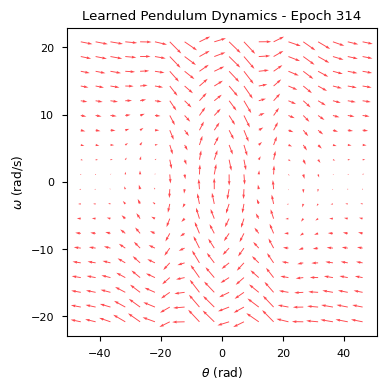

315: 6.804613597852954


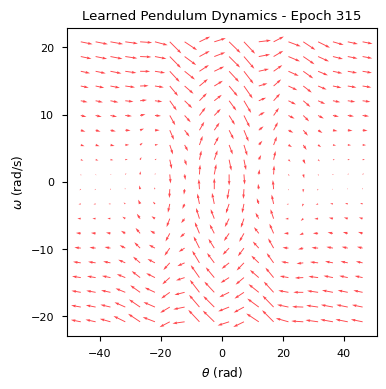

316: 6.8048286281986154


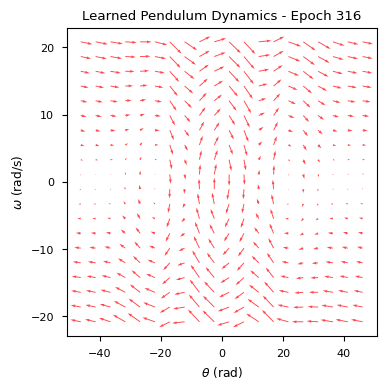

317: 6.800110416264242


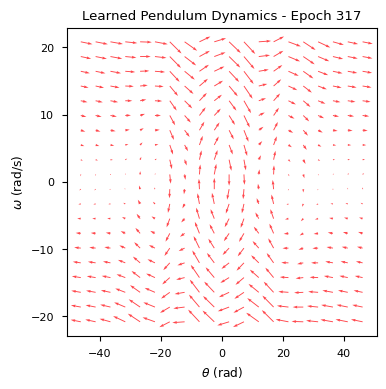

318: 6.755157919913006


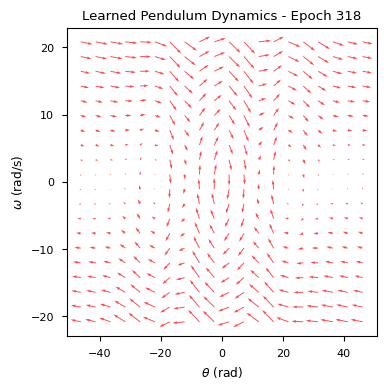

319: 6.802081169539252


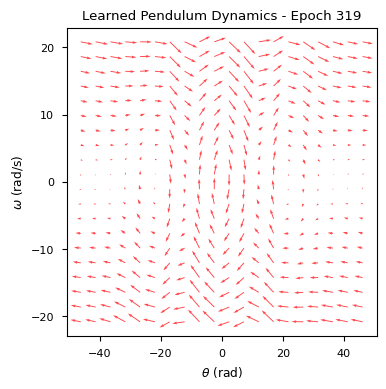

320: 6.746075222213534


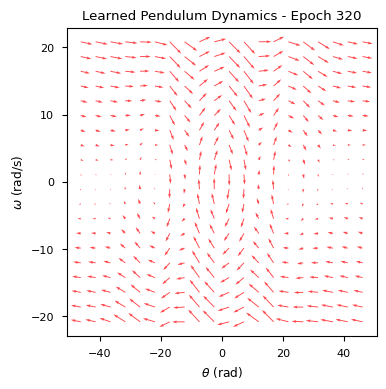

321: 6.683376701467475


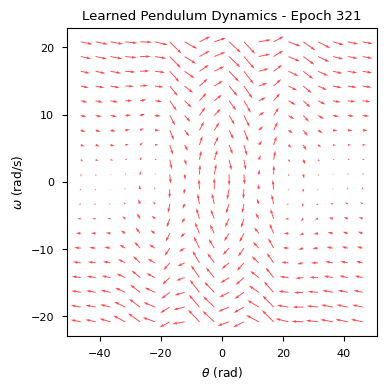

322: 6.636857169613905


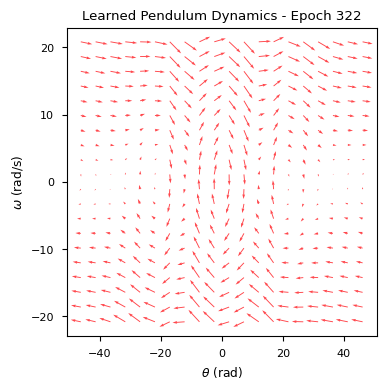

323: 6.72995068566576


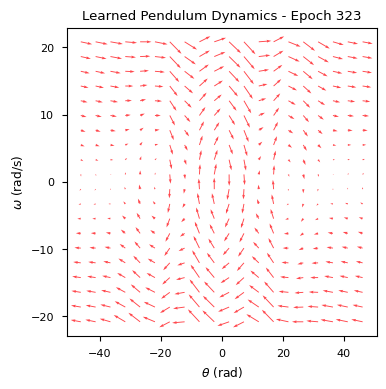

324: 6.68411494037962


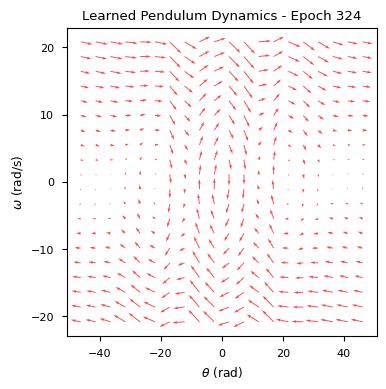

325: 6.656824181542372


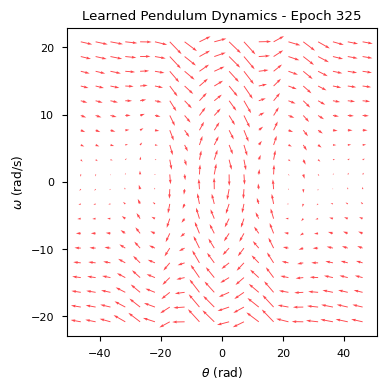

326: 6.693045247383418


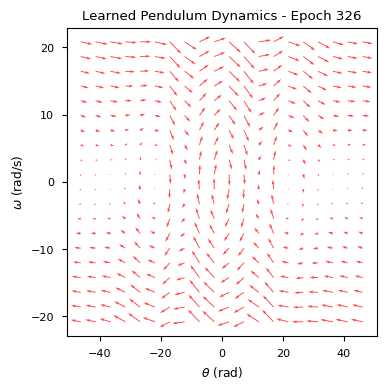

327: 6.61117979076763


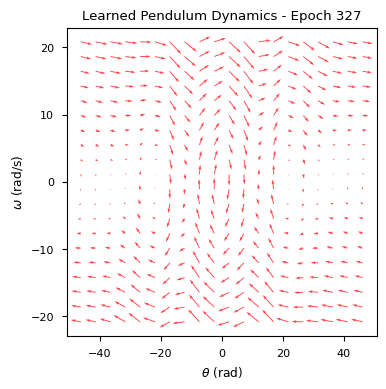

328: 6.5924503270978425


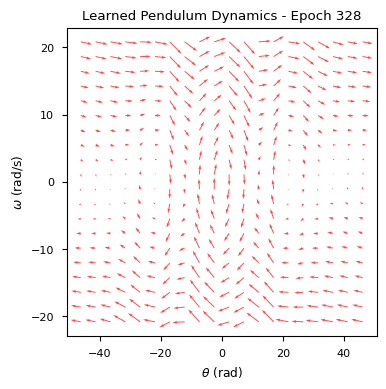

329: 6.640138970592872


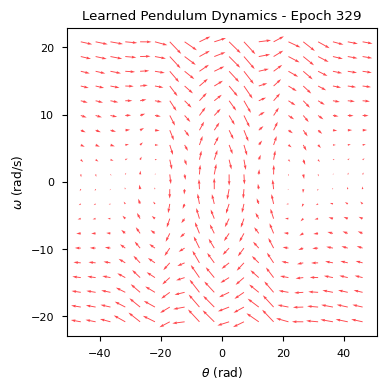

330: 6.629225997183818


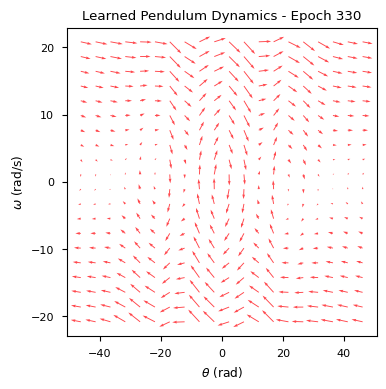

331: 6.706902808536524


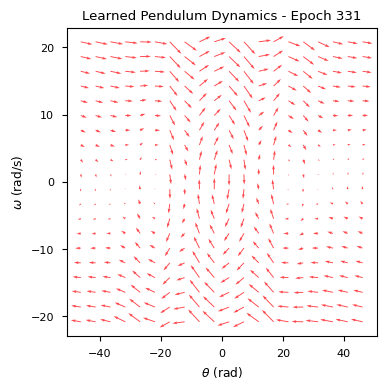

332: 6.5745089620678865


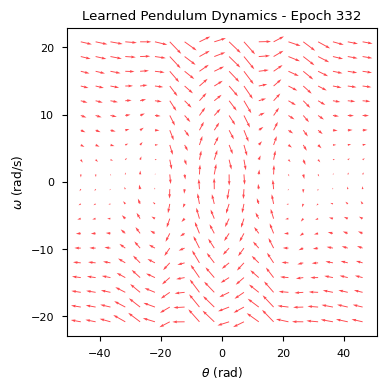

333: 6.51540152598387


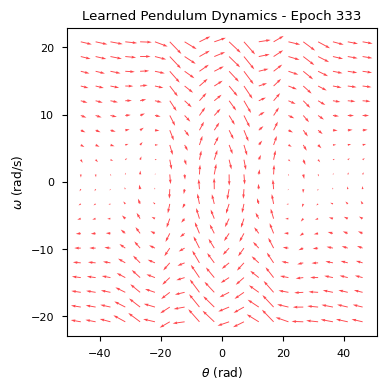

334: 6.643995264291915


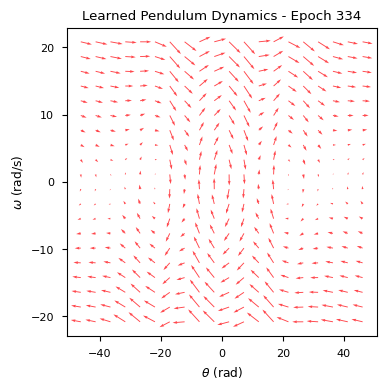

335: 6.6326685146303355


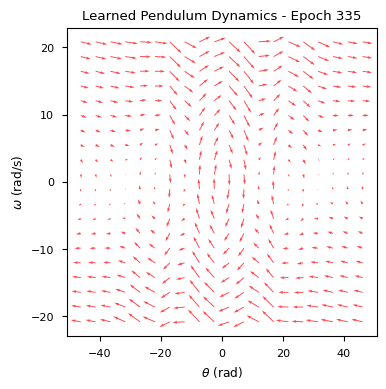

336: 6.738560139436296


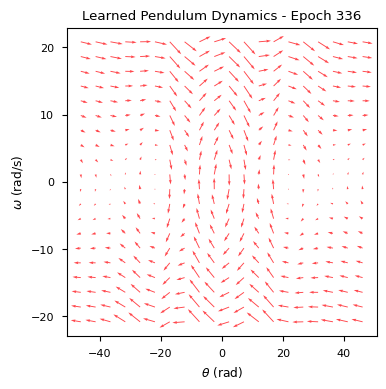

337: 6.678286068173072


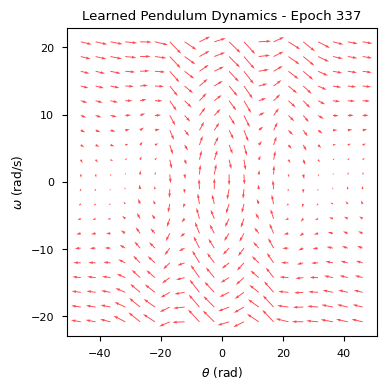

338: 6.5856434521115865


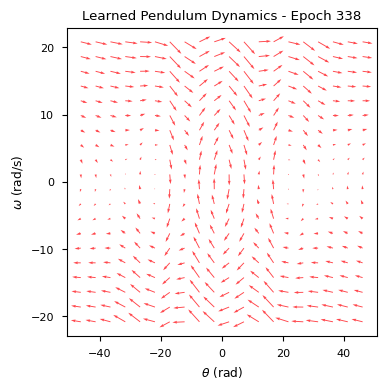

339: 6.597939034226081


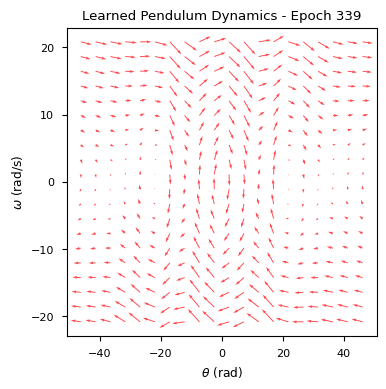

340: 6.51885050045866


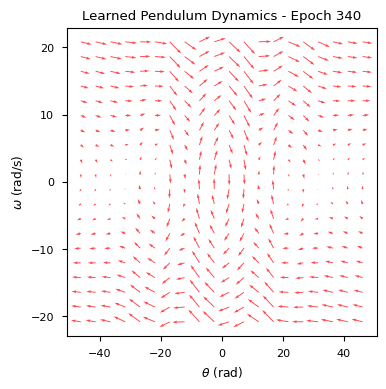

341: 6.509721753886798


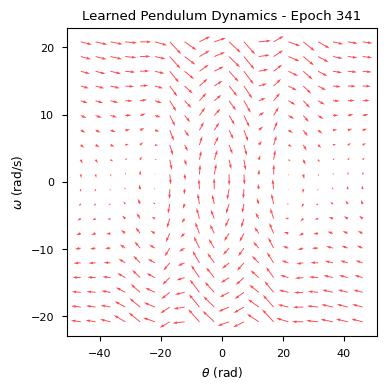

342: 6.391259515277235


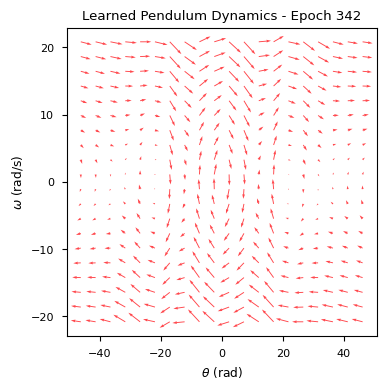

343: 6.44854023712981


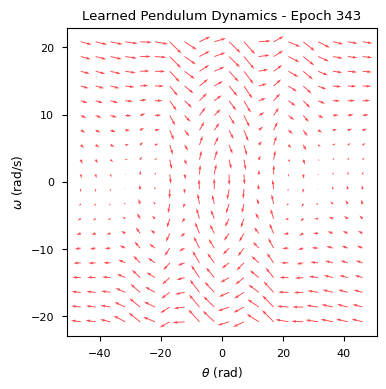

344: 6.4016055881063405


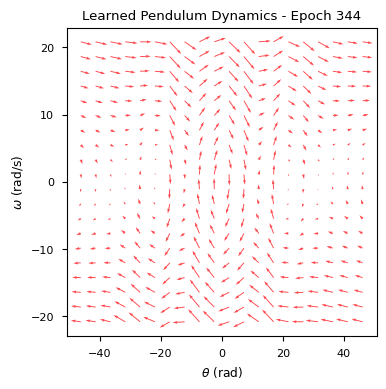

345: 6.29457364897163


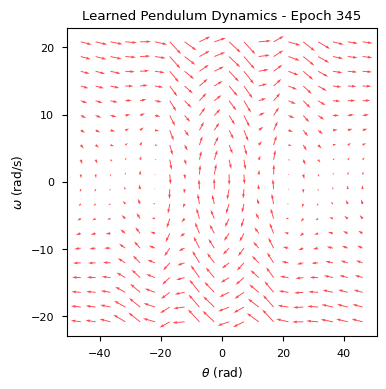

346: 6.316045013694483


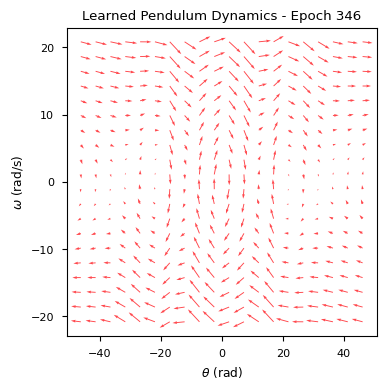

347: 6.20757239662461


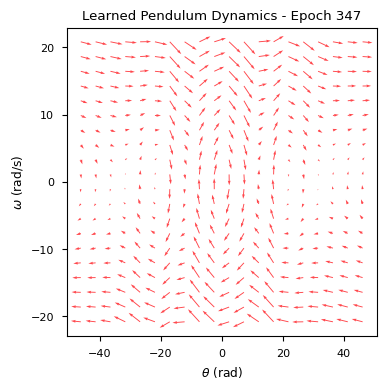

348: 6.219422637087682


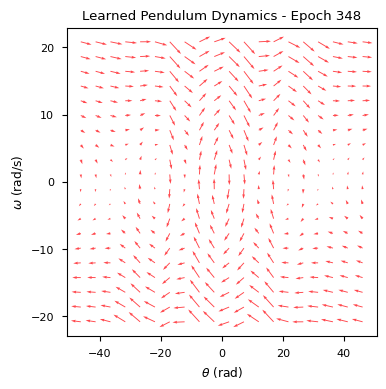

349: 6.242845800494293


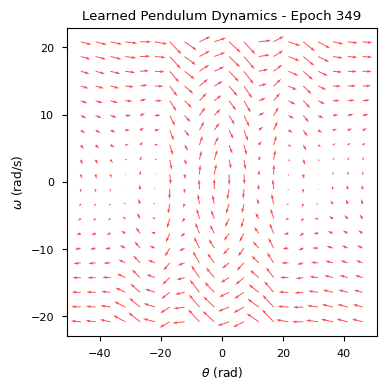

350: 6.2240640470341555


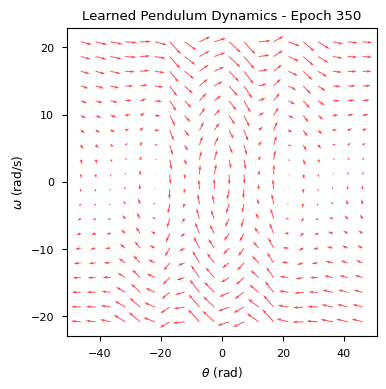

351: 6.225431509192167


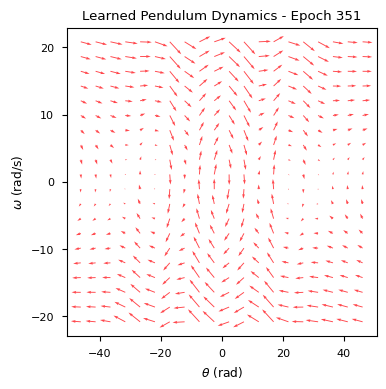

352: 6.2304564131487


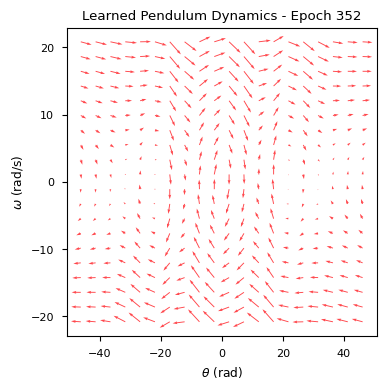

353: 6.233162612489387


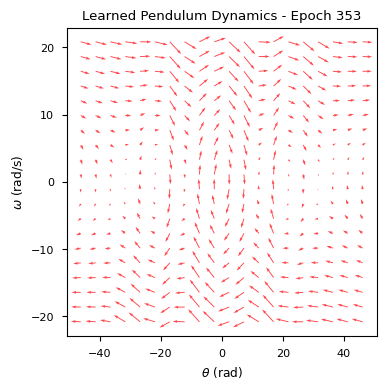

354: 6.144735849728502


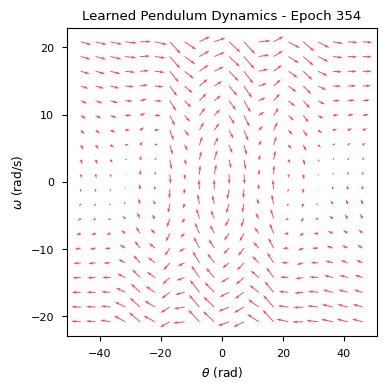

355: 6.212354911143548


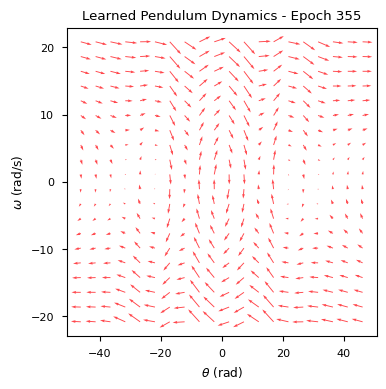

356: 6.129384132119697


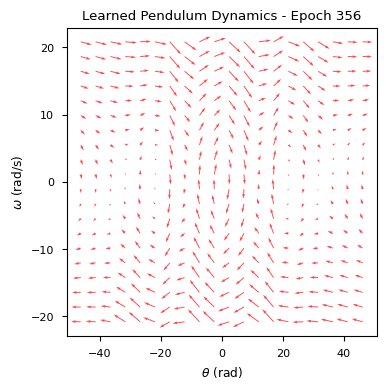

357: 6.099748184486658


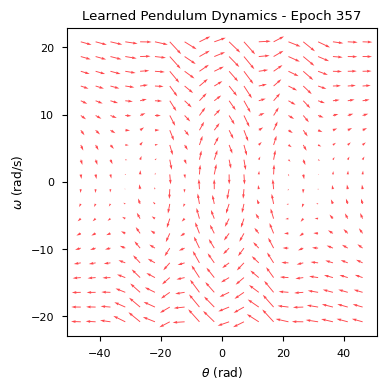

358: 6.112597120678155


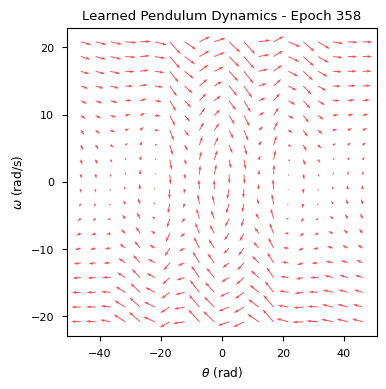

359: 6.110806655776157


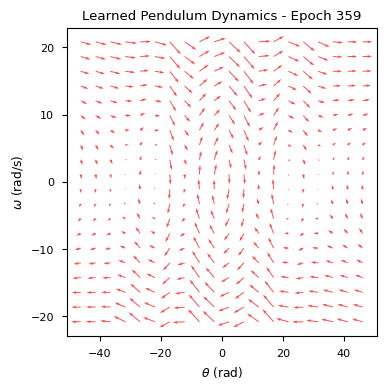

360: 5.999030729322579


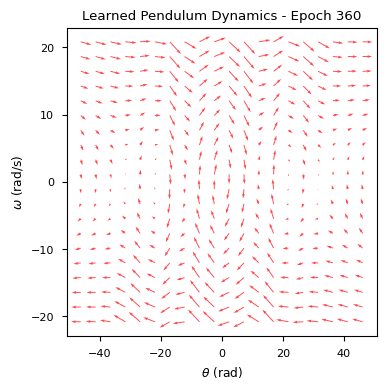

361: 5.938786227434809


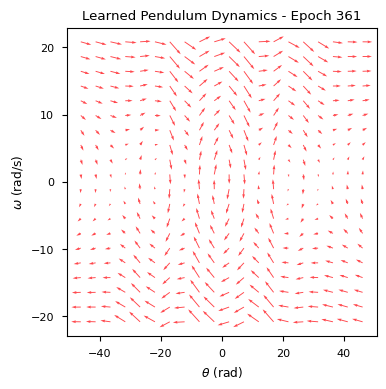

362: 6.008243715638799


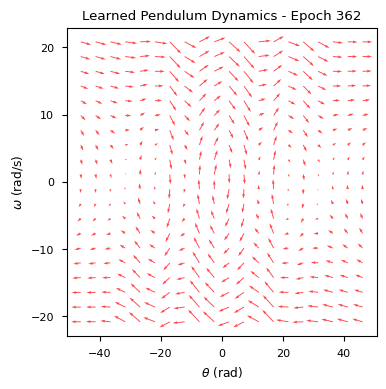

363: 6.0214119586576675


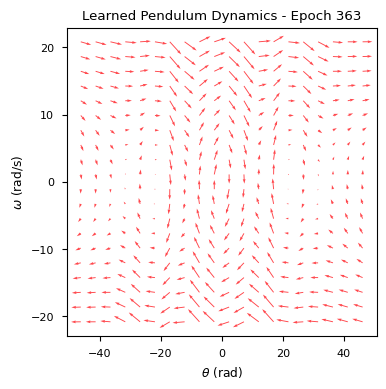

364: 6.1748539438627965


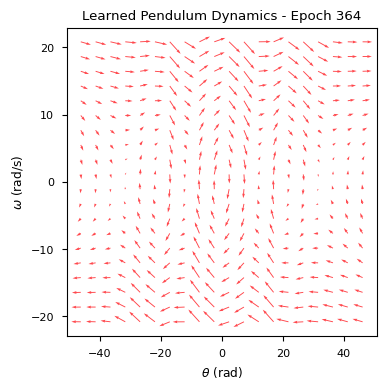

365: 6.1963617077153605


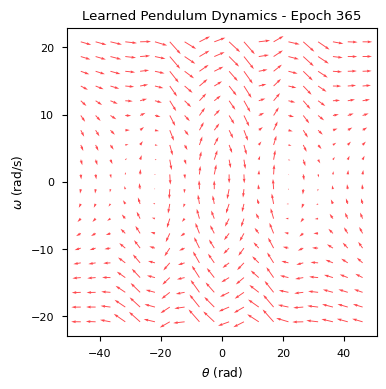

366: 6.069458291579492


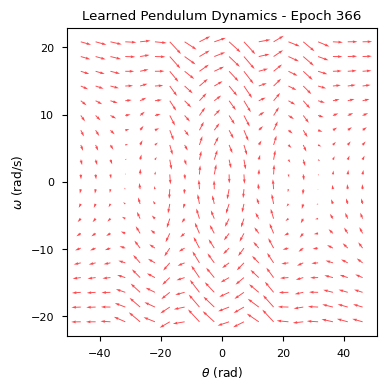

367: 6.1556456825355985


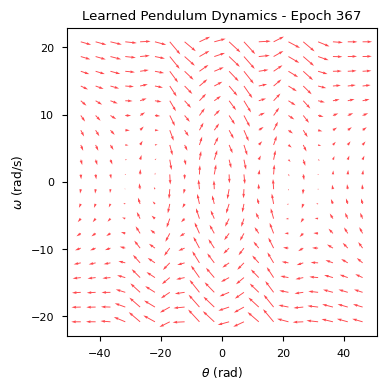

368: 6.049835723466337


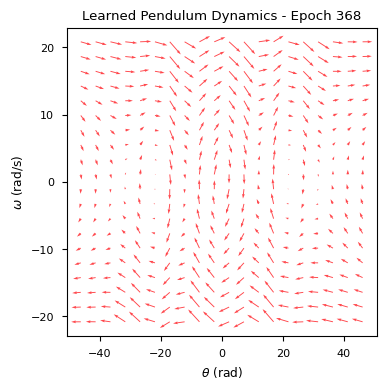

369: 6.015895260894529


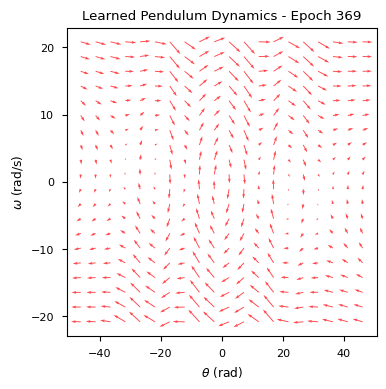

370: 6.053765986530547


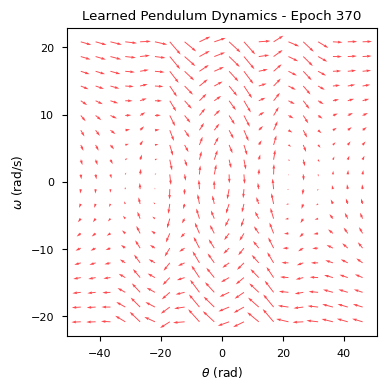

371: 5.923456825452931


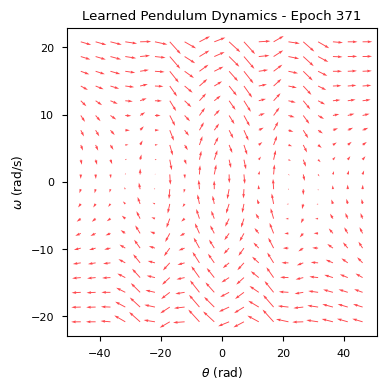

372: 5.857187285020107


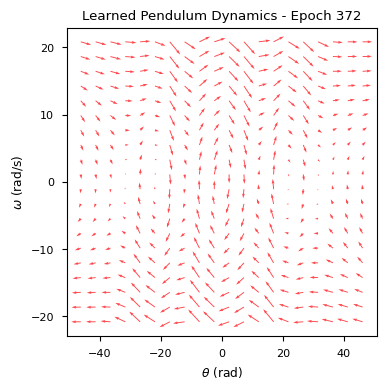

373: 5.904772855115819


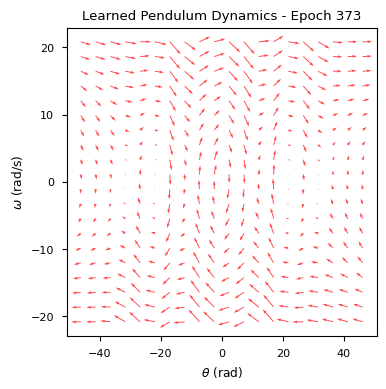

374: 5.768354167386333


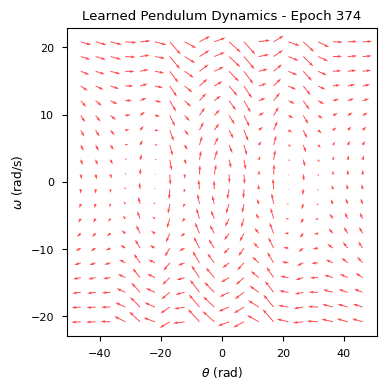

375: 5.5674822199617084


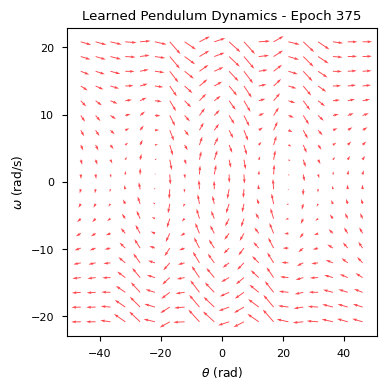

376: 5.731426422416855


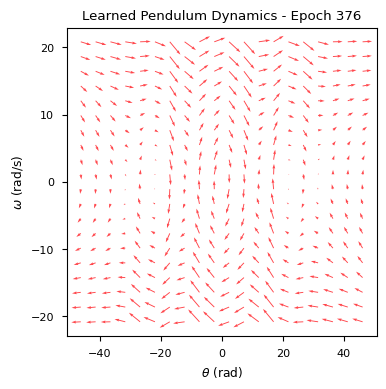

377: 5.929012713815336


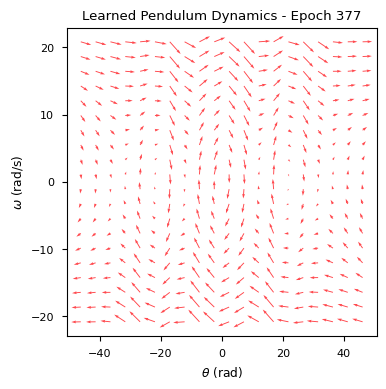

378: 5.651114289930911


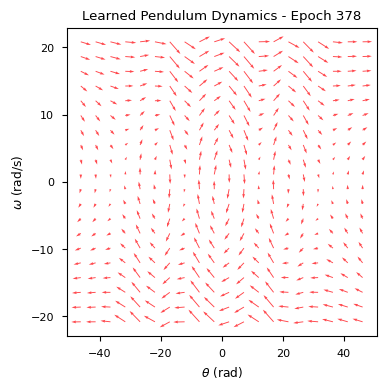

379: 5.73647761099984


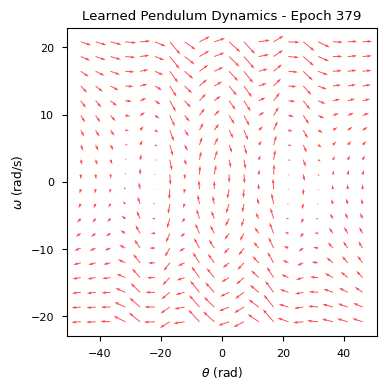

380: 5.683464530627353


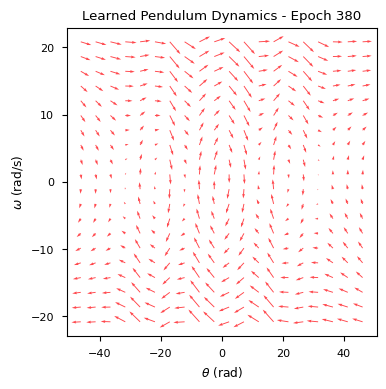

381: 5.522349711319928


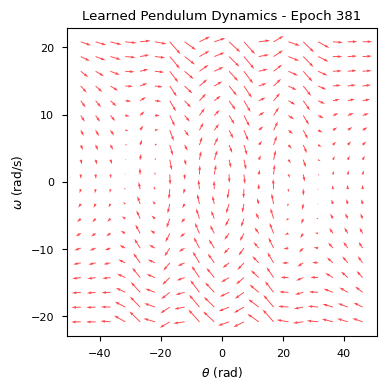

382: 5.57476548298165


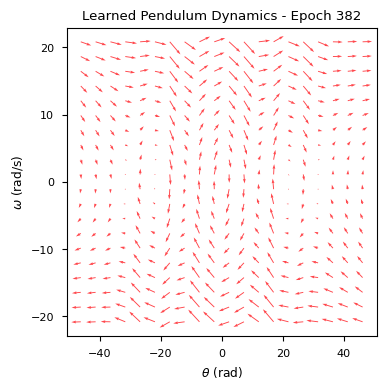

383: 5.7784819733146735


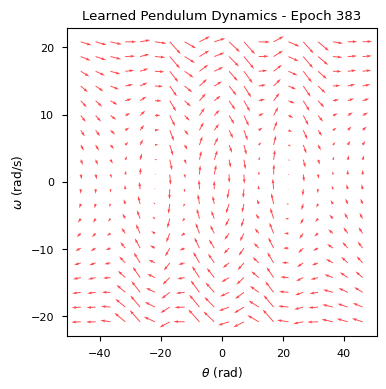

384: 5.652226105471358


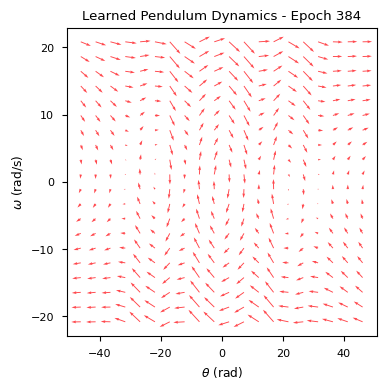

385: 5.5919597918913855


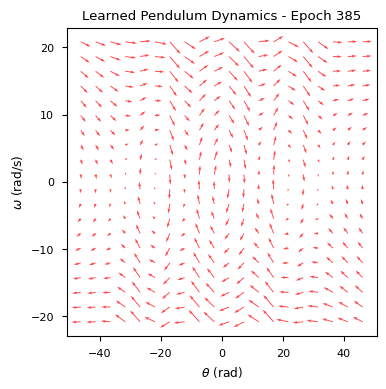

386: 5.567024995558613


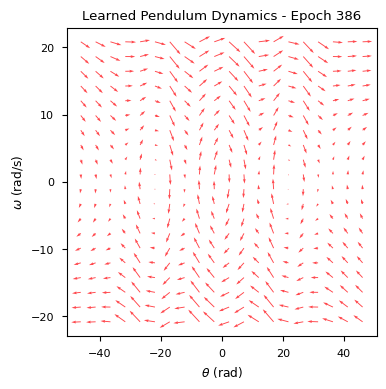

387: 5.436564758084646


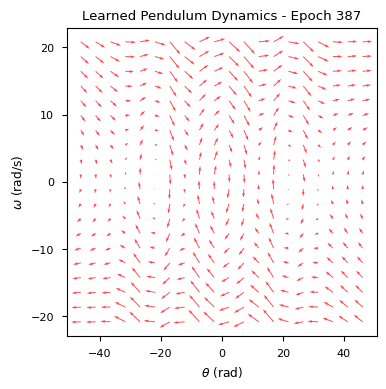

388: 5.26310334263067


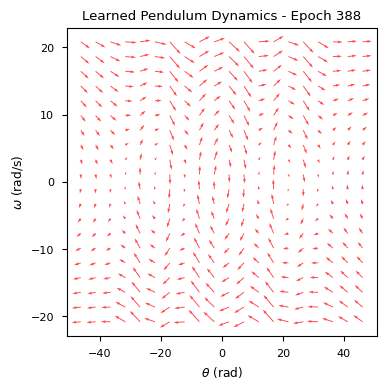

389: 5.211120204295819


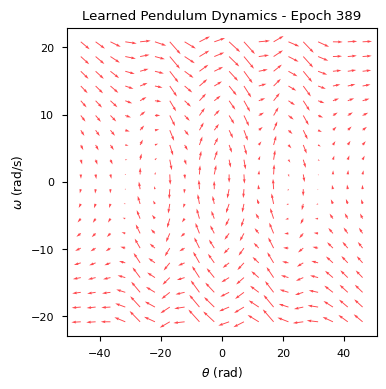

390: 5.154388515794301


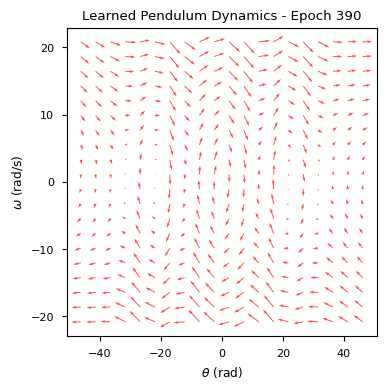

391: 5.063694540208413


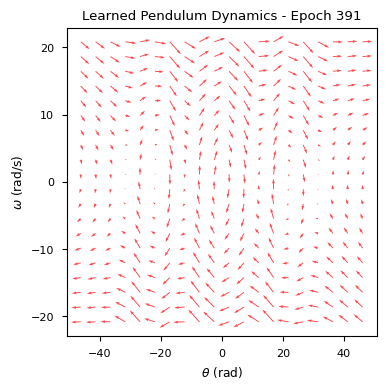

392: 5.122542447255955


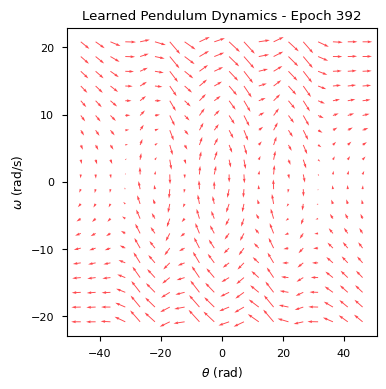

393: 5.426938969794332


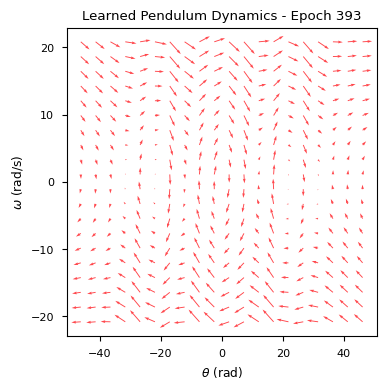

394: 5.3874183524745405


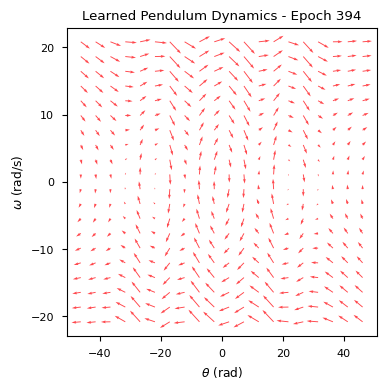

395: 5.152080292812364


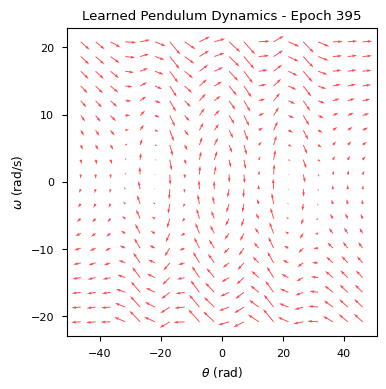

396: 5.040803495405811


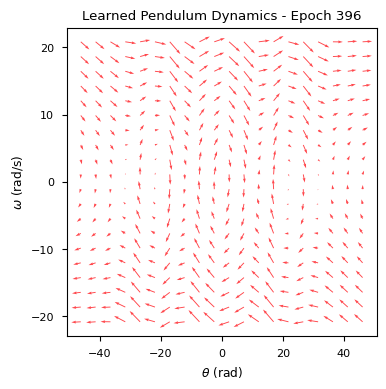

397: 4.996851458190354


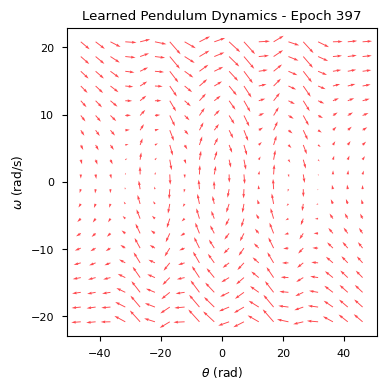

398: 4.93912399801876


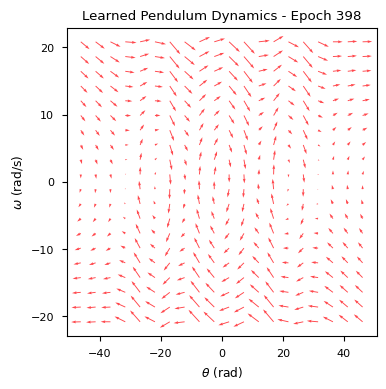

399: 5.049774592263217


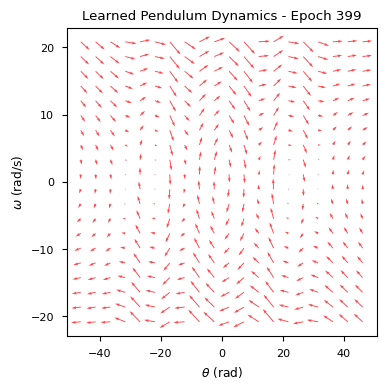

400: 5.141147752528476


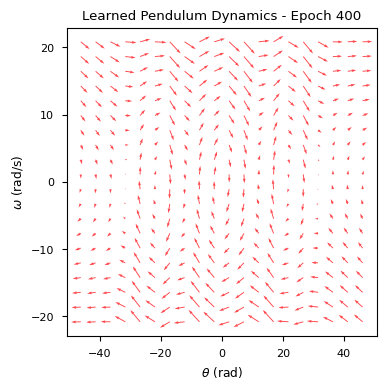

401: 5.1586302103145325


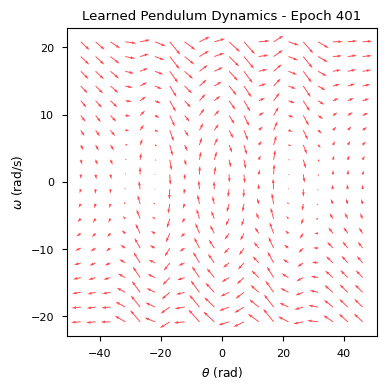

402: 4.994609322562947


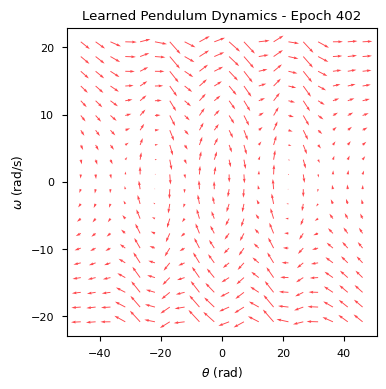

403: 4.882979071759493


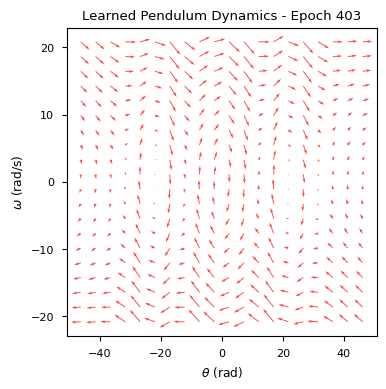

404: 4.849335990306644


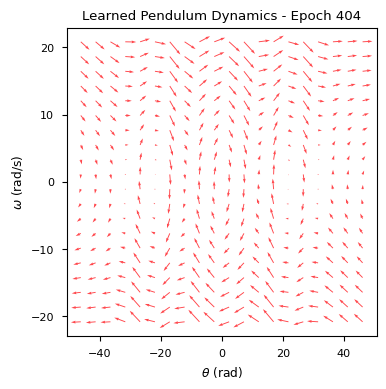

405: 4.891610004439376


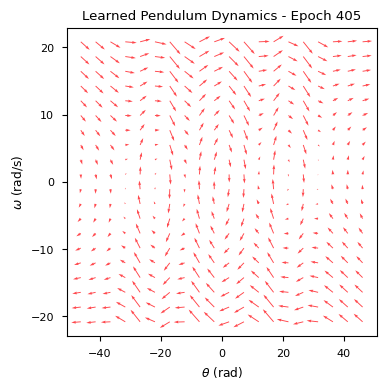

406: 4.7887267376264555


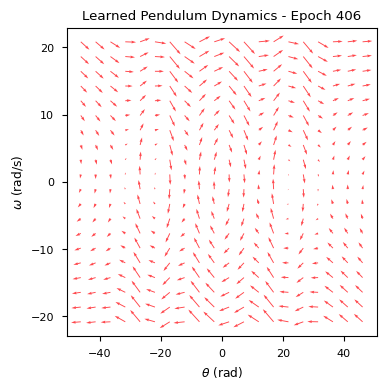

407: 4.712306212620071


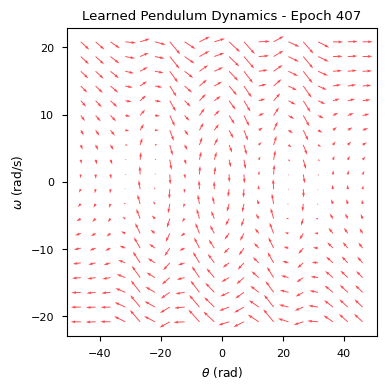

408: 4.690610954590047


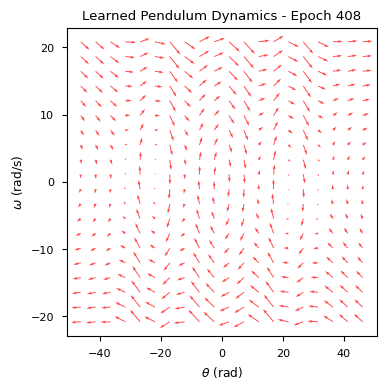

409: 4.766898702969325


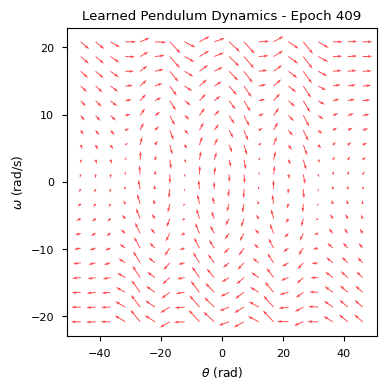

410: 5.188561386413676


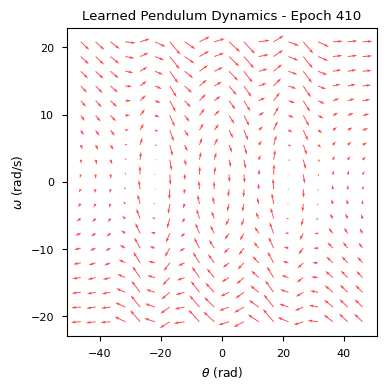

411: 5.170918011568699


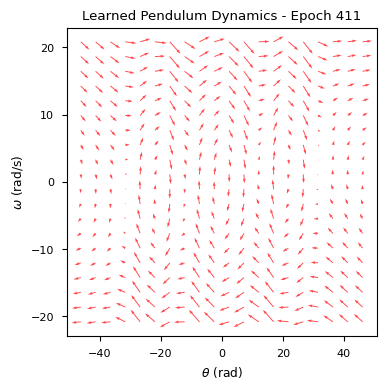

412: 5.1948629653806275


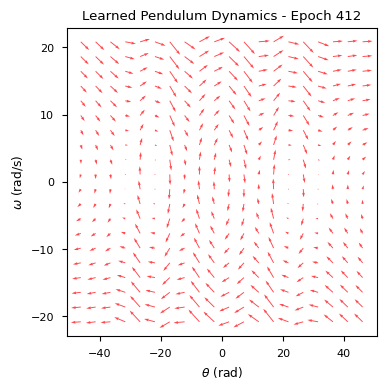

413: 4.8653692264641535


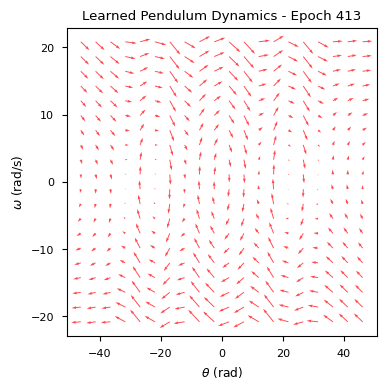

414: 4.697413674563894


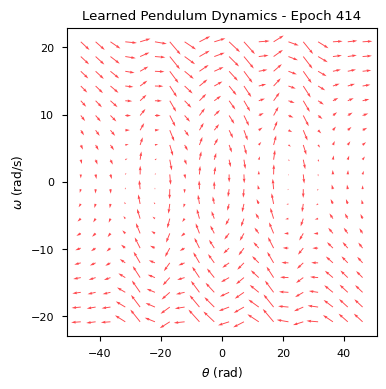

415: 4.627502372806382


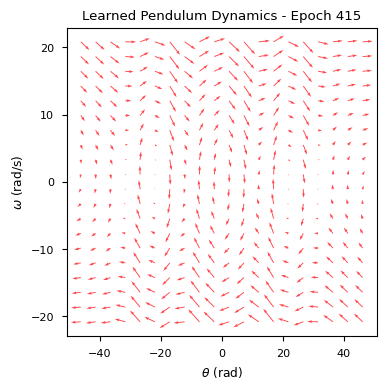

416: 4.785696138355184


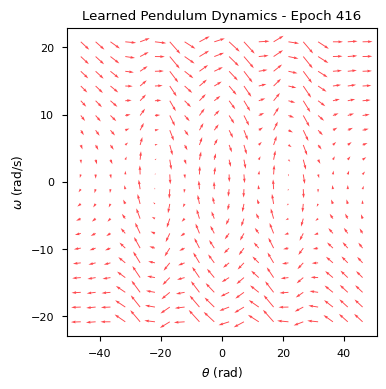

417: 4.764978090921866


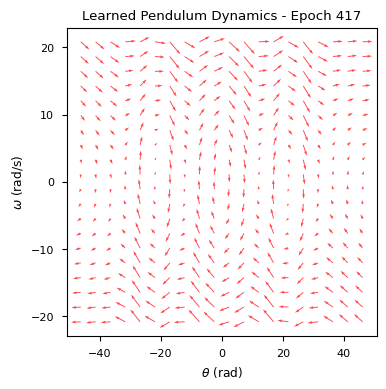

418: 4.7200095751928695


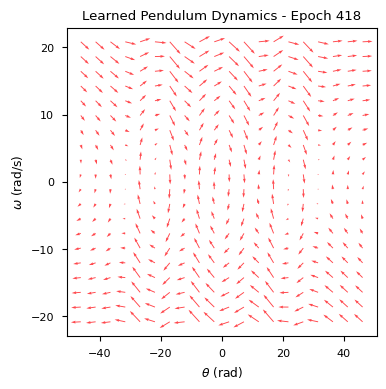

419: 4.835138671131515


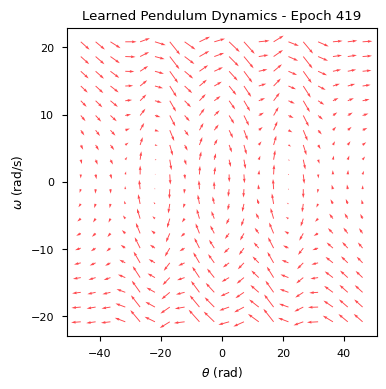

420: 5.019141656305487


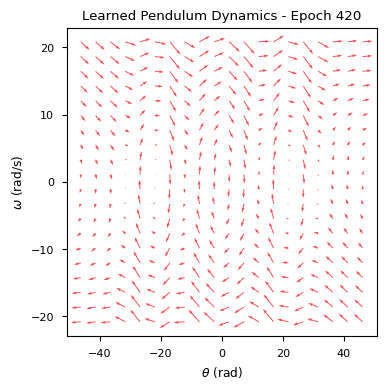

421: 4.64522876784424


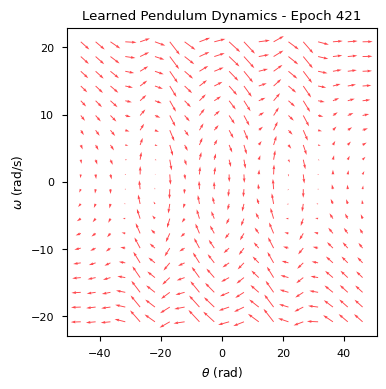

422: 4.919034804484417


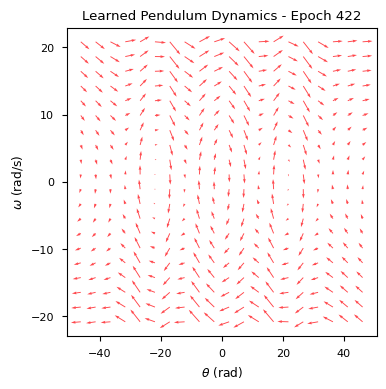

423: 4.6185395541449745


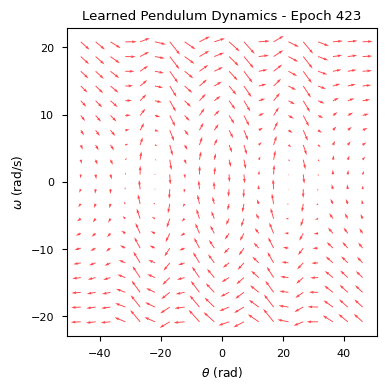

424: 4.307681909145582


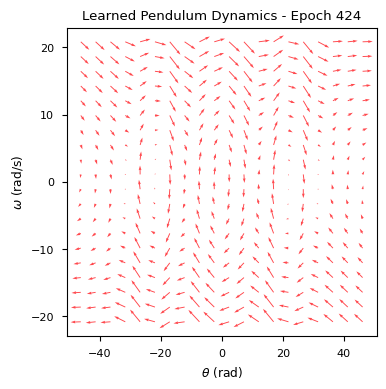

425: 4.566780593288145


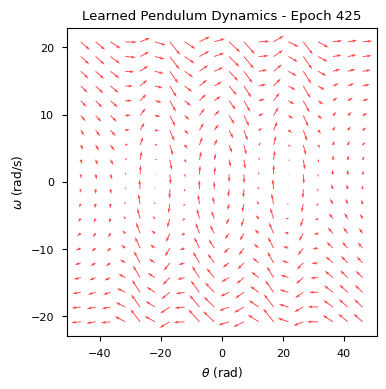

426: 4.512906762551081


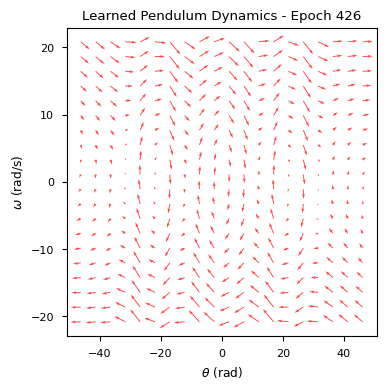

427: 4.568983289282388


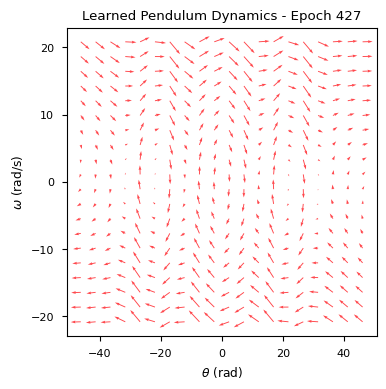

428: 4.556646003262273


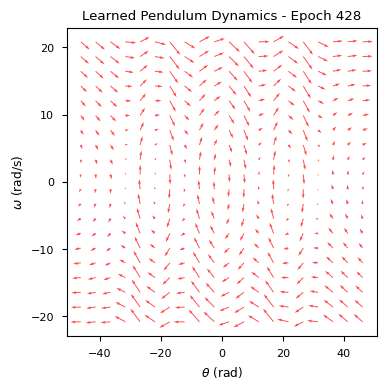

429: 4.426337003037011


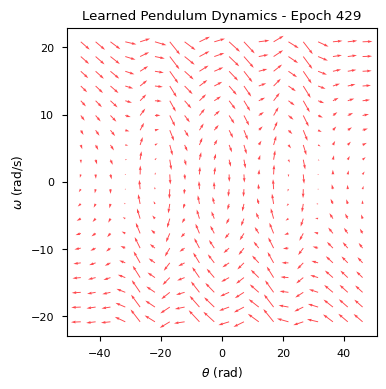

430: 4.415163647795934


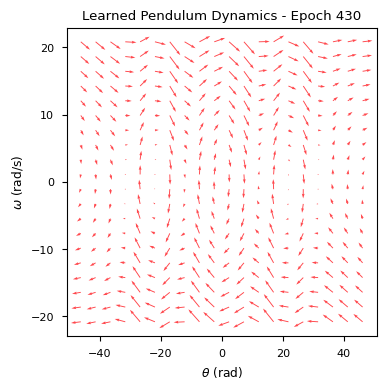

431: 4.451394520389748


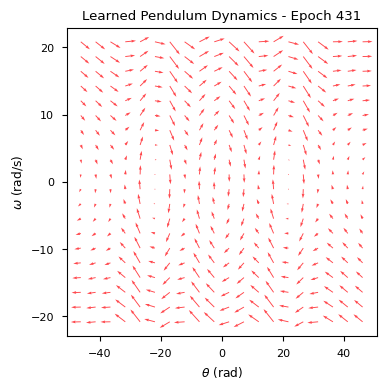

432: 4.68691026250082


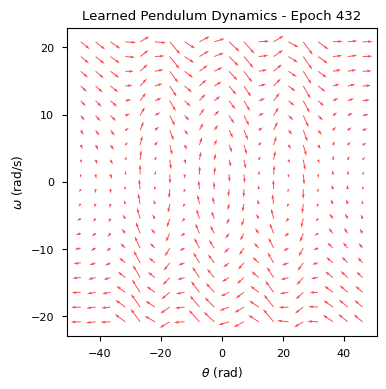

433: 4.251980013287072


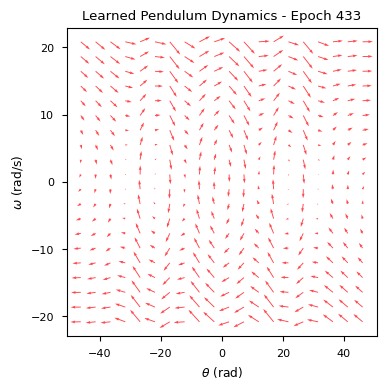

434: 4.259215537367273


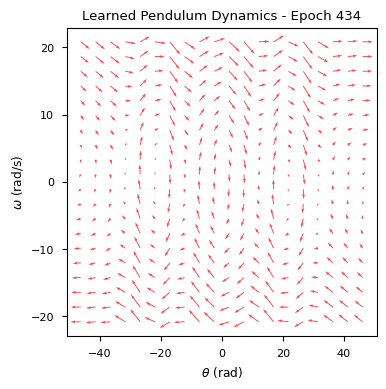

435: 4.332275948952235


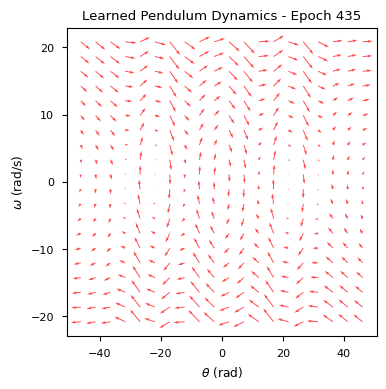

436: 4.137846204276909


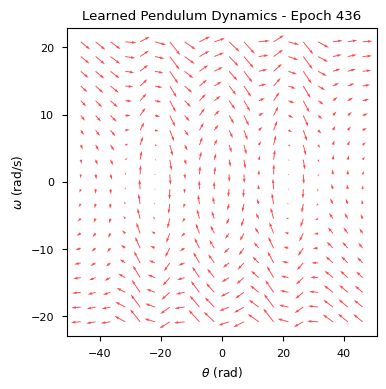

437: 4.138094195077832


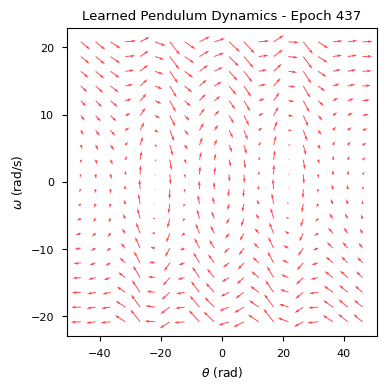

438: 4.489817371332812


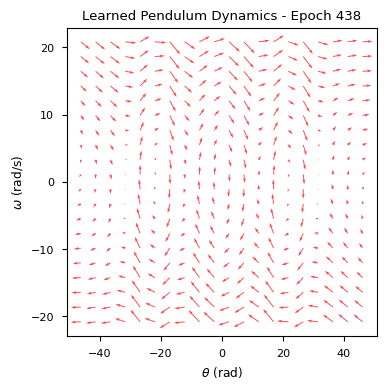

439: 4.1954686309634495


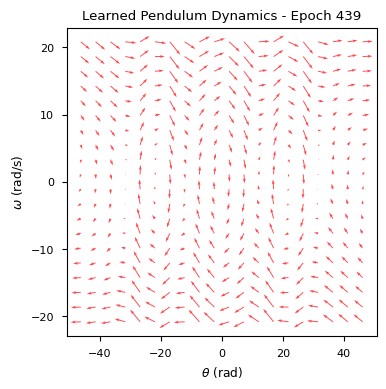

440: 4.182465287055683


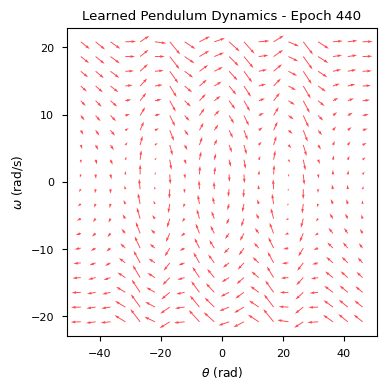

441: 4.123151479276254


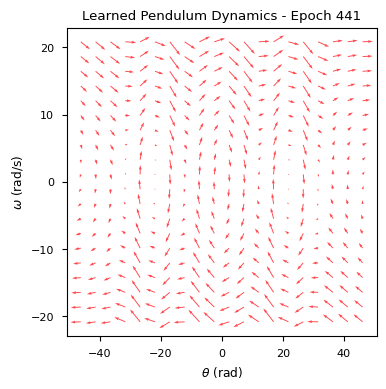

442: 4.154384168430911


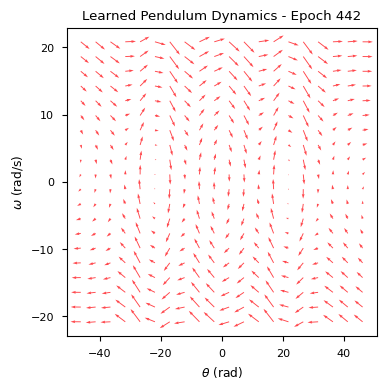

443: 4.498813052779843


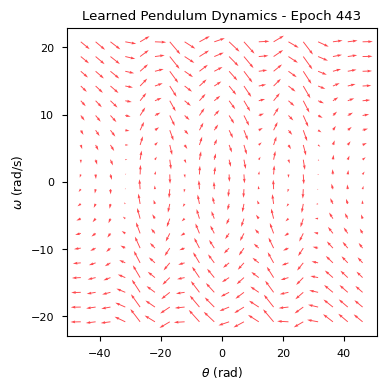

444: 4.2623576056401


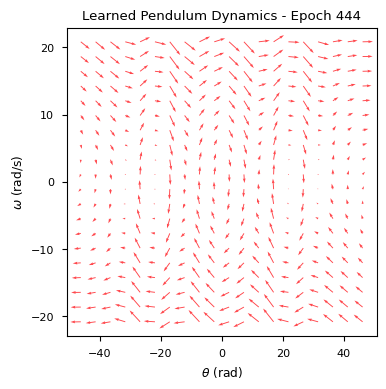

445: 4.549252679794944


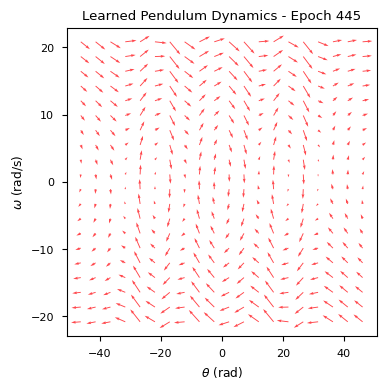

446: 4.282678246542008


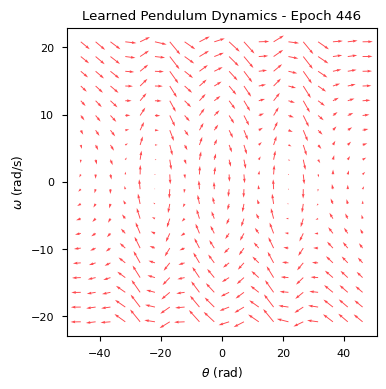

447: 4.090073064590506


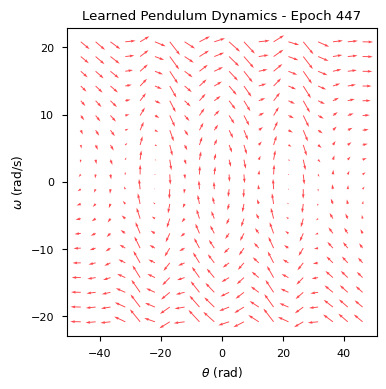

448: 4.161231629858465


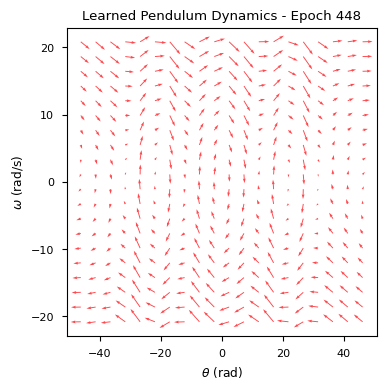

449: 4.117469092340465


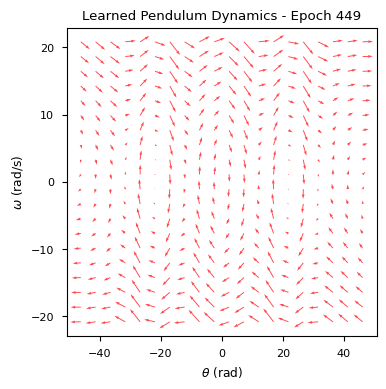

450: 4.004270630743162


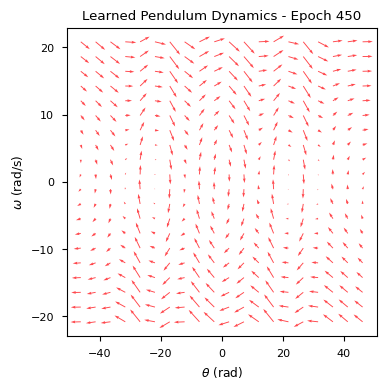

451: 3.819719090022149


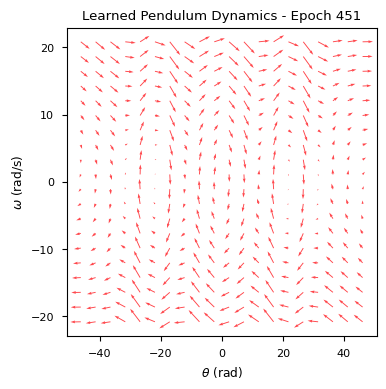

452: 3.743093627276231


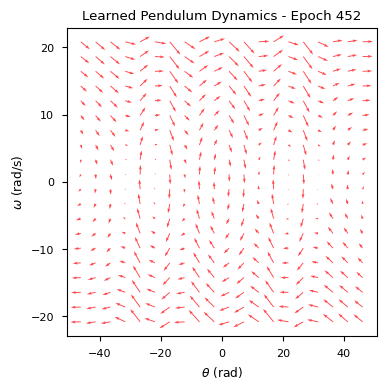

453: 3.7374167306978627


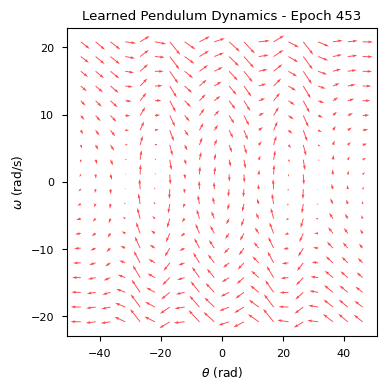

454: 3.7401639977601326


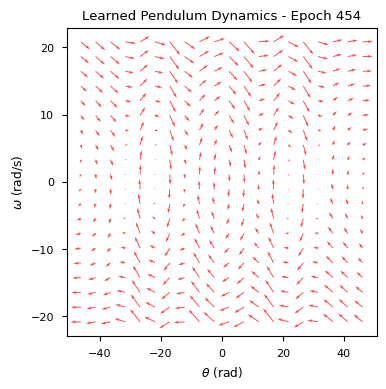

455: 3.912062199582515


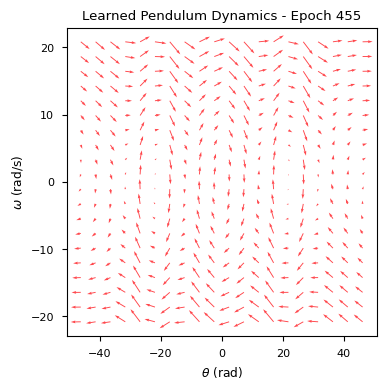

456: 4.104783288391876


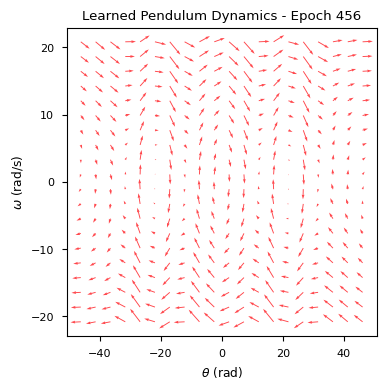

457: 4.126618605438227


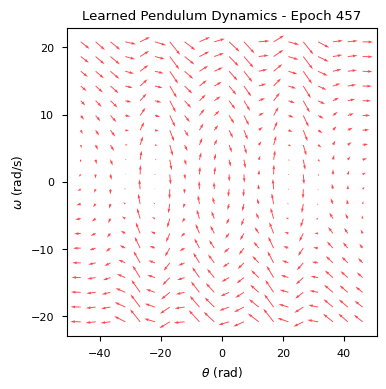

458: 4.011496933821944


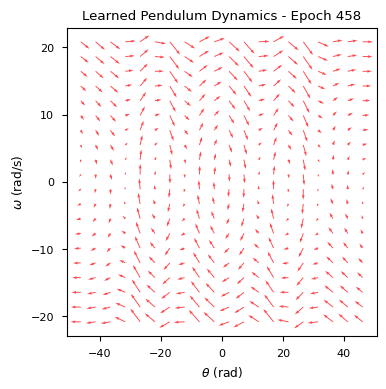

459: 4.10481272410211


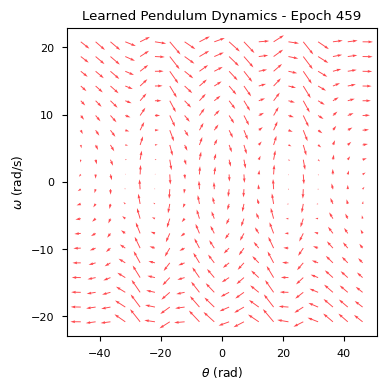

460: 3.9750278524655096


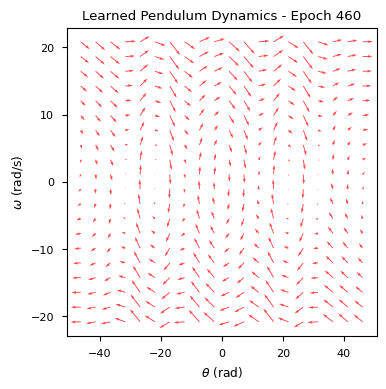

461: 3.9160627830670416


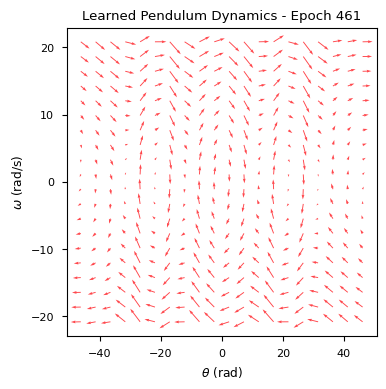

462: 4.229104362648039


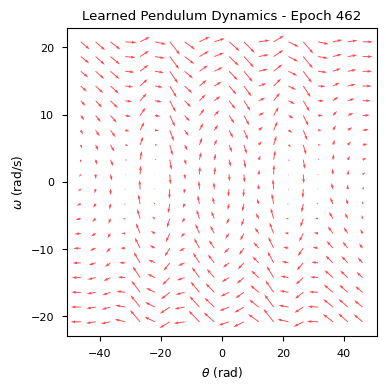

463: 3.9861664217614656


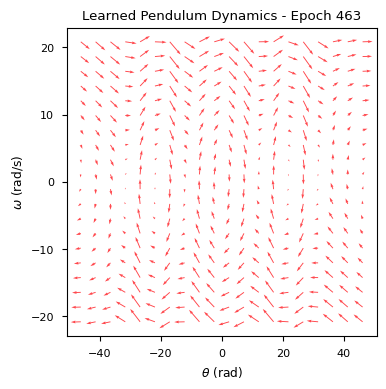

464: 3.9832632127648004


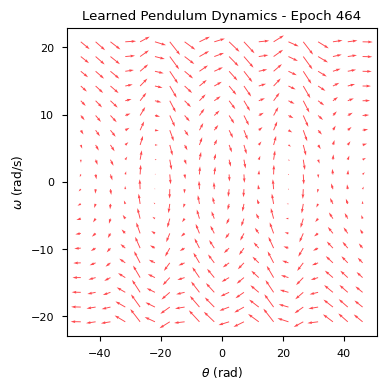

465: 3.7621771110681497


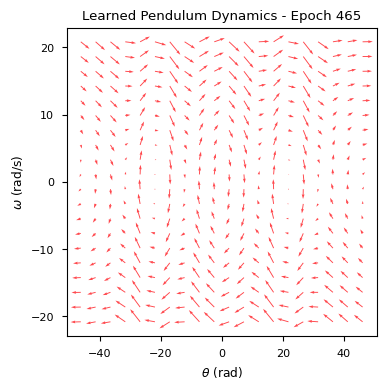

466: 3.924290862493936


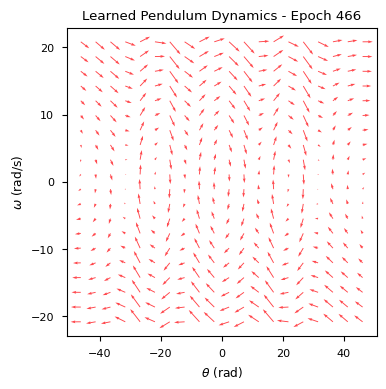

467: 3.786303161204118


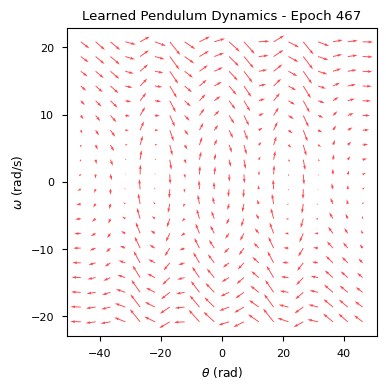

468: 3.7076515903692626


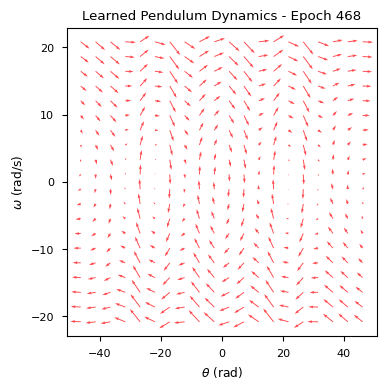

469: 3.541244832039149


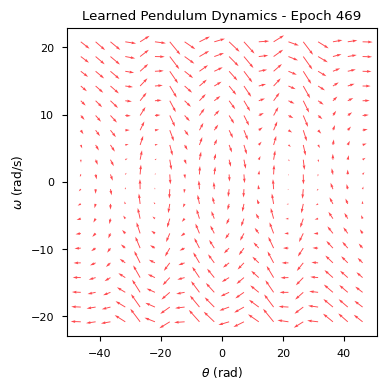

470: 3.520474735362375


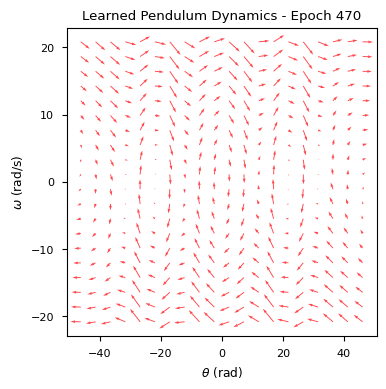

471: 3.618412083414074


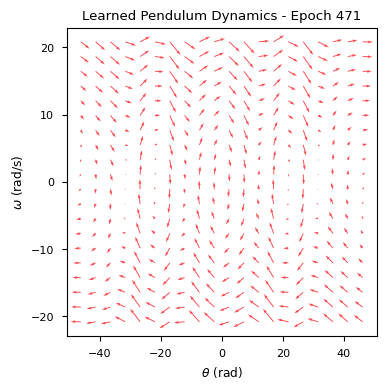

472: 3.7099908915657274


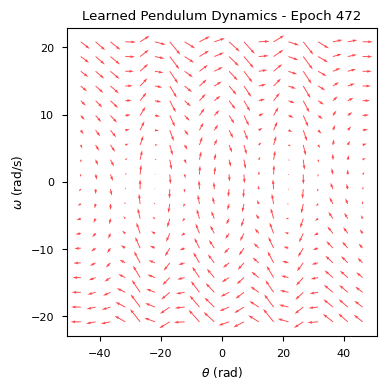

473: 3.808873605814128


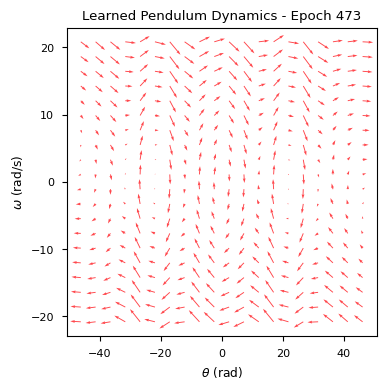

474: 3.7992073572309684


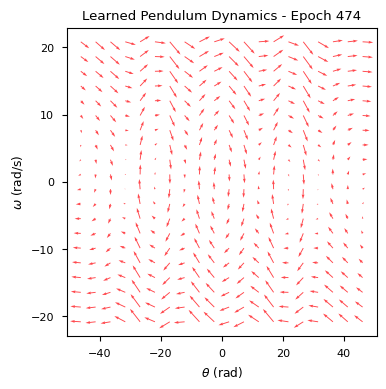

475: 3.902350581870756


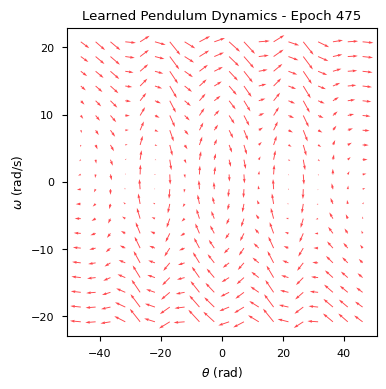

476: 4.08250455728084


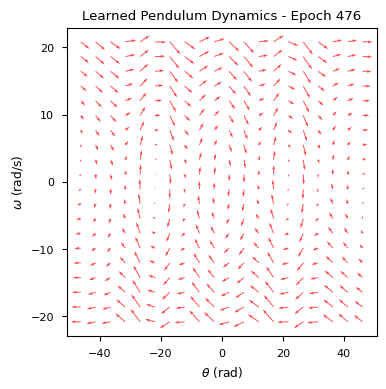

477: 4.213082251992146


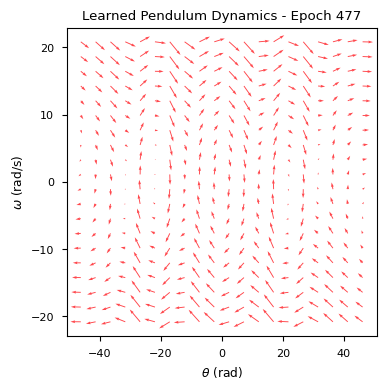

478: 4.106855324201349


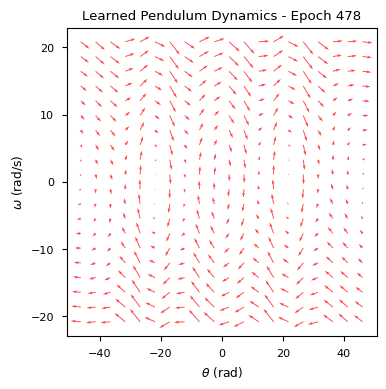

479: 3.948128674946794


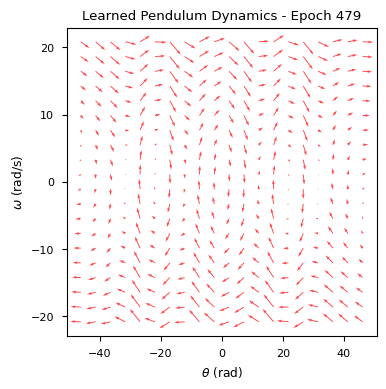

480: 3.612741081617315


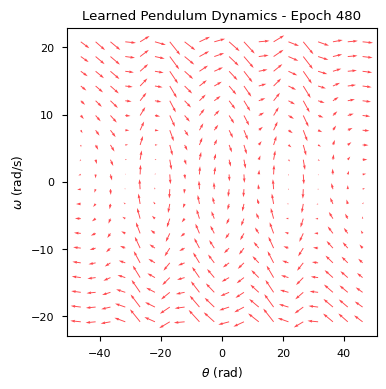

481: 3.5975845896839083


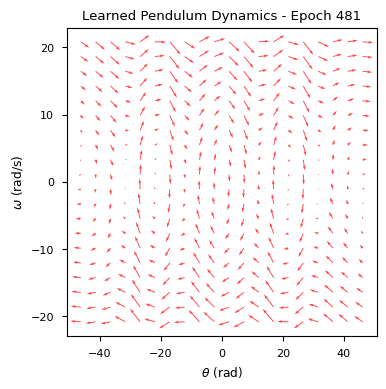

482: 3.534012813666654


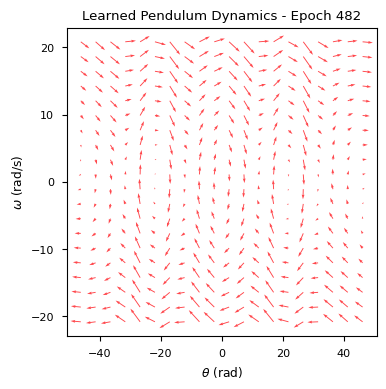

483: 3.488460124840879


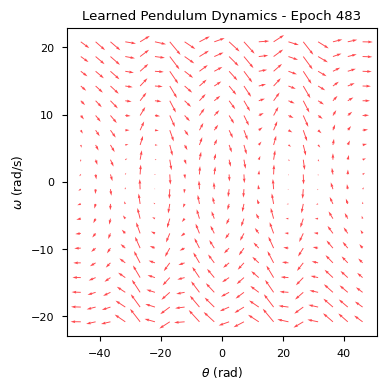

484: 3.375721611161125


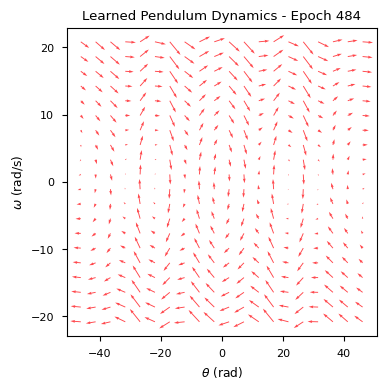

485: 3.2050897970612664


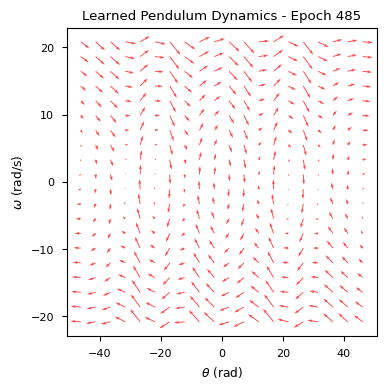

486: 3.227440301717951


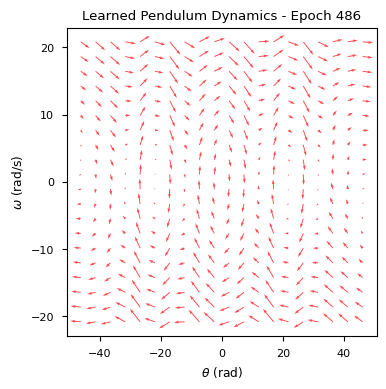

487: 3.256709957225008


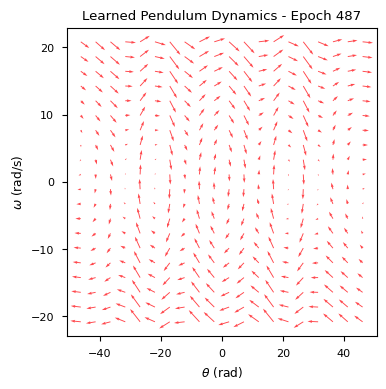

488: 3.3408395247055473


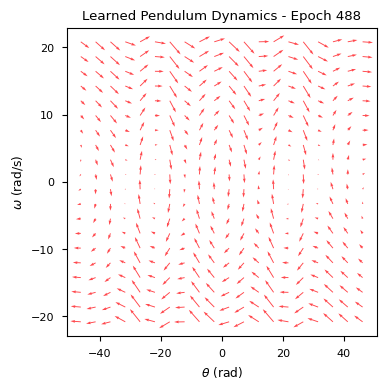

489: 3.543387965321796


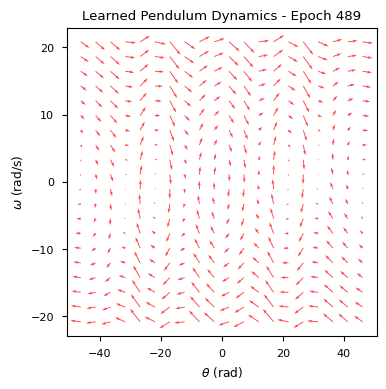

490: 3.4383285788283686


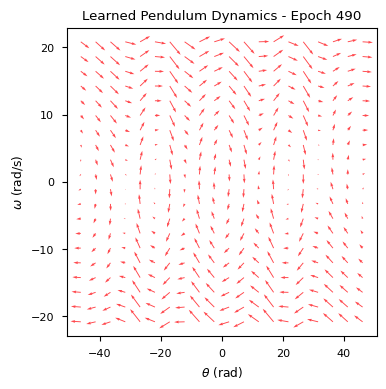

491: 3.5941483926186675


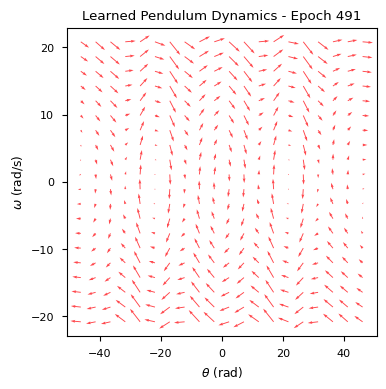

492: 3.5734534449545485


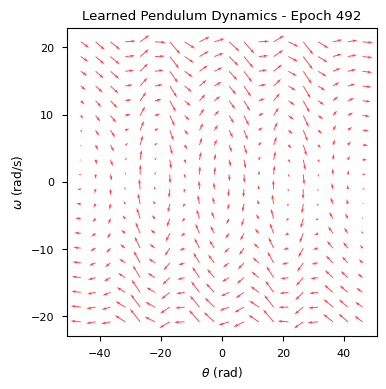

493: 3.5938765590607287


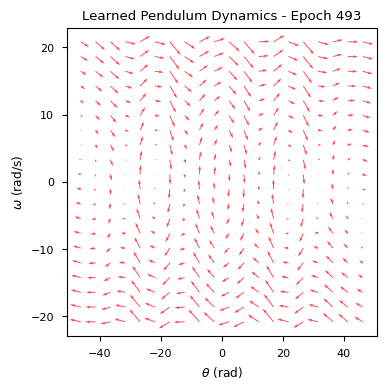

494: 3.6471501603767726


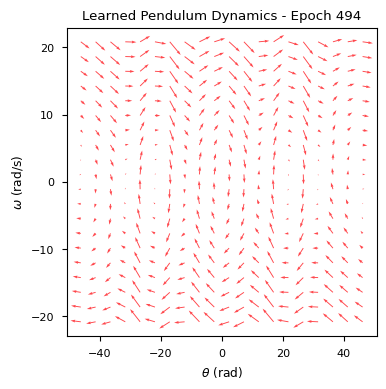

495: 3.5941412254639706


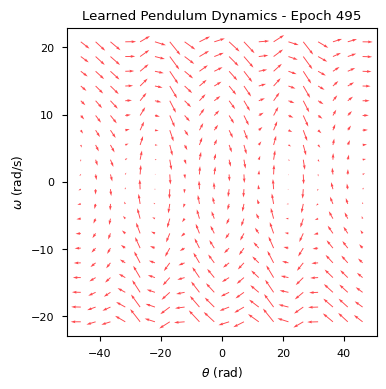

496: 3.4741945952568836


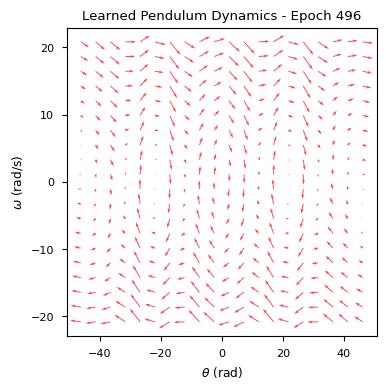

497: 3.3096955737266724


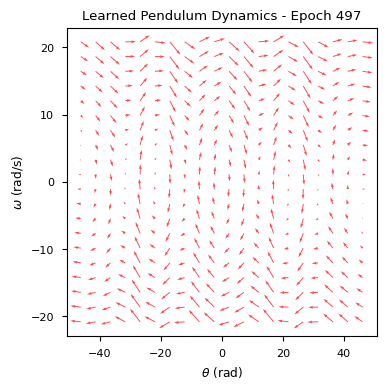

498: 3.310654655629411


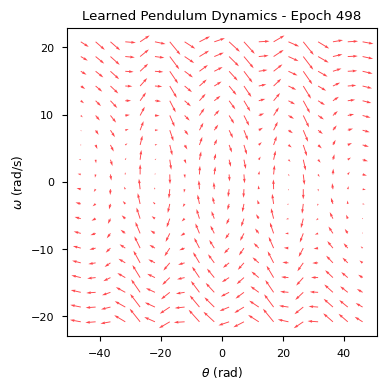

499: 3.399363947746699


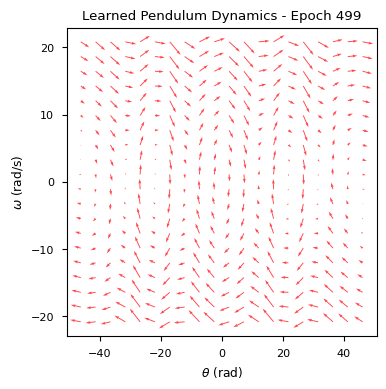

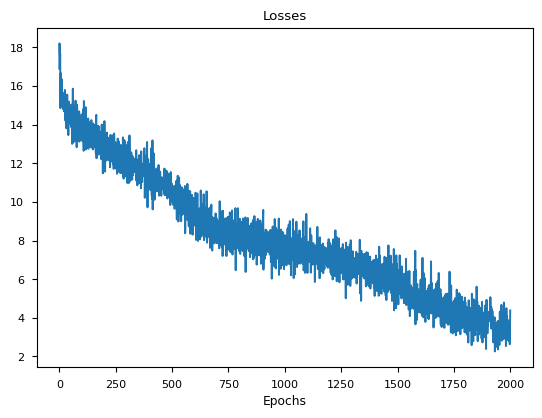

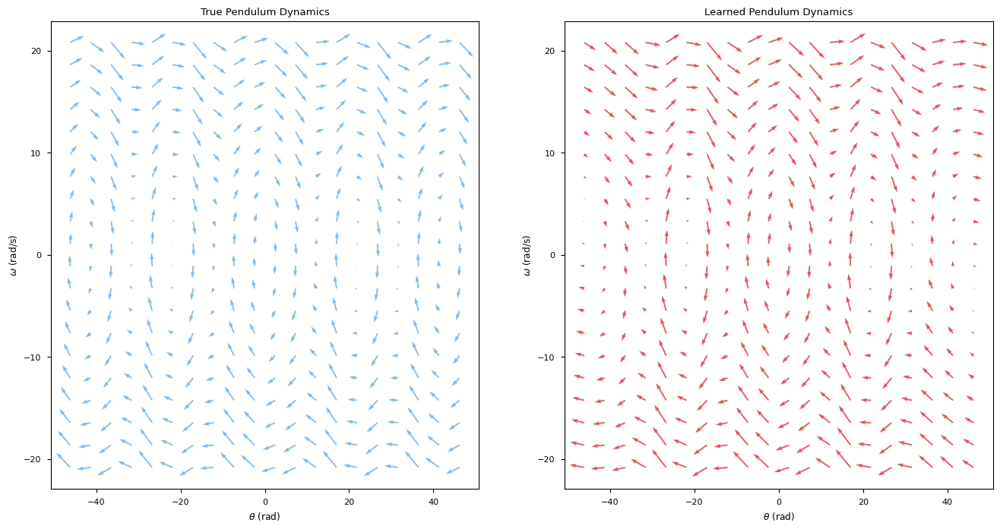

In [447]:
learning_ode_model = run_dx_dt_experiment(
    traj_count=1000, batch_size=100, epochs=500,
    lr=1e-3, activation='tanh', initializer=tf.keras.initializers.GlorotUniform(), layers=[256, 128, 32],
    solver="rk4", solver_args=dict(h=tf.cast(1/16, dtype=tf.float64))
)

In [ ]:
def run_seq_experiment(traj_count=1000, batch_size=1000, epochs=20, seq_len=10,
                   lr=1e-3, activation='tanh', initializer=None, layers=None,
                   adjoint=True, solver="dopri5", solver_args=None):
    if solver_args is None:
        solver_args = dict(rtol=1e-3, atol=1e-3)
    # generate the training data with a true dynamics simulation
    batch_x_0 = tf.random.uniform([traj_count, 2], [-20, -20], [20, 20], dtype=tf.float64)
    p = tf.tile(tf.constant([9.81, 0.01, 0.4, 0.5, 0.03], dtype=tf.float64)[None, :], (traj_count, 1))
    ode_model = lambda t, x: system(x, None, p, t)
    batch_x, tt_rk4 = tfd.de.odeint(ode_model, batch_x_0, tfd_time_range, method=solver, **solver_args)
    
    # generate flow field coordinates
    magnitude_theta = tf.reduce_max(tf.abs(batch_x[..., 0]))
    magnitude_omega = tf.reduce_max(tf.abs(batch_x[..., 1]))
    theta = np.linspace(-magnitude_theta, magnitude_theta, 20)
    omega = np.linspace(-magnitude_omega, magnitude_omega, 20)
    X, Y = np.meshgrid(theta, omega)
    big_coords = tf.concat([tf.stack([[X[x, y], Y[x, y]] for y in range(20)], axis=0) for x in range(20)], axis=0)
    big_coords = tf.cast(big_coords, tf.float64)
    
    # sample true dynamics flow field
    p_2 = tf.tile(tf.constant([9.81, 0.01, 0.4, 0.5, 0.03], dtype=tf.float64)[None, :], (big_coords.shape[0], 1))
    ode_model_2 = lambda t, x: system(x, None, p_2, t)
    big_dx_dt = ode_model_2(None, big_coords)
    
    # plot the true flow field and the training dataset
    fig, true_ax = plt.subplots(1, 1, figsize=(8, 8))
    true_ax.quiver(big_coords[:, 0], big_coords[:, 1], big_dx_dt[:, 0], big_dx_dt[:, 1], color="xkcd:sky blue")
    for traj in batch_x:
        true_ax.plot(traj[:, 0], traj[:, 1], '--', color="gray", linewidth="0.1")
    true_ax.set_xlabel(r"$\theta$ (rad)")
    true_ax.set_ylabel(r"$\omega$ (rad/s)")
    true_ax.set_title("True Pendulum Dynamics")
    plt.show()
    
    # build tensorflow training set and model
    dataset = tf.data.Dataset.from_tensor_slices(batch_x)
    dataset = dataset.shuffle(traj_count, reshuffle_each_iteration=True)
    dataset = dataset.batch(batch_size)
    learning_ode_model = create_new_model(initializer, layers, activation)
    learning_ode_func = lambda t, x: learning_ode_model(x)
    learning_solver = tfd.de.OdeintSolver(learning_ode_func, method=solver,
                                          options=solver_args,
                                          adjoint_options=solver_args)
    
    # touch once to initialize
    learning_ode_model(batch_x_0)
    
    # plot the starting flow field
    pred_dx_dt = learning_ode_model(big_coords)
    fig, pred_ax = plt.subplots(1, 1, figsize=(8, 8))
    pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
    pred_ax.set_xlabel(r"$\theta$ (rad)")
    pred_ax.set_ylabel(r"$\omega$ (rad/s)")
    pred_ax.set_title("Learned Pendulum Dynamics - Upon Initialization")
    plt.show()
    
    # train this bad boy
    optimizer = tf.keras.optimizers.Adam(learning_rate=lr)
    losses = []
    for epoch in range(epochs):
        epoch_avg_loss = []
        for batch in dataset:
            window = random.randint(0, batch.shape[1] - seq_len)
            with tf.GradientTape() as tape:
                if adjoint:
                    xt_hat, *_ = learning_solver.odeint_adjoint(batch[..., window, :], tfd_time_range)
                else:
                    xt_hat, *_ = learning_solver.odeint(batch[..., window, :], tfd_time_range)
                err = tf.reduce_mean(
                    tf.linalg.norm(
                        xt_hat[..., -1, :] - batch[..., window+seq_len-1, :],
                        axis=-1
                    )
                )
            grads = tape.gradient(err, learning_ode_model.trainable_variables)
            optimizer.apply_gradients(zip(grads, learning_ode_model.trainable_variables))
            losses.append(err)
            epoch_avg_loss.append(err)
        epoch_avg_loss = np.mean(epoch_avg_loss)
        print(f"{epoch}: {epoch_avg_loss}")

        # plot the flow field at the end of the epoch
        pred_dx_dt = learning_ode_model(big_coords)
        fig, pred_ax = plt.subplots(1, 1, figsize=(4, 4))
        pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
        pred_ax.set_xlabel(r"$\theta$ (rad)")
        pred_ax.set_ylabel(r"$\omega$ (rad/s)")
        pred_ax.set_title(f"Learned Pendulum Dynamics - Epoch {epoch}")
        plt.show()
     
    # plot the training curve
    plt.plot(losses)
    plt.title("Losses")
    plt.xlabel("Epochs")
    
    # plot the final flow against the ground truth
    pred_dx_dt = learning_ode_model(big_coords)
    fig, (true_ax, pred_ax) = plt.subplots(1, 2, figsize=(16, 8))
    true_ax.quiver(big_coords[:, 0], big_coords[:, 1], big_dx_dt[:, 0], big_dx_dt[:, 1], color="xkcd:sky blue")
    true_ax.set_xlabel(r"$\theta$ (rad)")
    true_ax.set_ylabel(r"$\omega$ (rad/s)")
    true_ax.set_title("True Pendulum Dynamics")
    pred_ax.quiver(big_coords[:, 0], big_coords[:, 1], pred_dx_dt[:, 0], pred_dx_dt[:, 1], color="xkcd:light red")
    pred_ax.set_xlabel(r"$\theta$ (rad)")
    pred_ax.set_ylabel(r"$\omega$ (rad/s)")
    pred_ax.set_title("Learned Pendulum Dynamics")
    plt.show()
    
    return learning_ode_model

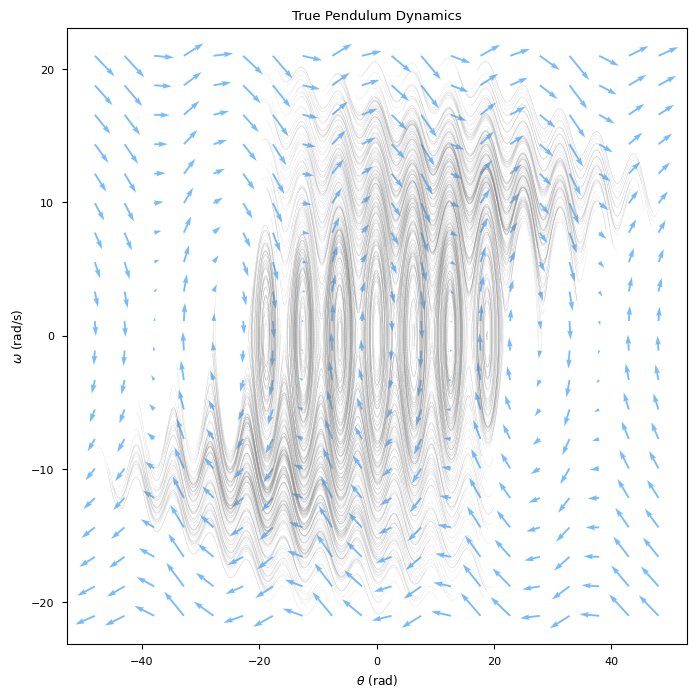

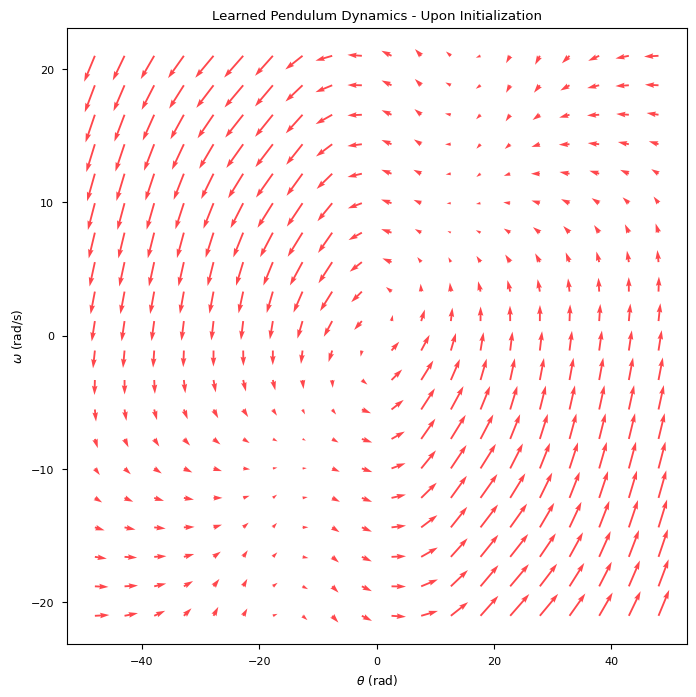

0: 3.1903237059058633


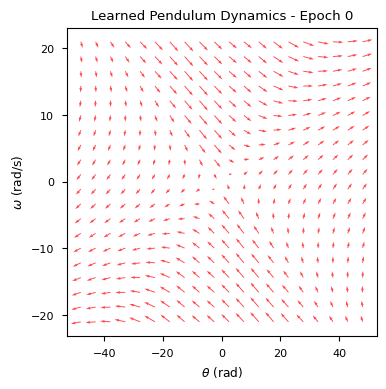

1: 2.773387313822361


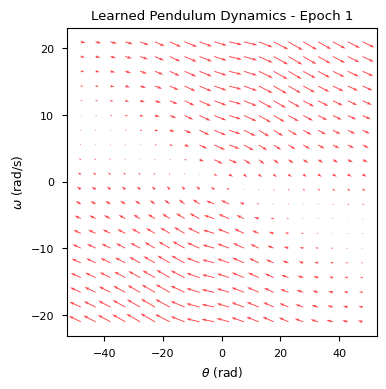

2: 2.841404504775986


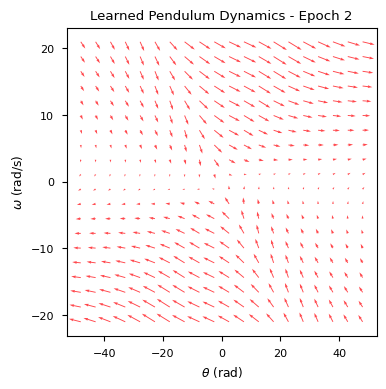

3: 2.726782740096725


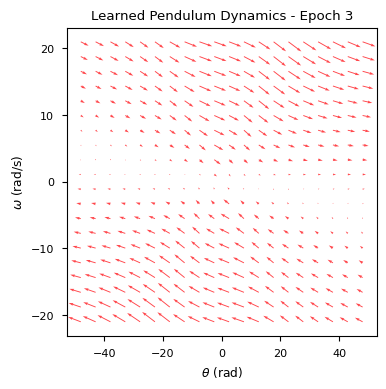

4: 2.7300805938134705


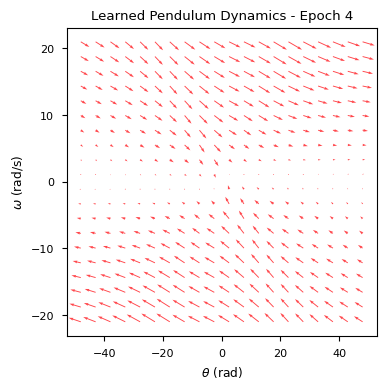

5: 2.796487684692983


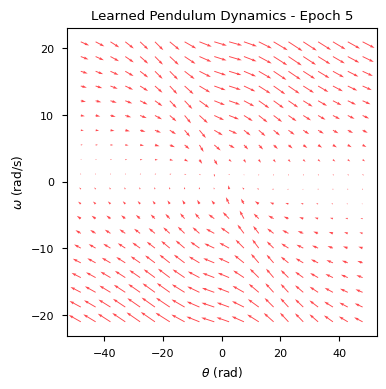

6: 2.751625864913803


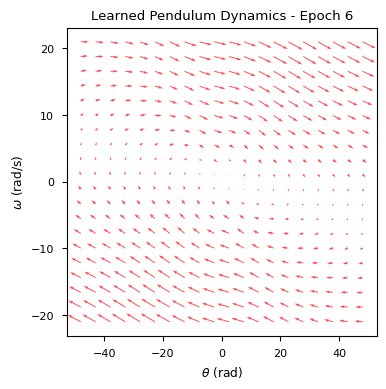

7: 2.7676570795799256


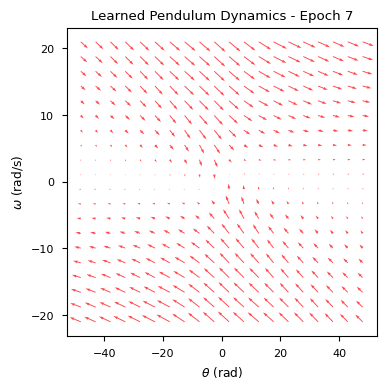

8: 2.764984075737595


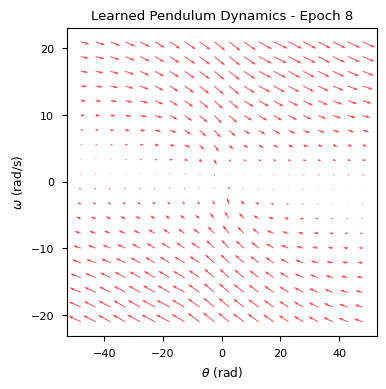

9: 2.691549969855776


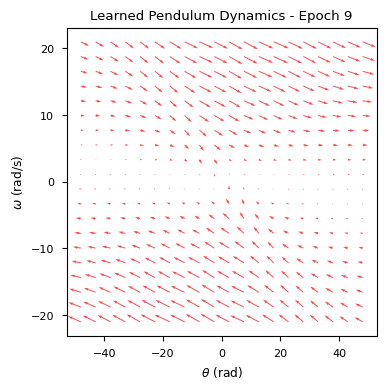

10: 2.677004587470062


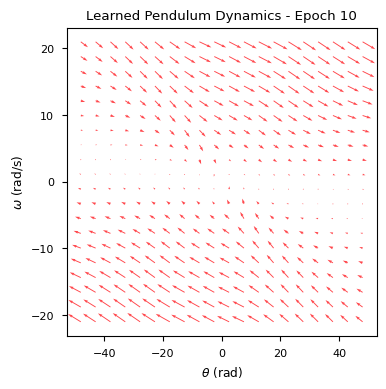

11: 2.634081890660726


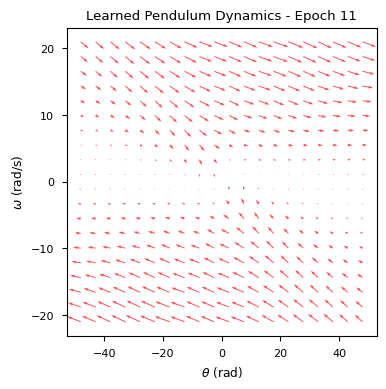

12: 2.607601128505764


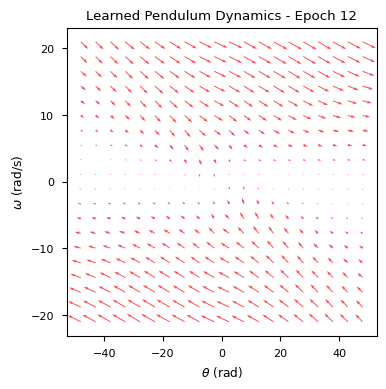

13: 2.780171288400941


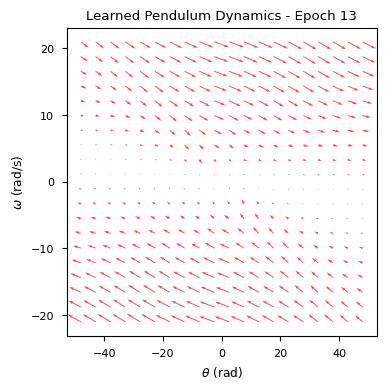

14: 2.646511139535372


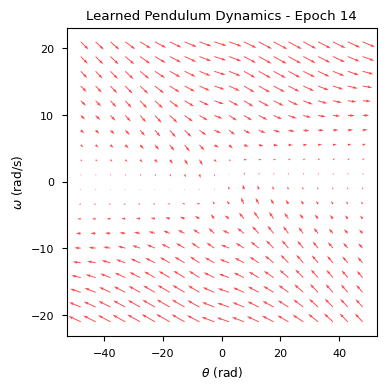

15: 2.7209023391674707


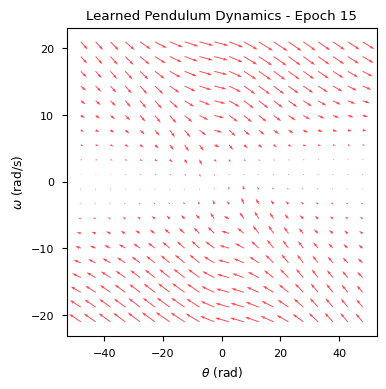

16: 2.7400728620219073


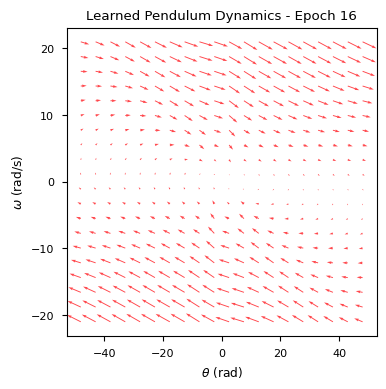

17: 2.6183098294855207


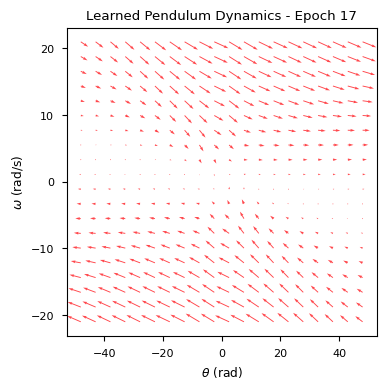

18: 2.670162609354199


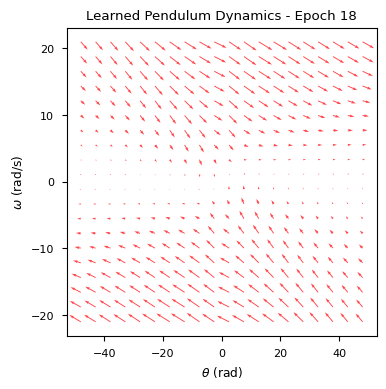

19: 2.6314916609311916


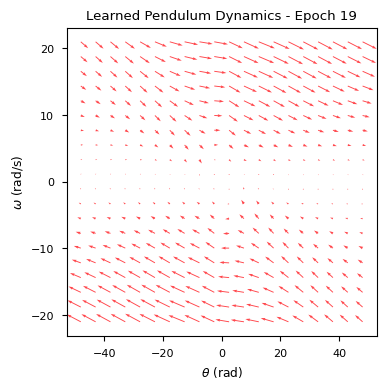

20: 2.631963100656246


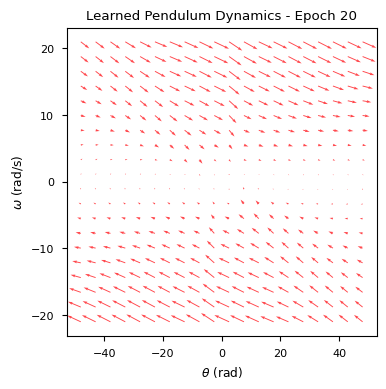

21: 2.646433941628763


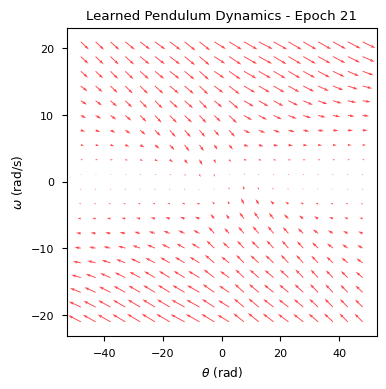

22: 2.6493012725707628


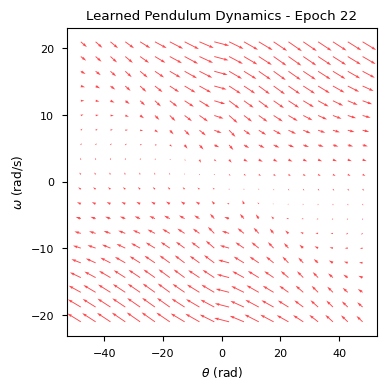

23: 2.5470528805992125


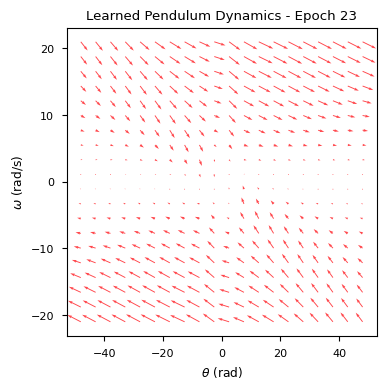

24: 2.695550974839691


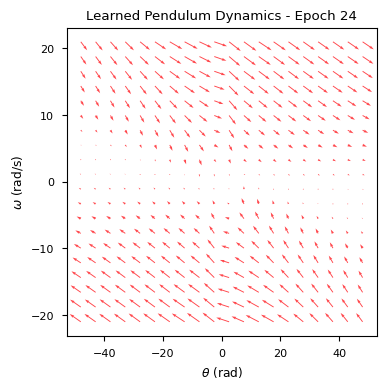

25: 2.5330578795190504


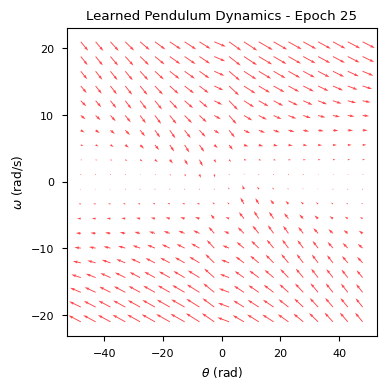

26: 2.578328495426869


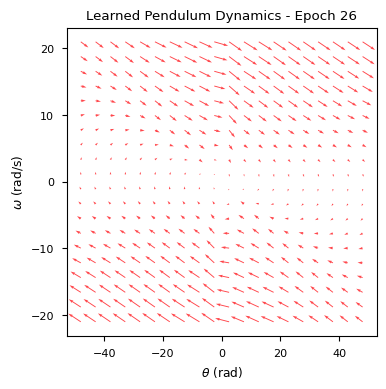

27: 2.598528994610864


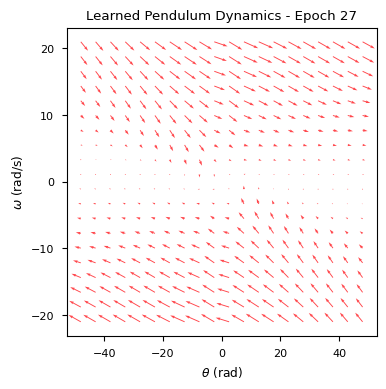

28: 2.6500670888796543


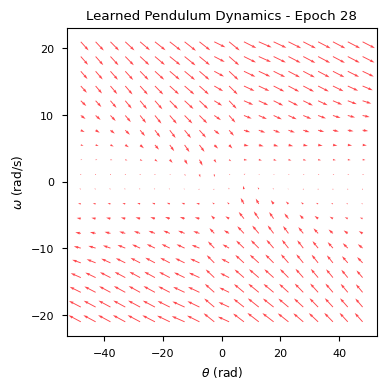

29: 2.625744932727181


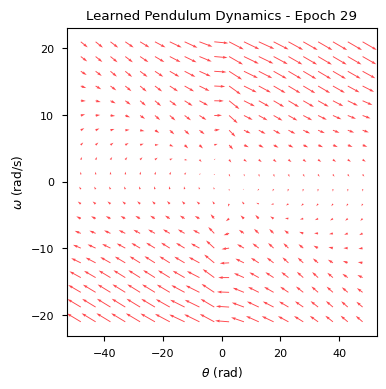

30: 2.551848391172183


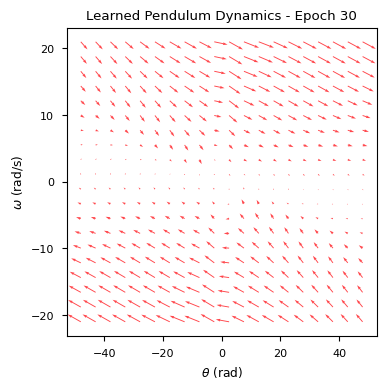

31: 2.626039411214639


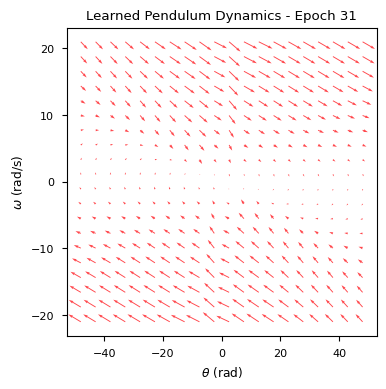

32: 2.5628172828484335


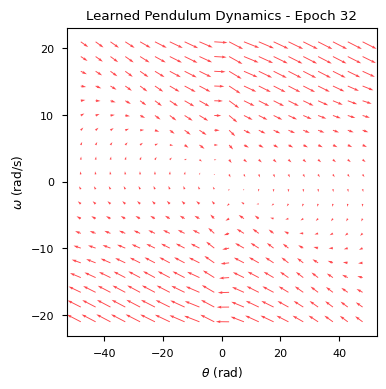

33: 2.647320815681278


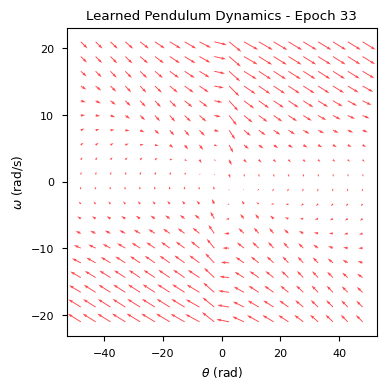

34: 2.57481640583158


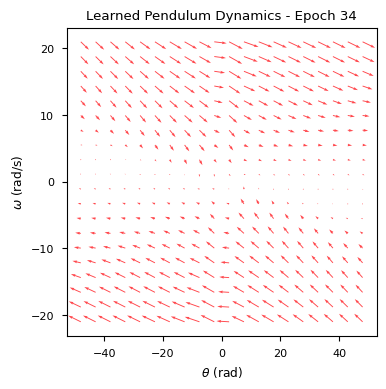

35: 2.540176740804797


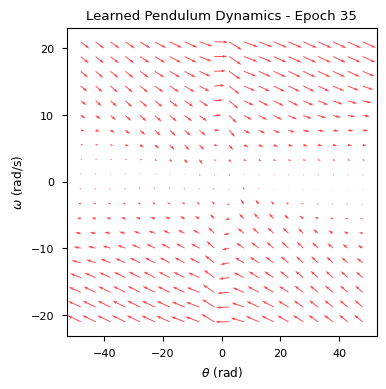

36: 2.5129025643340297


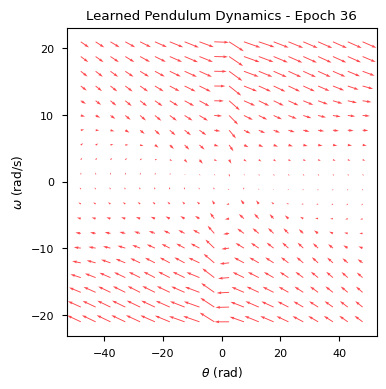

37: 2.559849055195928


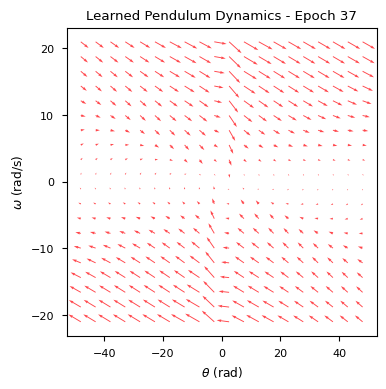

38: 2.55767272477491


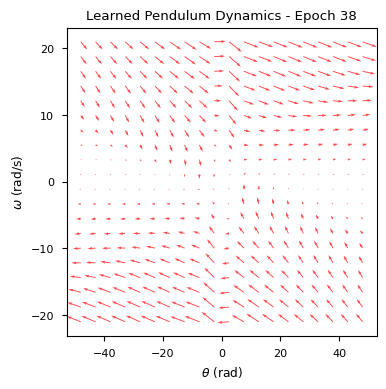

39: 2.5430869960696296


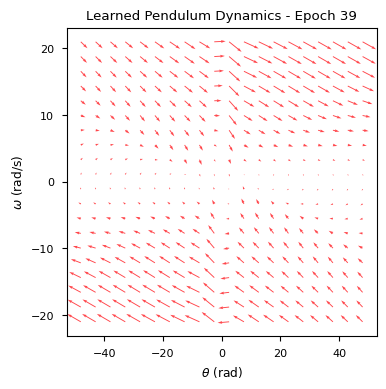

40: 2.5875498273948216


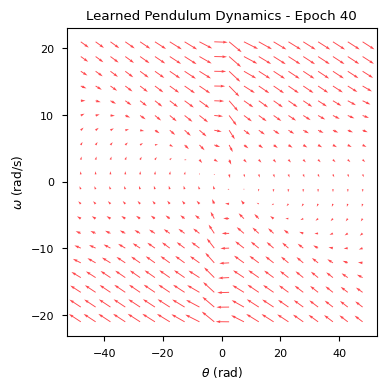

41: 2.5632282008519462


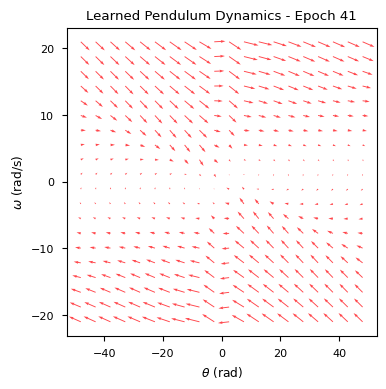

42: 2.535125958136815


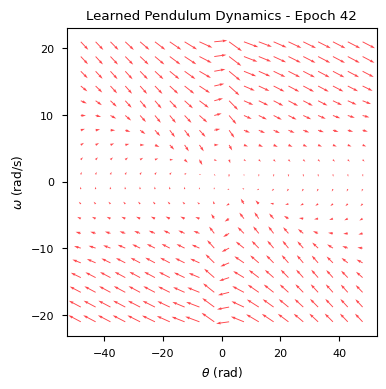

43: 2.5682518588925562


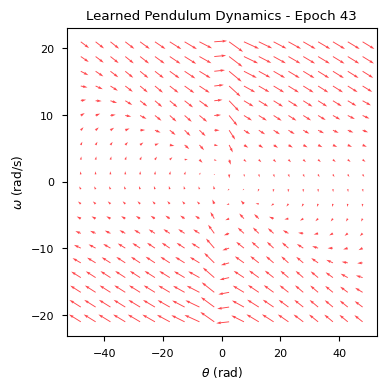

44: 2.5461431195498787


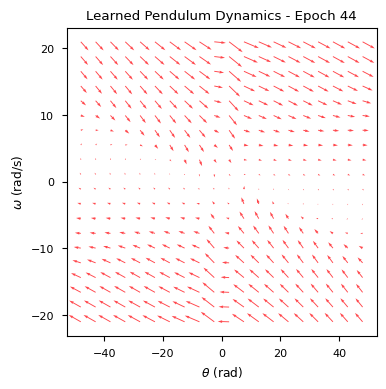

45: 2.492629240584157


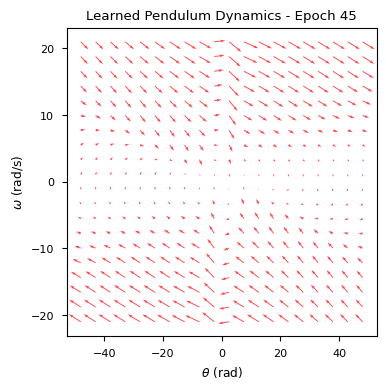

46: 2.475275687580875


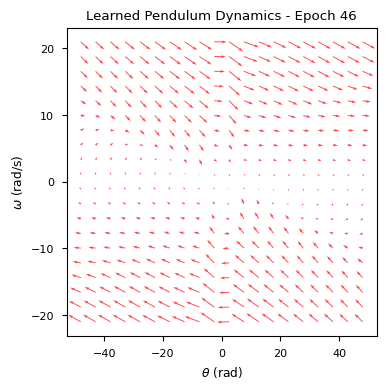

47: 2.5627172597061714


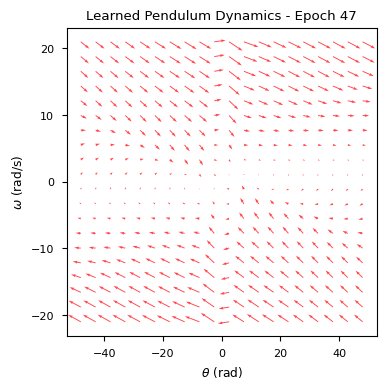

48: 2.477619101147422


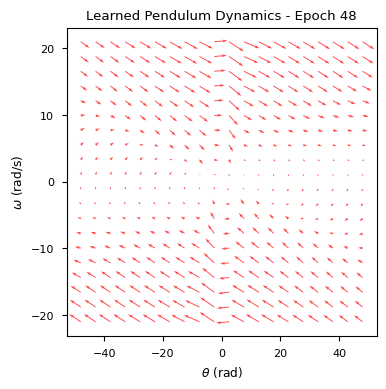

49: 2.4578710873519842


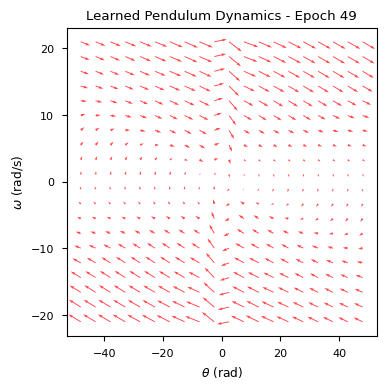

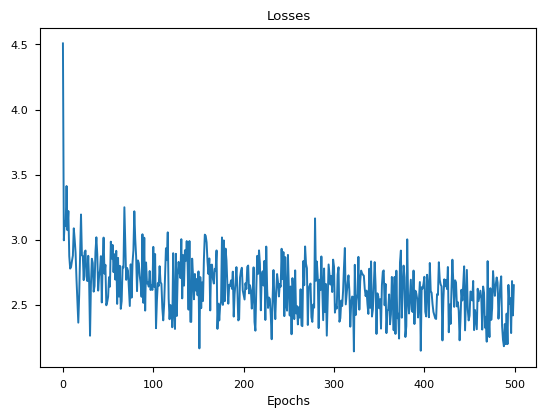

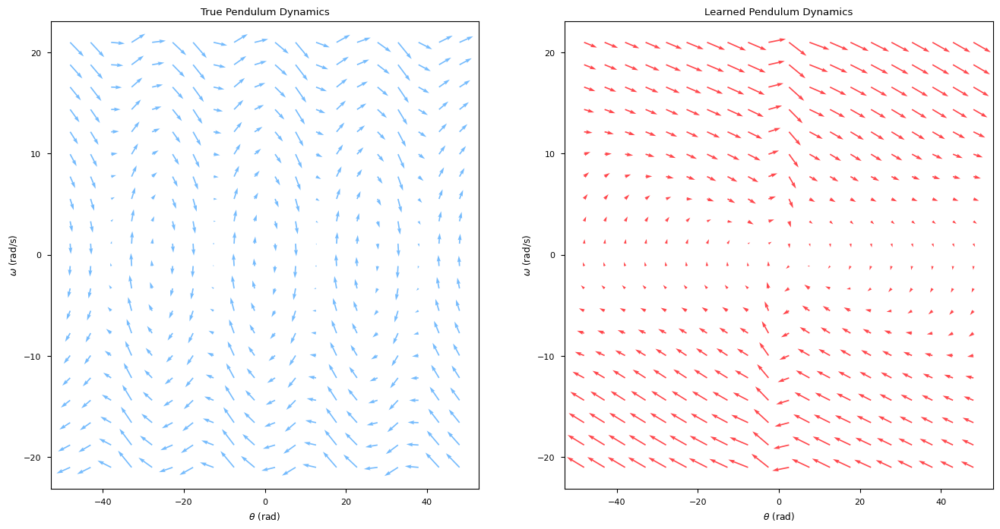

In [454]:
learning_ode_model = run_seq_experiment(
    traj_count=1000, batch_size=100, epochs=50, seq_len=10,
    lr=1e-3, activation='tanh', initializer=tf.keras.initializers.GlorotUniform(), layers=[256, 128, 32],
    adjoint=False, solver="rk4", solver_args=dict(h=tf.cast(1/16, dtype=tf.float64))
)